# GUC Clustering Project 

**Objective:** 
The objective of this project teach students how to apply clustering to real data sets

The projects aims to teach student: 
* Which clustering approach to use
* Compare between Kmeans, Hierarchal, DBScan, and Gaussian Mixtures  
* How to tune the parameters of each data approach
* What is the effect of different distance functions (optional) 
* How to evaluate clustering approachs 
* How to display the output
* What is the effect of normalizing the data 

Students in this project will use ready-made functions from Sklearn, plotnine, numpy and pandas 
 



In [1]:
# if plotnine is not installed in Jupter then use the following command to install it 

Running this project require the following imports 

In [2]:
import warnings
warnings.filterwarnings('ignore')
import seaborn as sns 
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import sklearn.preprocessing as prep
from sklearn.datasets import make_blobs
from plotnine import *
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn import datasets
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler,MinMaxScaler ,MaxAbsScaler
%matplotlib inline

In [3]:
# helper function that allows us to display data in 2 dimensions and highlights the clusters
def display_cluster(X,km=[],num_clusters=0):
    color = 'brgcmyk'  #List colors
    alpha = 0.5  #color obaque
    s = 20
    if num_clusters == 0:
        plt.scatter(X[:,0],X[:,1],c = color[0],alpha = alpha,s = s)
    else:
        for i in range(int(num_clusters)):
            plt.scatter(X[km.labels_==i,0],X[km.labels_==i,1],c = color[i],alpha = alpha,s=s)
            plt.scatter(km.cluster_centers_[i][0],km.cluster_centers_[i][1],c = color[i], marker = 'x', s = 100)

## Multi Blob Data Set 
* The Data Set generated below has 6 cluster with varying number of users and varing densities
* Cluster the data set below using 



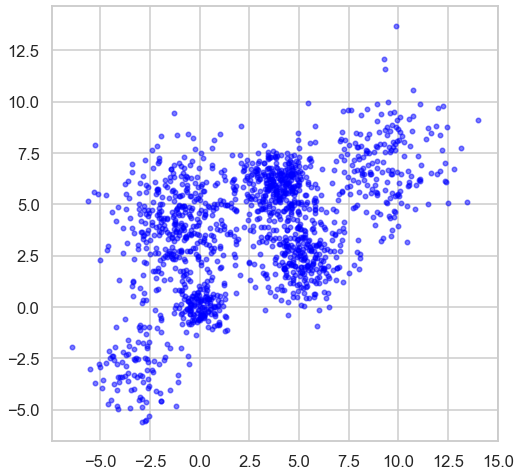

In [4]:
plt.rcParams['figure.figsize'] = [8,8]
sns.set_style("whitegrid")
sns.set_context("talk")

n_bins = 6  
centers = [(-3, -3), (0, 0), (5,2.5),(-1, 4), (4, 6), (9,7)]
Multi_blob_Data, y = make_blobs(n_samples=[100,150, 300, 400,300, 200], n_features=2, cluster_std=[1.3,0.6, 1.2, 1.7,0.9,1.7],
                  centers=centers, shuffle=False, random_state=42)
display_cluster(Multi_blob_Data)

### Kmeans 
* Use Kmeans with different values of K to cluster the above data 
* Display the outcome of each value of K 
* Plot distortion function versus K and choose the approriate value of k 
* Plot the silhouette_score versus K and use it to choose the best K 
* Store the silhouette_score for the best K for later comparison with other clustering techniques. 

In [5]:
def k_means(data):
    distortions = []
    silhouette_scores = []
    # using k values ranging from 2 to 6 to cluster the above data
    for k in range(2, 7):
        kmeans = KMeans(n_clusters=k, random_state=42)
        kmeans.fit(data)
        labels = kmeans.predict(data)
        distortions.append(kmeans.inertia_)
        display_cluster(data, kmeans, k)
        plt.title(f'KMeans Clustering (K={k})')
        # here we can see the kmeans clustering from 2 to 6
        plt.show()
        silhouette_scores.append(silhouette_score(data, kmeans.labels_))
    # here the elbow method with the best k plotted
    plt.plot(range(2, 7), distortions, 'bo-')
    plt.xlabel('Number of Clusters (K)')
    plt.ylabel('Distortion')
    plt.title('Best K using Elbow method')
    plt.show()
    # here the silhouette method with the best k plotted
    plt.plot(range(2, 7), silhouette_scores, 'bo-')
    plt.xlabel('Number of Clusters (K)')
    plt.ylabel('Silhouette Score')
    plt.title('Best K using Silhouette method')
    plt.show()
    # Store the silhouette_score for the best K
    best_k = np.argmax(silhouette_scores) + 2
    print(f"Best value of K: {best_k}")
    return best_k

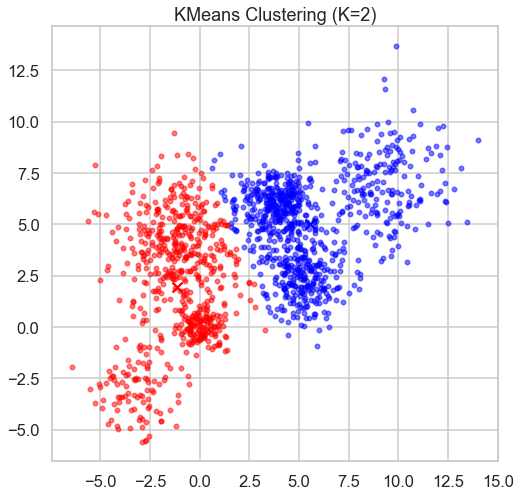

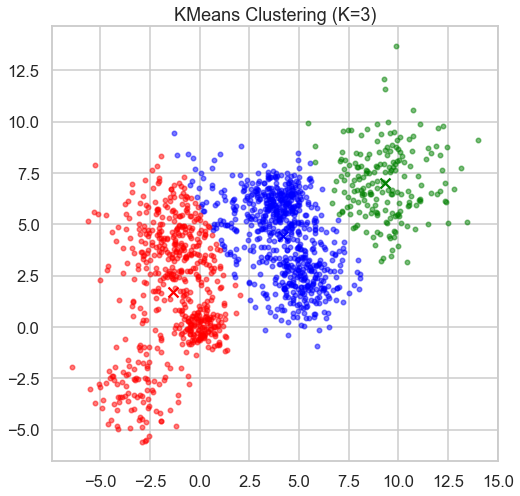

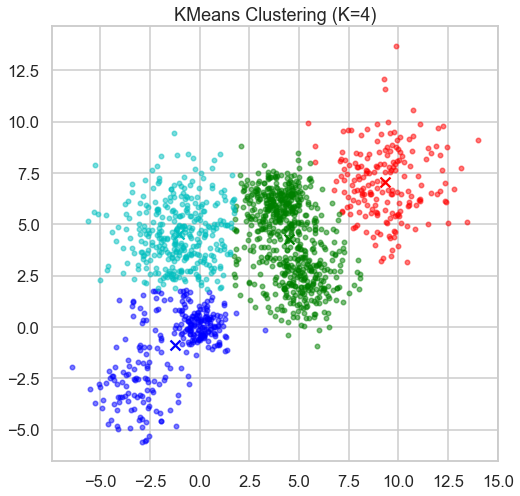

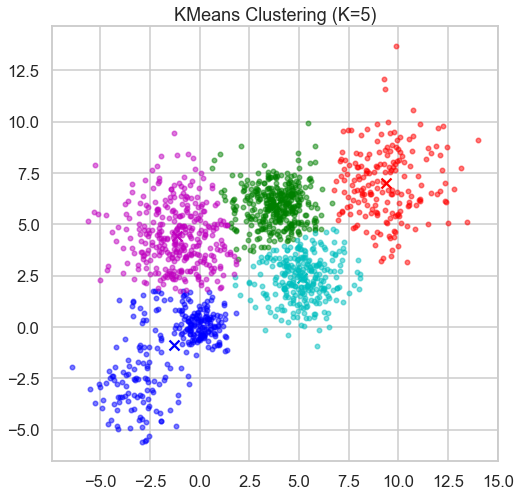

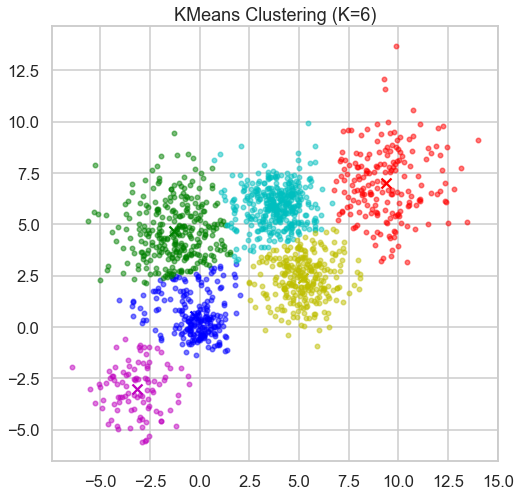

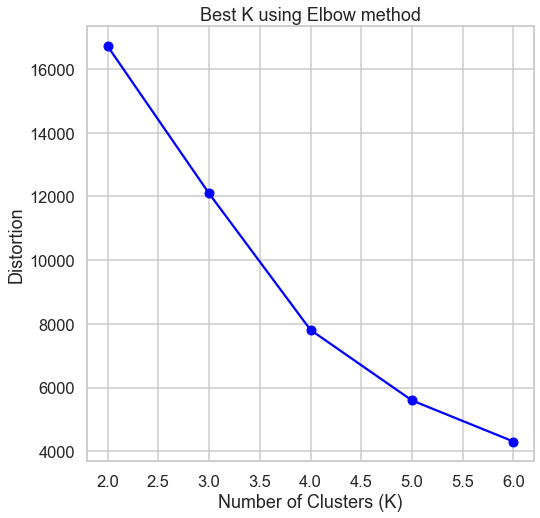

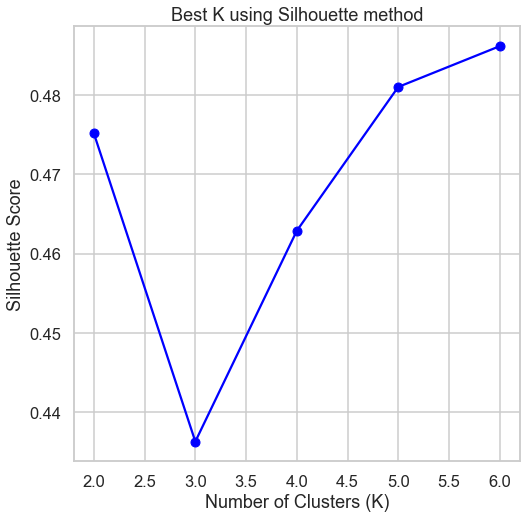

Best value of K: 6


6

In [6]:
k_means(Multi_blob_Data)

### Hierarchal Clustering
* Use AgglomerativeClustering function to  to cluster the above data 
* In the  AgglomerativeClustering change the following parameters 
    * Affinity (use euclidean, manhattan and cosine)
    * Linkage( use average and single )
    * Distance_threshold (try different)
* For each of these trials plot the Dendograph , calculate the silhouette_score and display the resulting clusters  
* Find the set of paramters that would find result in the best silhouette_score and store this score for later comparison with other clustering techniques. 
* Record your observation 

In [7]:
# Set the parameter values for Agglomerative Clustering
affinities = ['euclidean','cityblock','cosine']
linkages = ['average', 'single']
dist_thresholds = [None, 1, 2, 3]

def agglomerative_clustering(data, affinities, linkages, dist_thresholds):
    # Store the best silhouette score and the corresponding parameter values
    best_silhouette_score = -1
    best_affinity = ''
    best_linkage = ''
    best_dist_threshold = 0

    # Iterate over different parameter values and perform Agglomerative Clustering
    for affinity in affinities:
        for linkage_method in linkages:
            for dist_threshold in dist_thresholds:
                # Perform Agglomerative Clustering
                if dist_threshold is not None:
                    model = AgglomerativeClustering(n_clusters=None, linkage=linkage_method, affinity=affinity, distance_threshold=dist_threshold)
                else:
                    model = AgglomerativeClustering(n_clusters=6, linkage=linkage_method, affinity=affinity)
                hierarchal = model.fit_predict(data)

                if len(np.unique(hierarchal)) > 1:
                    silhouette_avg = silhouette_score(data, hierarchal)
                    print(f"Affinity: {affinity}, Linkage: {linkage_method}, Distance Threshold: {dist_threshold}, Silhouette Score: {silhouette_avg:.2f}")
                else:
                    print(f"Affinity: {affinity}, Linkage: {linkage_method}, Distance Threshold: {dist_threshold}, Silhouette Score cannot be computed with only one label.")

                # Store the best silhouette score and the corresponding parameter values
                if silhouette_avg > best_silhouette_score:
                    best_silhouette_score = silhouette_avg
                    best_affinity = affinity
                    best_linkage = linkage_method
                    best_dist_threshold = dist_threshold

                # Plot the dendrogram
                plt.figure(figsize=(10, 7))
                dendrogram(linkage(data, method=linkage_method, metric=affinity))
                plt.title(f"Affinity: {affinity}, Linkage: {linkage_method}, Distance Threshold: {dist_threshold}")
                plt.show()

                # Display the resulting clusters
                plt.figure(figsize=(10, 7))
                plt.scatter(data[:, 0], data[:, 1], c=hierarchal, cmap='viridis')
                plt.title(f"Affinity: {affinity}, Linkage: {linkage_method}, Distance Threshold: {dist_threshold}")
                plt.show()

    # Print the best silhouette score and the corresponding parameter values
    print(f"Best Silhouette Score: {best_silhouette_score:.2f}")
    print(f"Best Affinity: {best_affinity}")
    print(f"Best Linkage: {best_linkage}")
    print(f"Best Distance Threshold: {best_dist_threshold}")



Affinity: euclidean, Linkage: average, Distance Threshold: None, Silhouette Score: 0.41


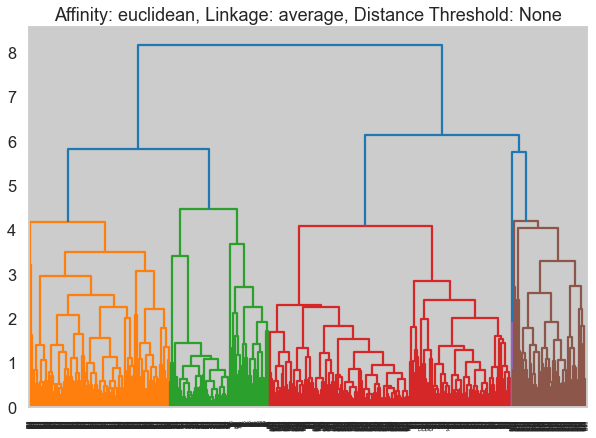

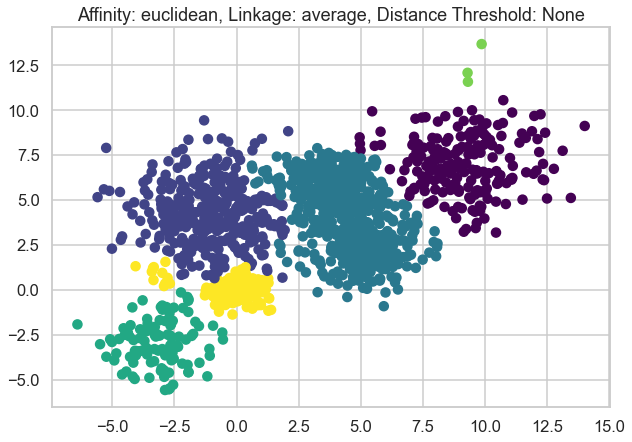

Affinity: euclidean, Linkage: average, Distance Threshold: 1, Silhouette Score: 0.32


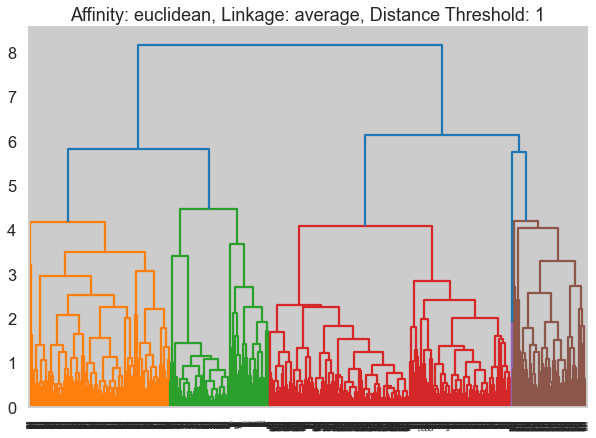

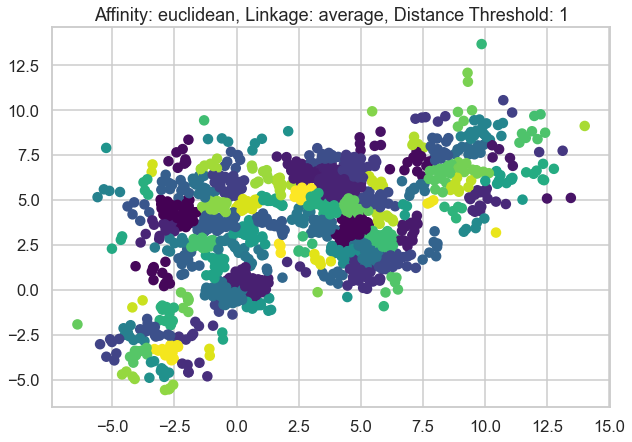

Affinity: euclidean, Linkage: average, Distance Threshold: 2, Silhouette Score: 0.32


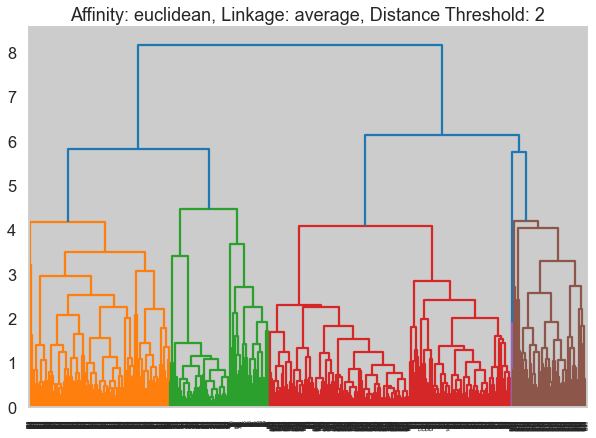

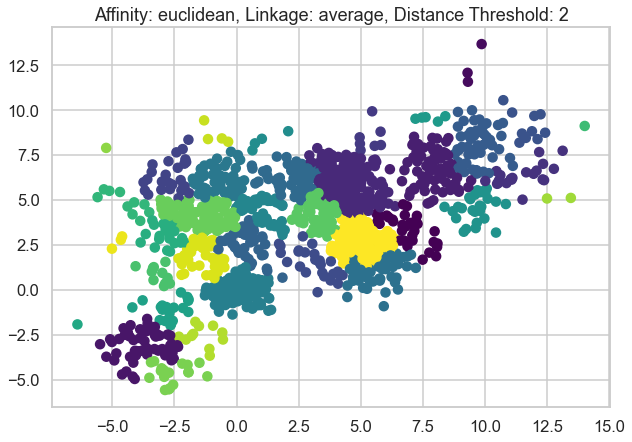

Affinity: euclidean, Linkage: average, Distance Threshold: 3, Silhouette Score: 0.36


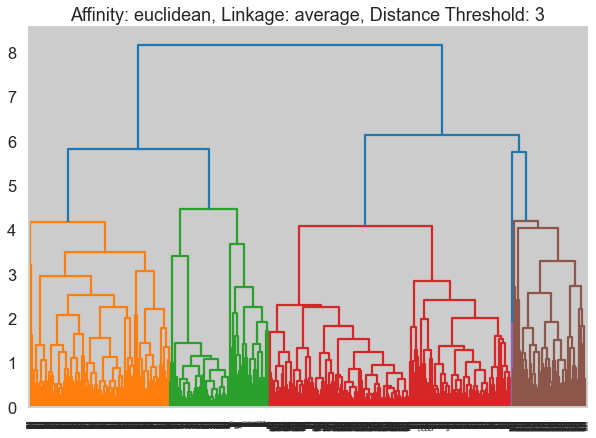

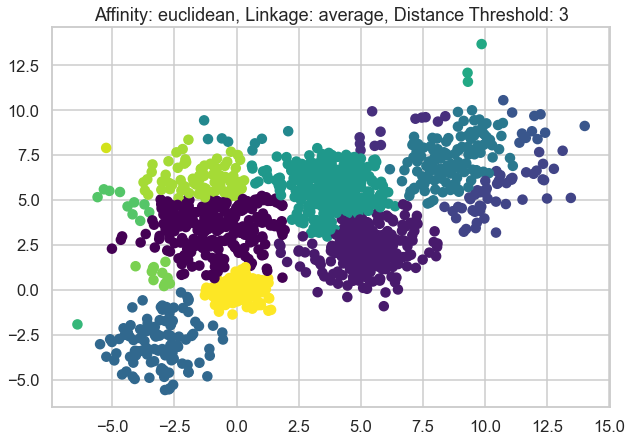

Affinity: euclidean, Linkage: single, Distance Threshold: None, Silhouette Score: 0.09


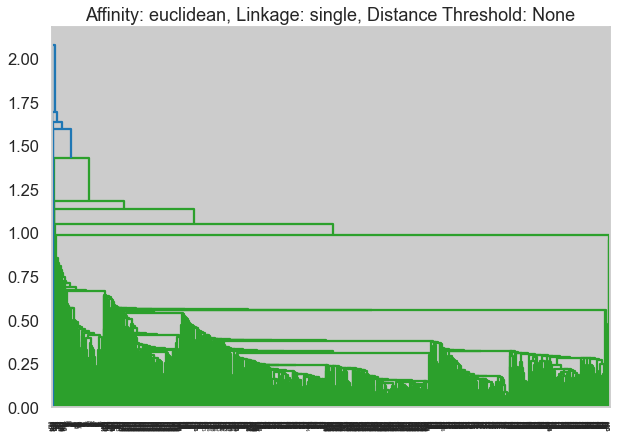

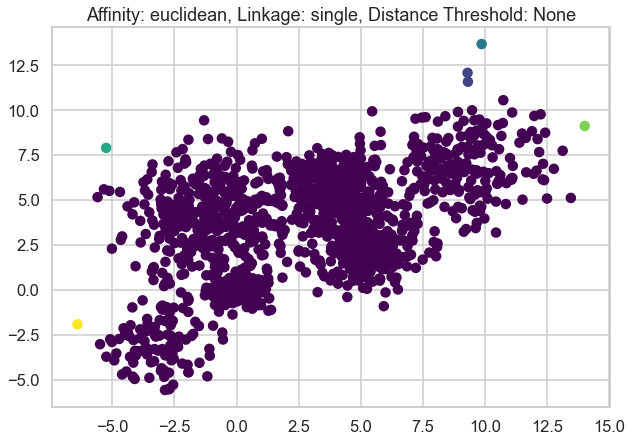

Affinity: euclidean, Linkage: single, Distance Threshold: 1, Silhouette Score: -0.15


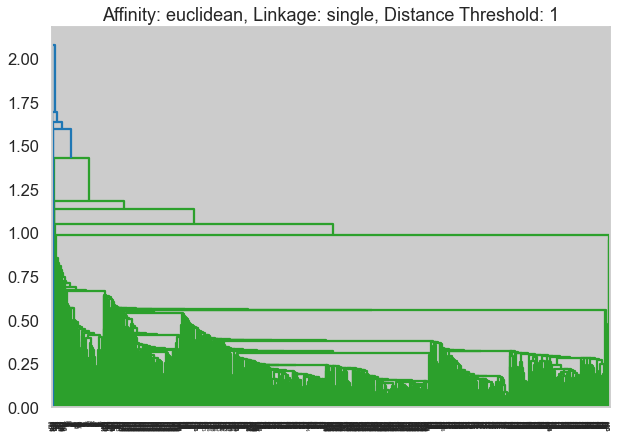

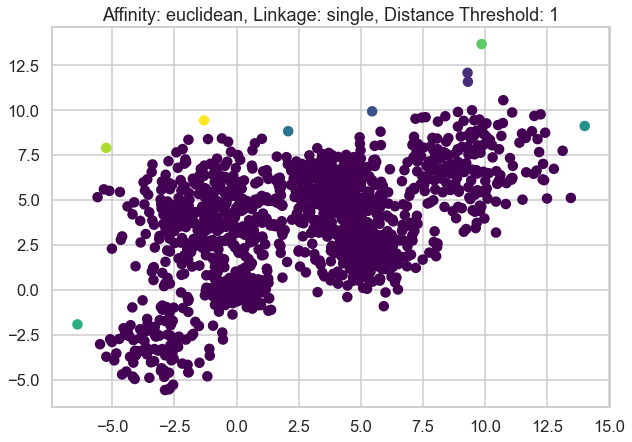

Affinity: euclidean, Linkage: single, Distance Threshold: 2, Silhouette Score: 0.32


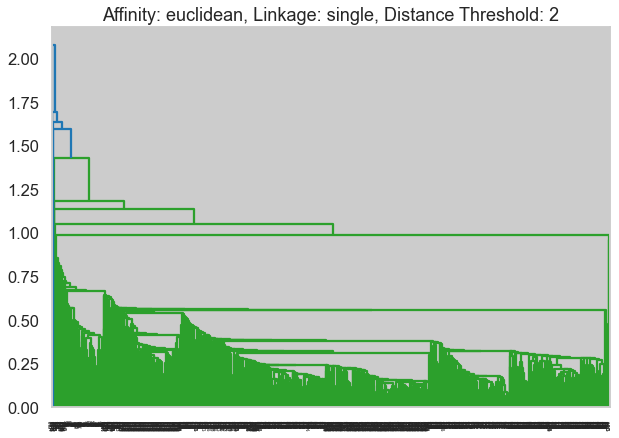

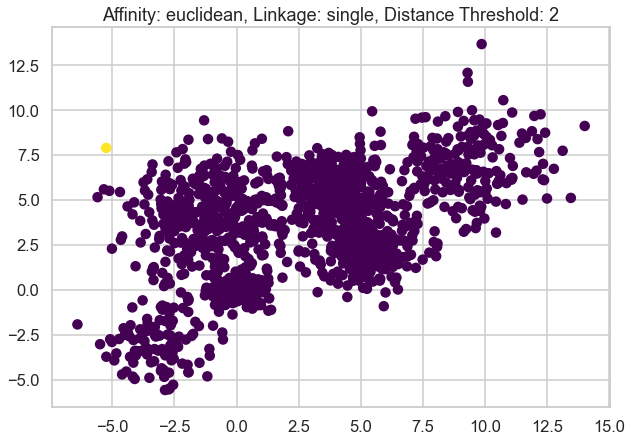

Affinity: euclidean, Linkage: single, Distance Threshold: 3, Silhouette Score cannot be computed with only one label.


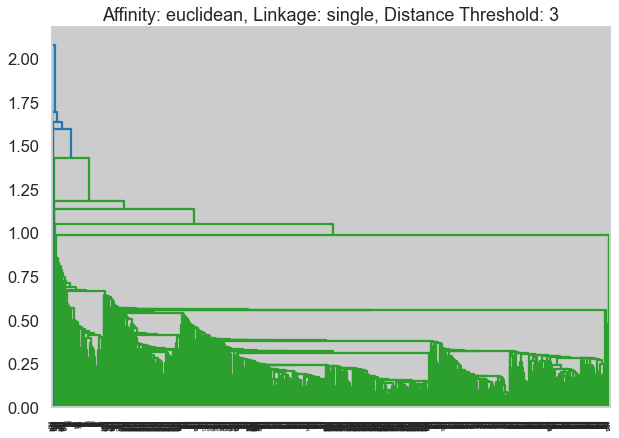

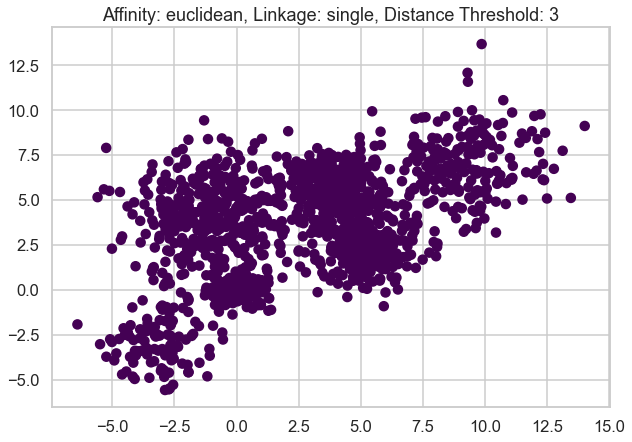

Affinity: cityblock, Linkage: average, Distance Threshold: None, Silhouette Score: 0.38


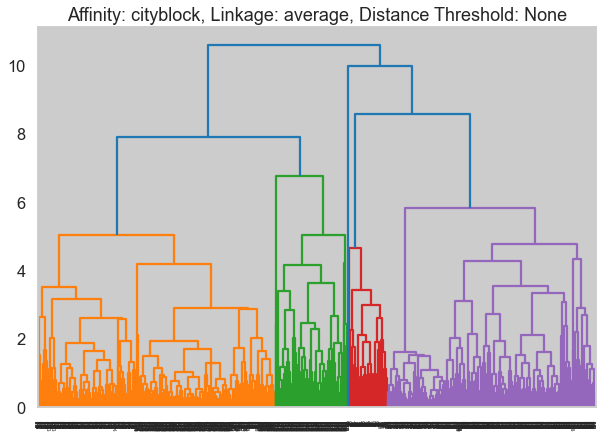

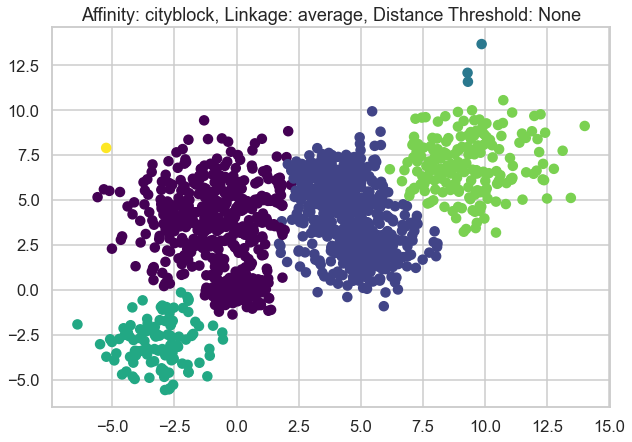

Affinity: cityblock, Linkage: average, Distance Threshold: 1, Silhouette Score: 0.34


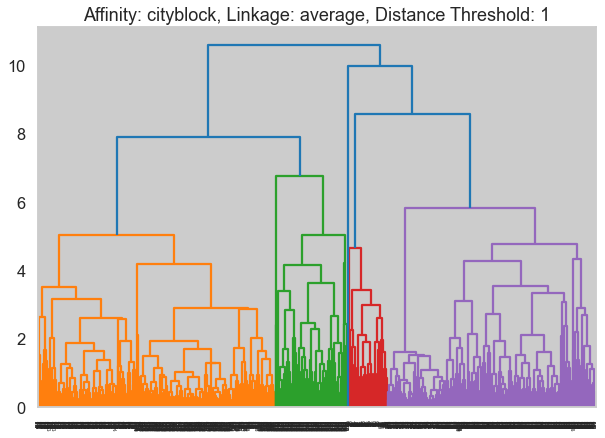

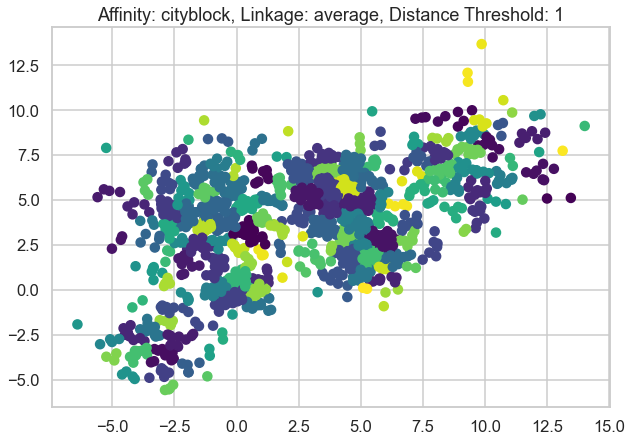

Affinity: cityblock, Linkage: average, Distance Threshold: 2, Silhouette Score: 0.28


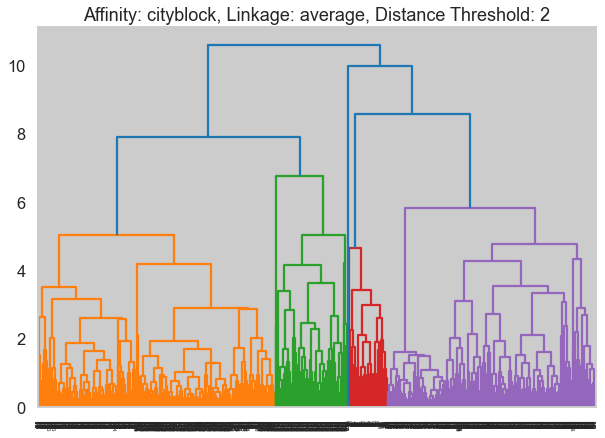

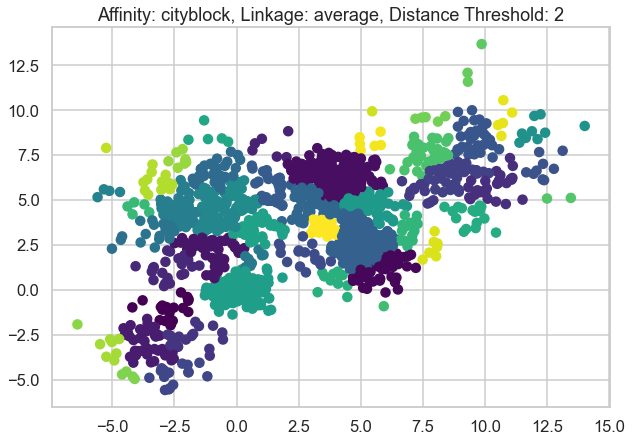

Affinity: cityblock, Linkage: average, Distance Threshold: 3, Silhouette Score: 0.30


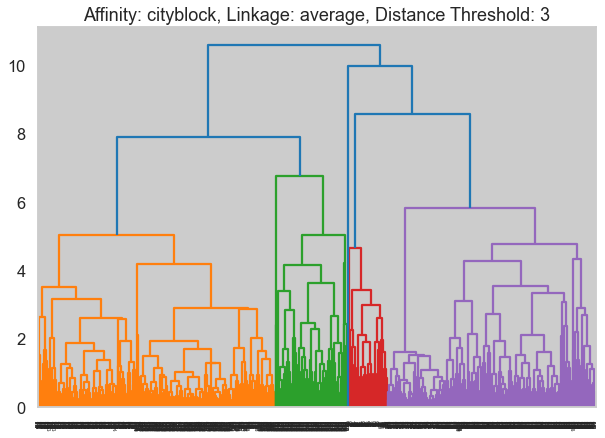

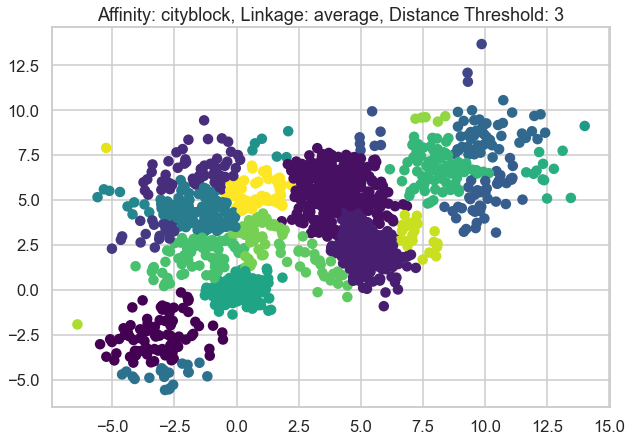

Affinity: cityblock, Linkage: single, Distance Threshold: None, Silhouette Score: 0.09


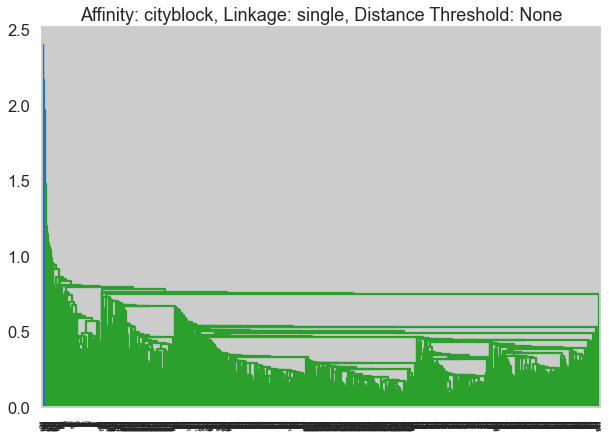

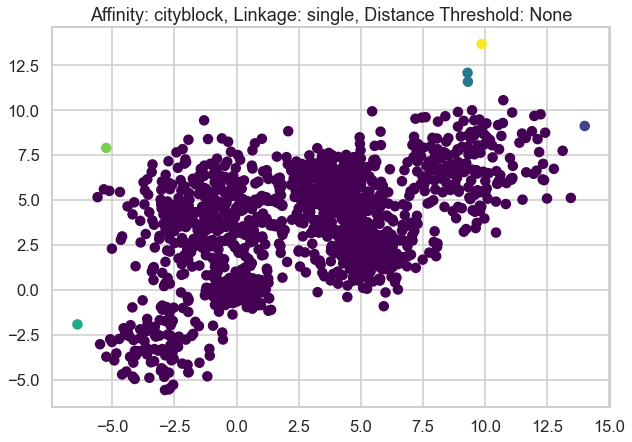

Affinity: cityblock, Linkage: single, Distance Threshold: 1, Silhouette Score: -0.41


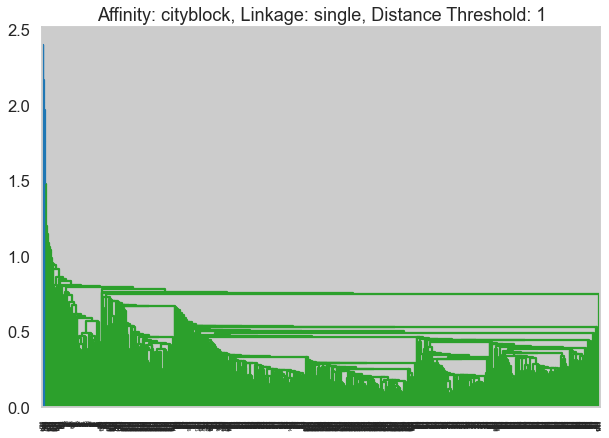

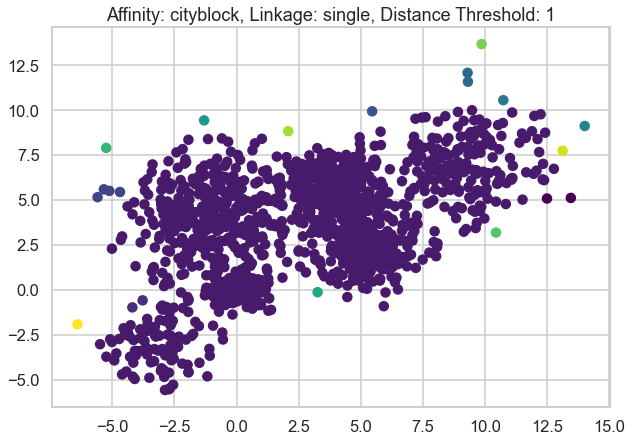

Affinity: cityblock, Linkage: single, Distance Threshold: 2, Silhouette Score: 0.15


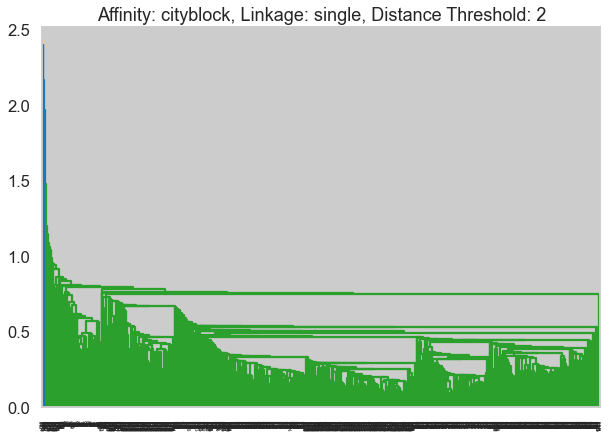

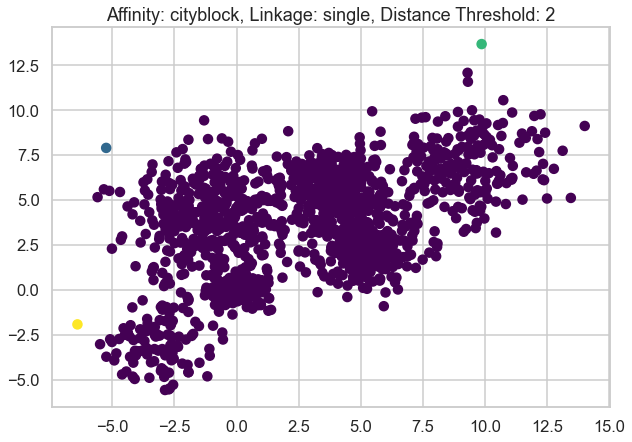

Affinity: cityblock, Linkage: single, Distance Threshold: 3, Silhouette Score cannot be computed with only one label.


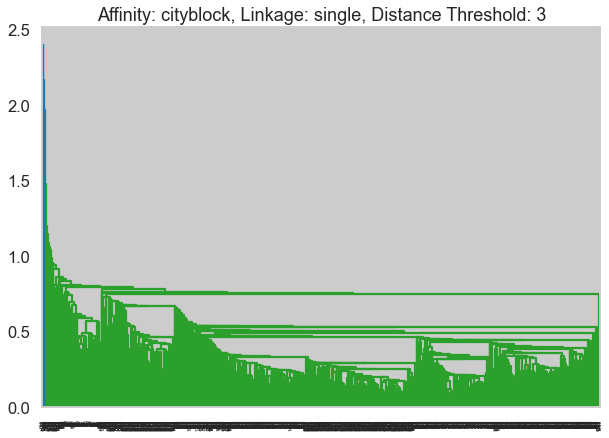

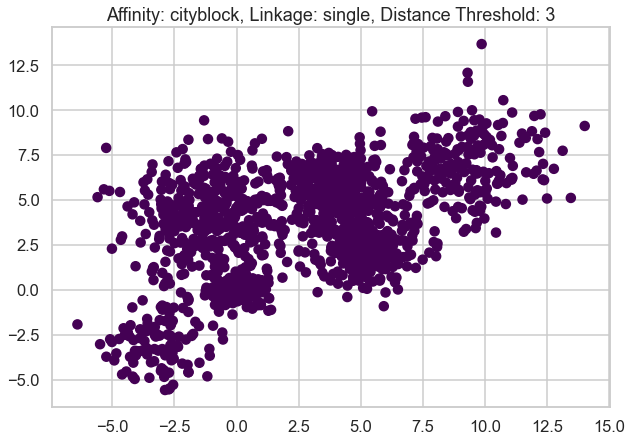

Affinity: cosine, Linkage: average, Distance Threshold: None, Silhouette Score: 0.20


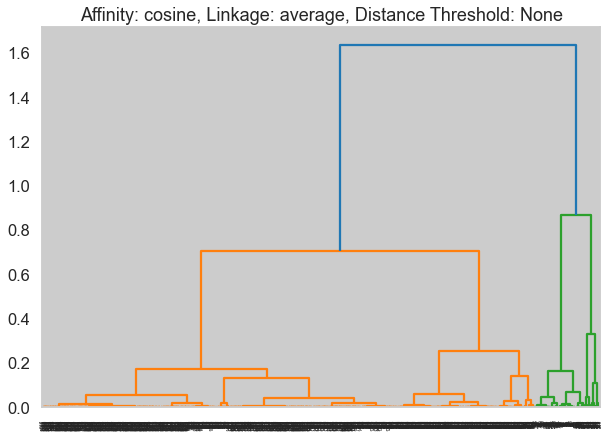

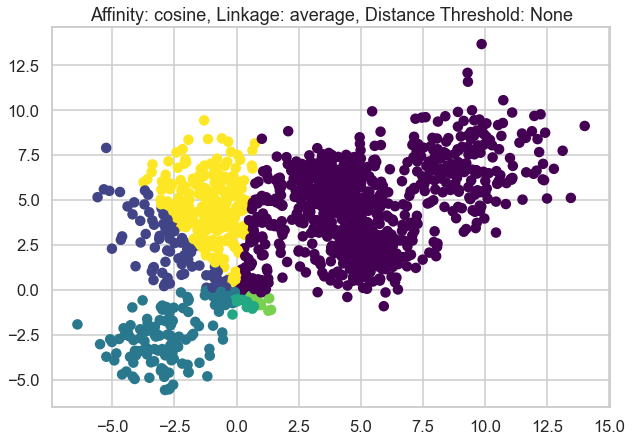

Affinity: cosine, Linkage: average, Distance Threshold: 1, Silhouette Score: 0.35


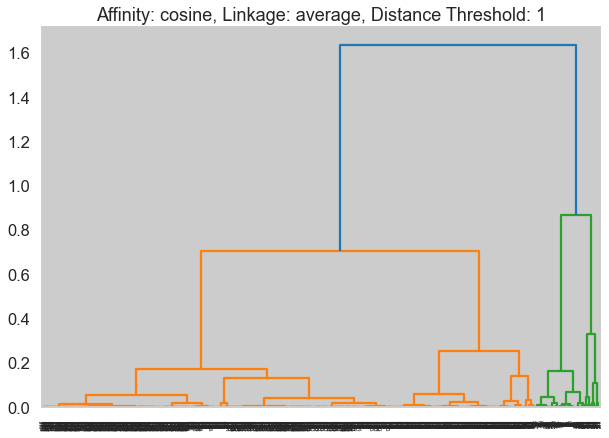

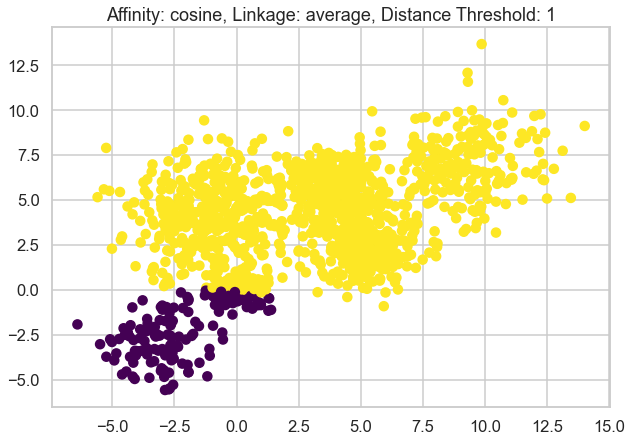

Affinity: cosine, Linkage: average, Distance Threshold: 2, Silhouette Score cannot be computed with only one label.


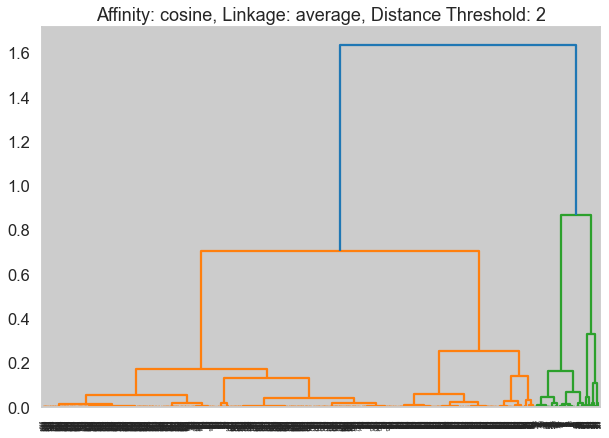

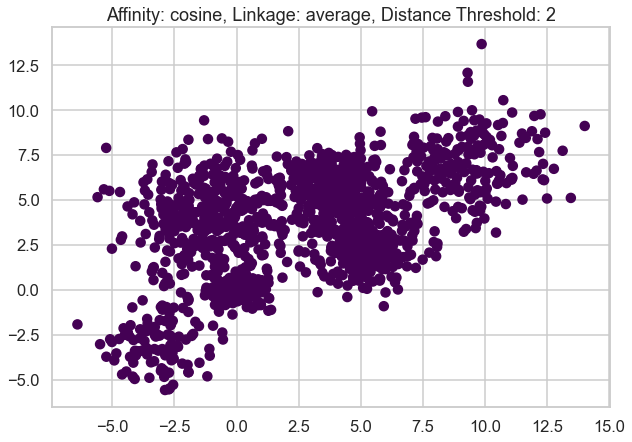

Affinity: cosine, Linkage: average, Distance Threshold: 3, Silhouette Score cannot be computed with only one label.


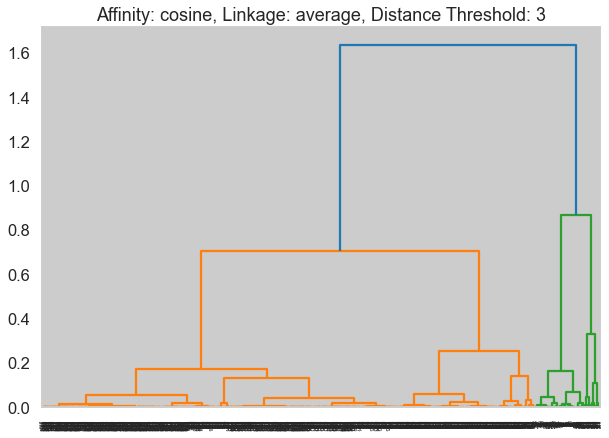

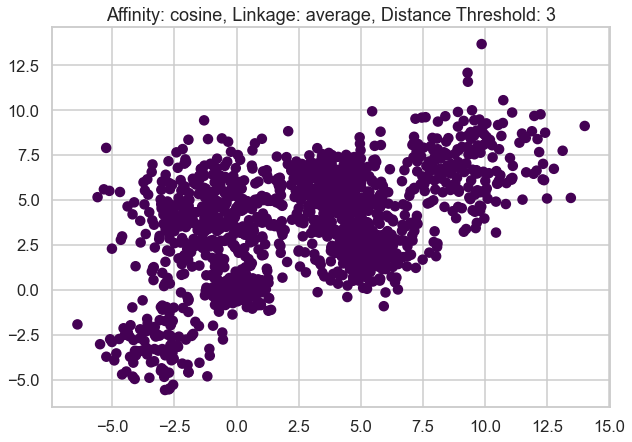

Affinity: cosine, Linkage: single, Distance Threshold: None, Silhouette Score: 0.07


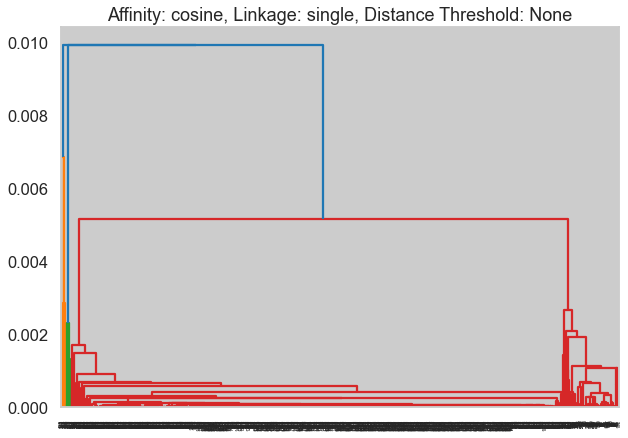

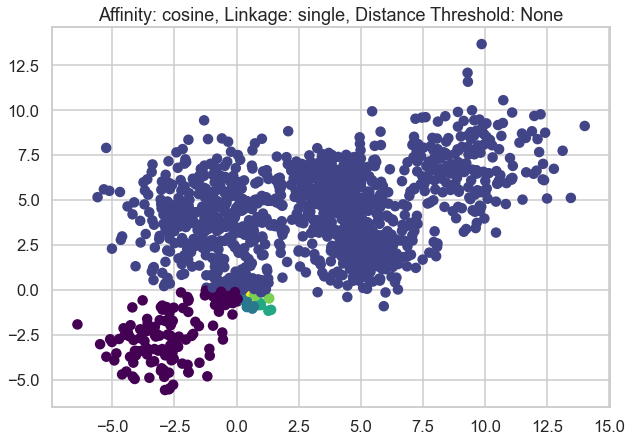

Affinity: cosine, Linkage: single, Distance Threshold: 1, Silhouette Score cannot be computed with only one label.


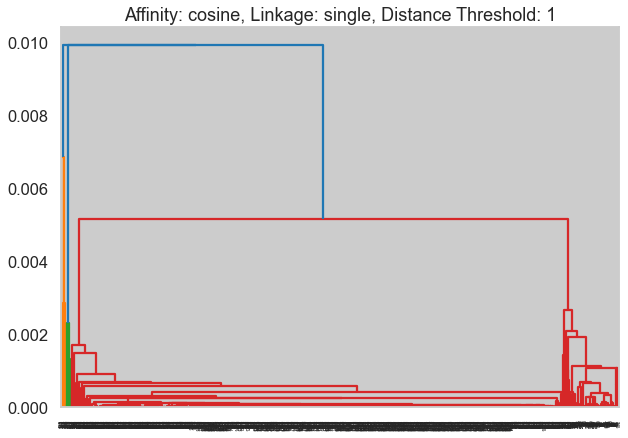

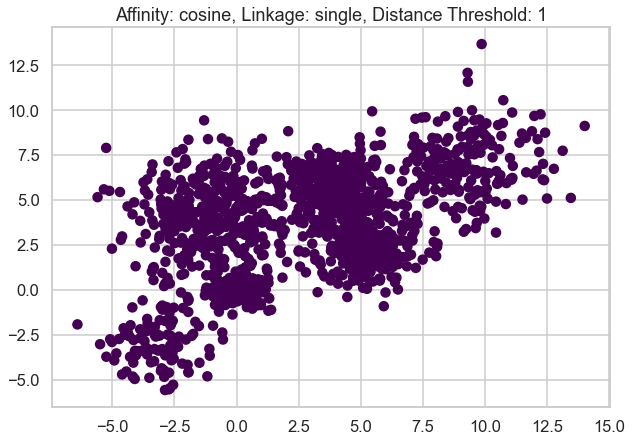

Affinity: cosine, Linkage: single, Distance Threshold: 2, Silhouette Score cannot be computed with only one label.


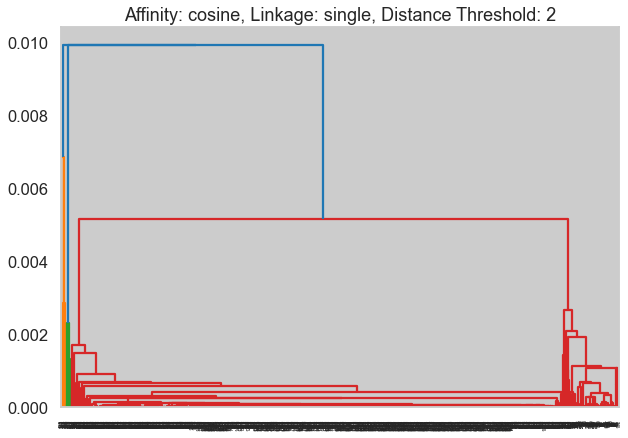

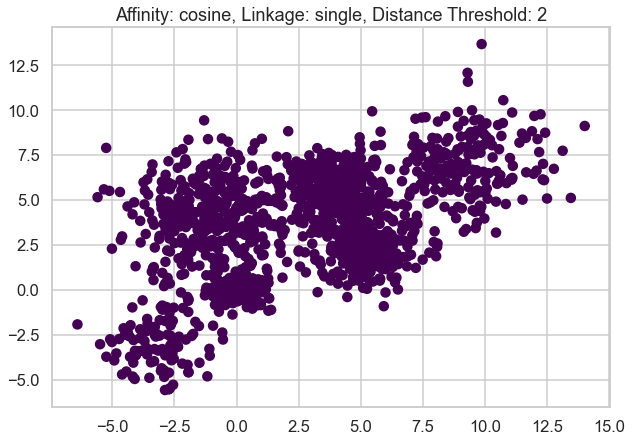

Affinity: cosine, Linkage: single, Distance Threshold: 3, Silhouette Score cannot be computed with only one label.


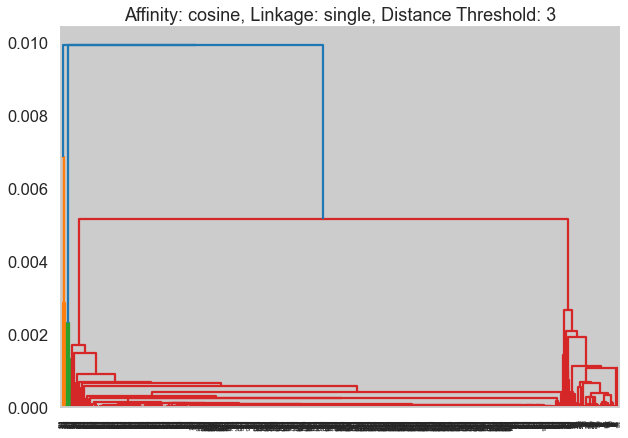

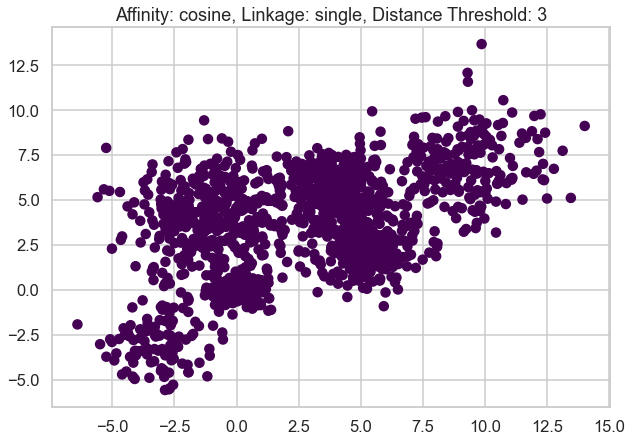

Best Silhouette Score: 0.41
Best Affinity: euclidean
Best Linkage: average
Best Distance Threshold: None


In [8]:
agglomerative_clustering(Multi_blob_Data, affinities, linkages, dist_thresholds)

### DBScan
* Use DBScan function to  to cluster the above data 
* In the  DBscan change the following parameters 
    * EPS (from 0.1 to 3)
    * Min_samples (from 5 to 25)
* Plot the silhouette_score versus the variation in the EPS and the min_samples
* Plot the resulting Clusters in this case 
* Find the set of paramters that would find result in the best silhouette_score and store this score for later comparison with other clustering techniques. 
* Record your observations and comments 

In [9]:
def dbscan_clustering(data):
    eps_range = np.linspace(0.1, 3, 30)
    min_samples_range = np.arange(5, 26, 5)
    best_silhouette_score = -1

    for eps in eps_range:
        for min_samples in min_samples_range:
            dbscan = DBSCAN(eps=eps, min_samples=min_samples)
            cluster_labels = dbscan.fit_predict(data)
            if len(set(cluster_labels)) > 1:
                silhouette_avg = silhouette_score(data, cluster_labels)
                # finding result in the best silhouette_score
                if silhouette_avg > best_silhouette_score:
                    best_silhouette_score = silhouette_avg
                    best_eps = eps
                    best_min_samples = min_samples
                title = f"DBSCAN Clustering (eps={eps:.2f}, min_samples={min_samples}), Silhouette Score: {silhouette_avg:.2f}"
                display_cluster(data, cluster_labels)

    print(f"Best Silhouette Score: {best_silhouette_score:.2f}, eps={best_eps:.2f}, min_samples={best_min_samples}")


Best Silhouette Score: 0.47, eps=2.10, min_samples=10


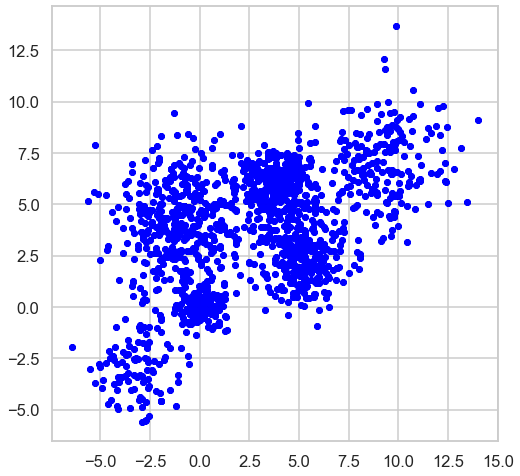

In [10]:
dbscan_clustering(Multi_blob_Data)

### Gaussian Mixture
* Use GaussianMixture function to cluster the above data 
* In GMM change the covariance_type and check the difference in the resulting proabability fit 
* Use a 2D contour plot to plot the resulting distribution (the components of the GMM) as well as the total Gaussian mixture 

In [11]:
def plot_gmm_clusters(data, n_clusters=6, covariance_types=('full', 'tied', 'diag', 'spherical'), random_state=42):
    # Reduce the dimensionality of the data using PCA
    pca = PCA(n_components=2, random_state=random_state)
    reduced_data = pca.fit_transform(data)

    fig, axes = plt.subplots(2, 2, figsize=(12, 12))
    axes = axes.ravel()
    for i, cov_type in enumerate(covariance_types):
        gmm = GaussianMixture(n_components=n_clusters, covariance_type=cov_type, random_state=random_state)
        gmm.fit(reduced_data)
        labels = gmm.predict(reduced_data)
        sns.scatterplot(x=reduced_data[:, 0], y=reduced_data[:, 1], hue=labels, ax=axes[i])
        sns.kdeplot(x=reduced_data[:, 0], y=reduced_data[:, 1], levels=5, color='w', linewidths=1.5, ax=axes[i])
        axes[i].set_title('Covariance Type: {}'.format(cov_type))
    plt.tight_layout()
    plt.show()

    gmm = GaussianMixture(n_components=n_clusters, covariance_type='full', random_state=random_state)
    gmm.fit(reduced_data)

    x_range = np.linspace(-10, 15, 500)
    y_range = np.linspace(-10, 15, 500)
    X, Y = np.meshgrid(x_range, y_range)
    XX = np.array([X.ravel(), Y.ravel()]).T
    Z = -gmm.score_samples(XX)
    Z = Z.reshape(X.shape)

    plt.figure(figsize=(10, 8))
    plt.scatter(reduced_data[:, 0], reduced_data[:, 1], s=5, alpha=0.5)
    plt.contour(X, Y, Z, levels=np.logspace(-3, 2, 10))
    plt.title('Gaussian Mixture Model')
    plt.xlabel('Component 1')
    plt.ylabel('Component 2')
    plt.show()


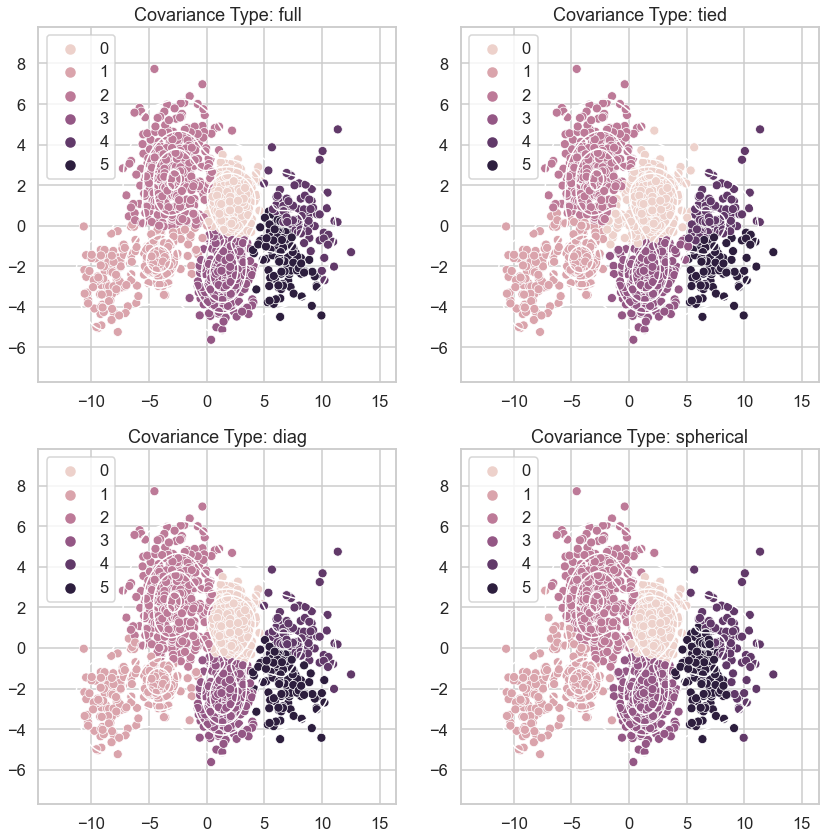

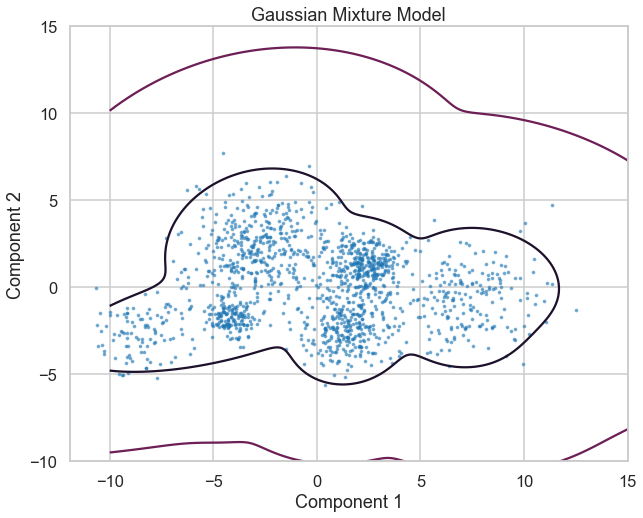

In [12]:
plot_gmm_clusters(Multi_blob_Data, n_clusters=6, covariance_types=('full', 'tied', 'diag', 'spherical'), random_state=42)

## iris data set 
The iris data set is test data set that is part of the Sklearn module 
which contains 150 records each with 4 features. All the features are represented by real numbers 

The data represents three classes 


In [13]:
from sklearn.datasets import load_iris
iris_data = load_iris()
iris_data.target[[10, 25, 50]]
#array([0, 0, 1])
list(iris_data.target_names)
['setosa', 'versicolor', 'virginica']


['setosa', 'versicolor', 'virginica']

* Repeat all the above clustering approaches and steps on the above data 
* Normalize the data then repeat all the above steps 
* Compare between the different clustering approaches 

In [14]:
# Load Iris dataset
iris = datasets.load_iris()

In [15]:
# Normalize the features using MinMaxScaler
scaler = MinMaxScaler()
normalized_iris= scaler.fit_transform(iris.data)

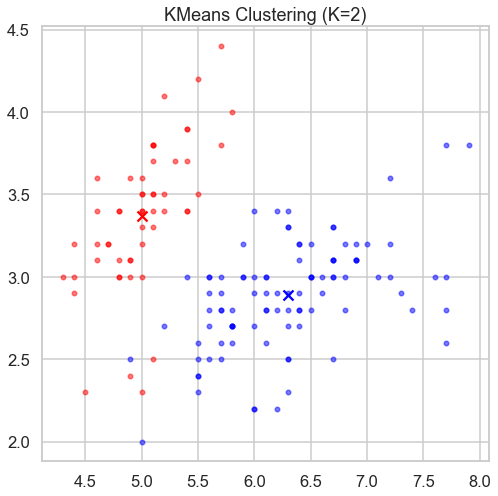

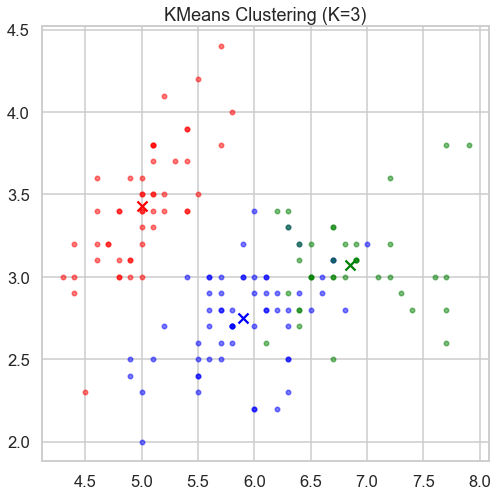

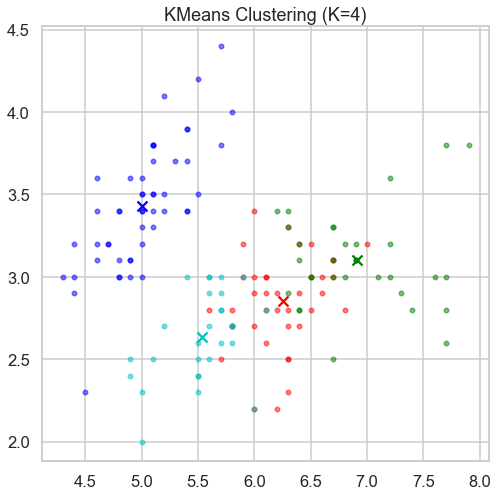

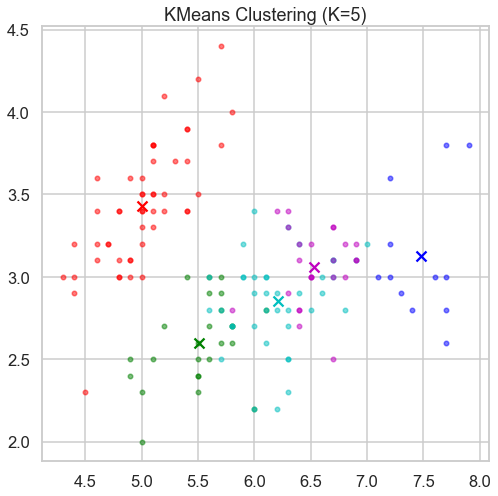

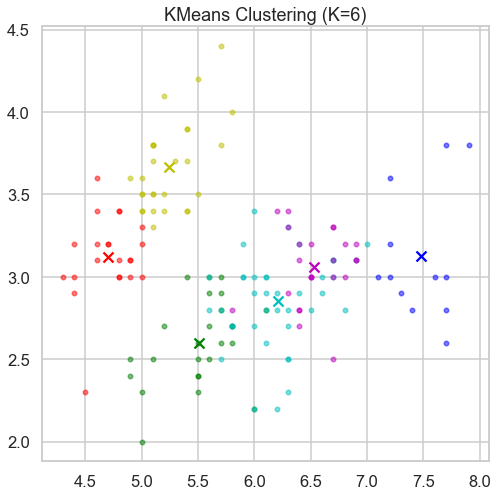

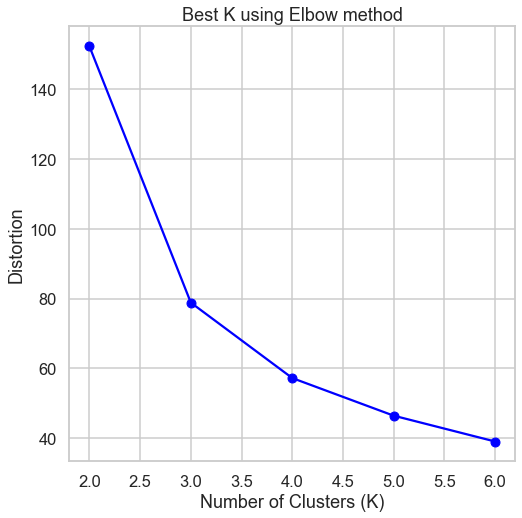

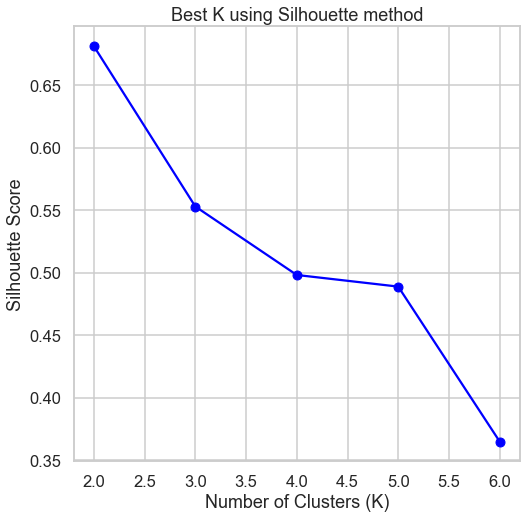

Best value of K: 2


2

In [16]:
k_means(iris.data)

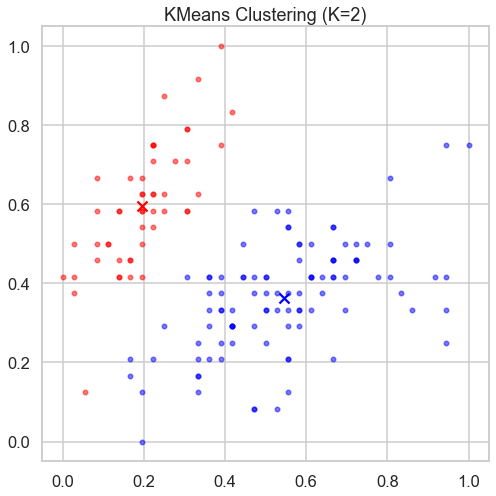

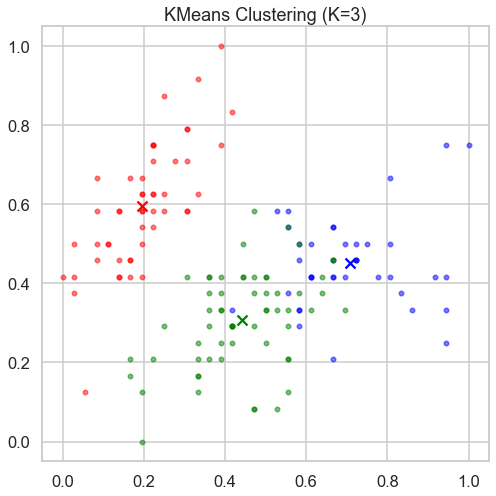

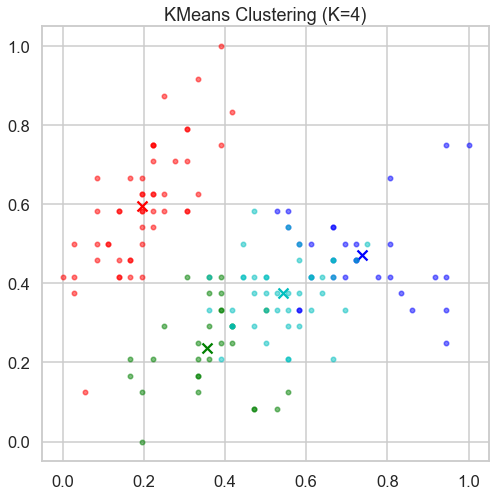

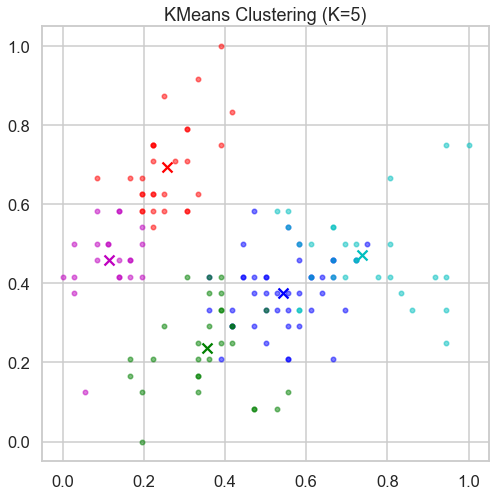

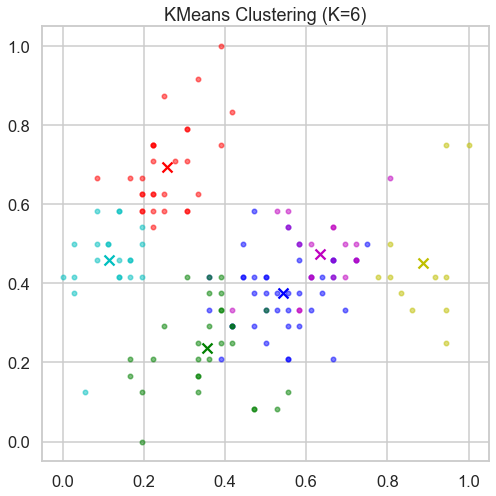

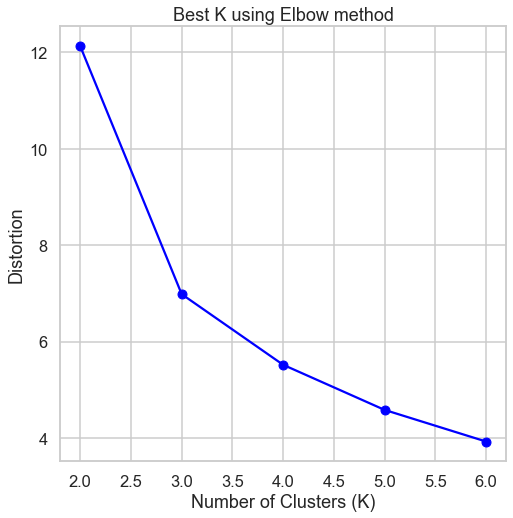

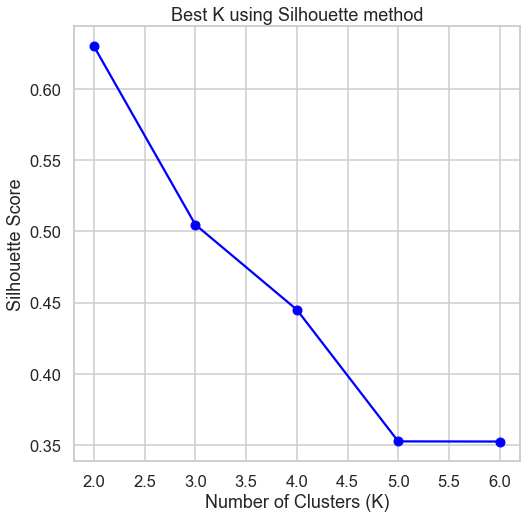

Best value of K: 2


2

In [17]:
k_means(normalized_iris)

Affinity: euclidean, Linkage: average, Distance Threshold: None, Silhouette Score: 0.34


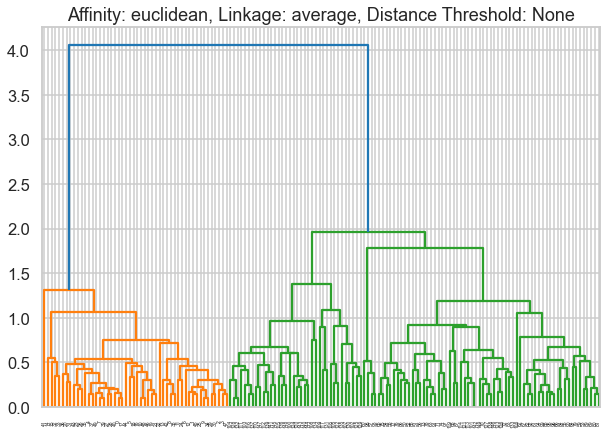

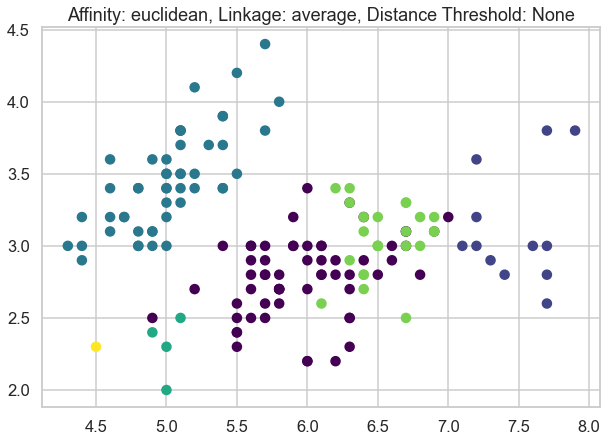

Affinity: euclidean, Linkage: average, Distance Threshold: 1, Silhouette Score: 0.31


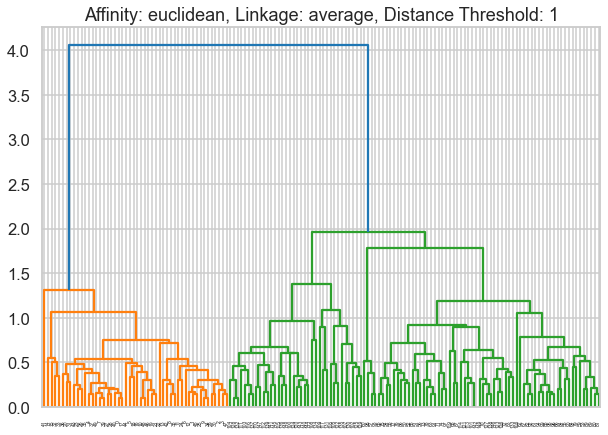

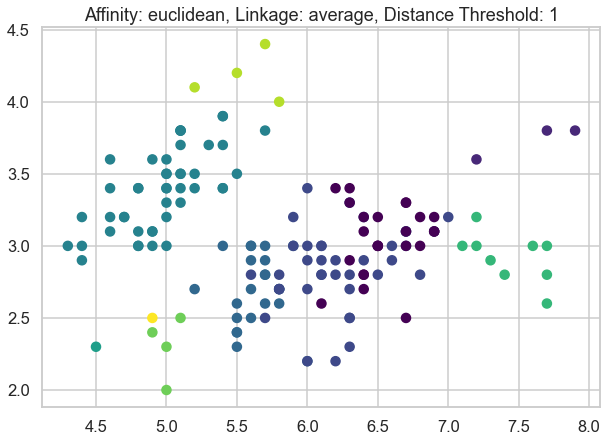

Affinity: euclidean, Linkage: average, Distance Threshold: 2, Silhouette Score: 0.69


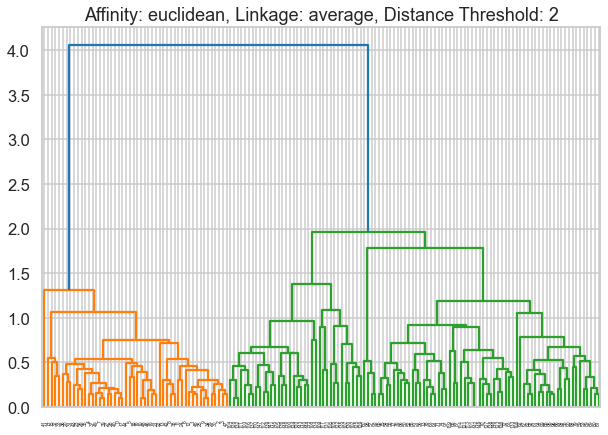

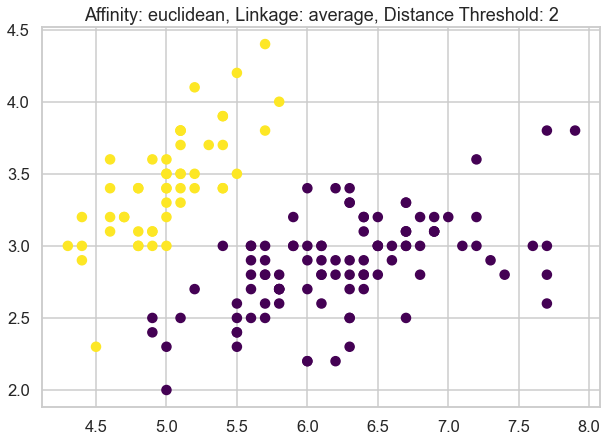

Affinity: euclidean, Linkage: average, Distance Threshold: 3, Silhouette Score: 0.69


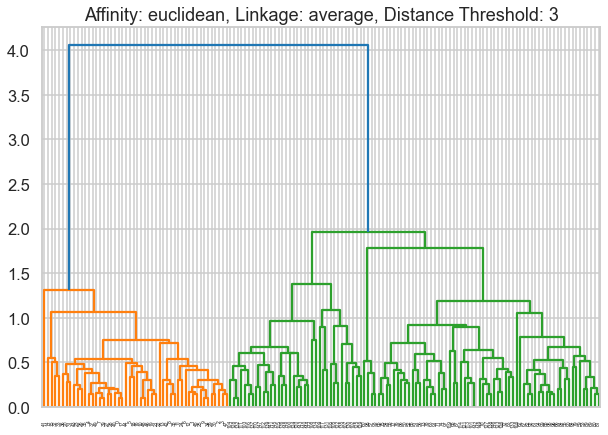

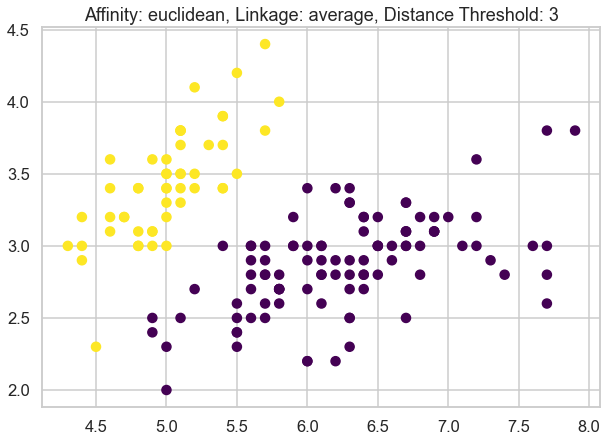

Affinity: euclidean, Linkage: single, Distance Threshold: None, Silhouette Score: 0.22


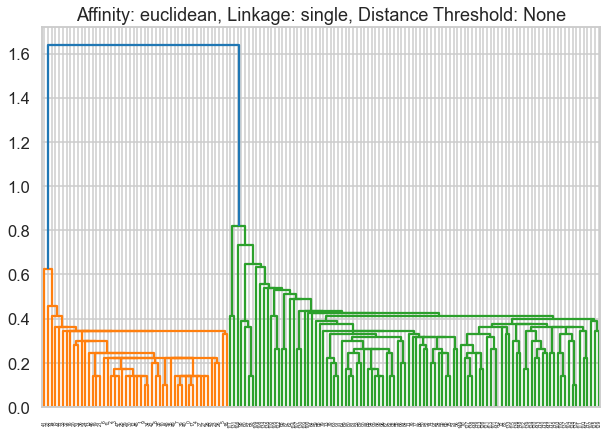

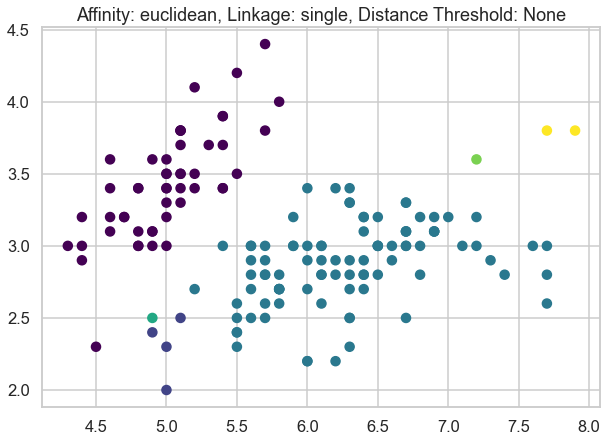

Affinity: euclidean, Linkage: single, Distance Threshold: 1, Silhouette Score: 0.69


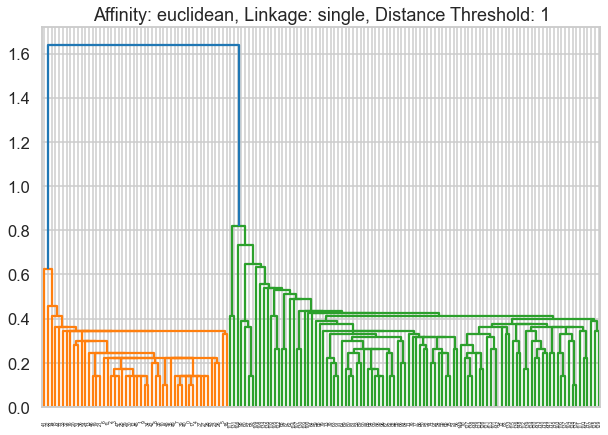

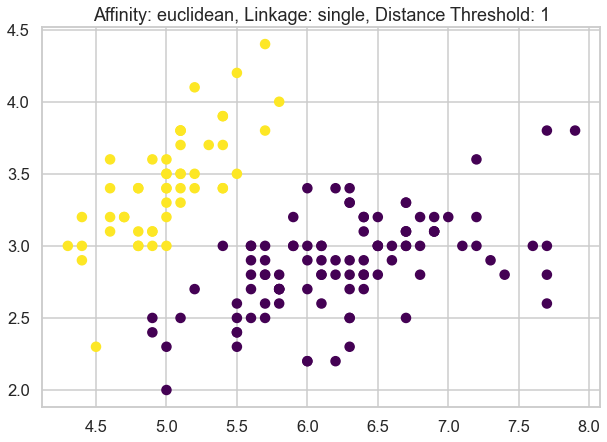

Affinity: euclidean, Linkage: single, Distance Threshold: 2, Silhouette Score cannot be computed with only one label.


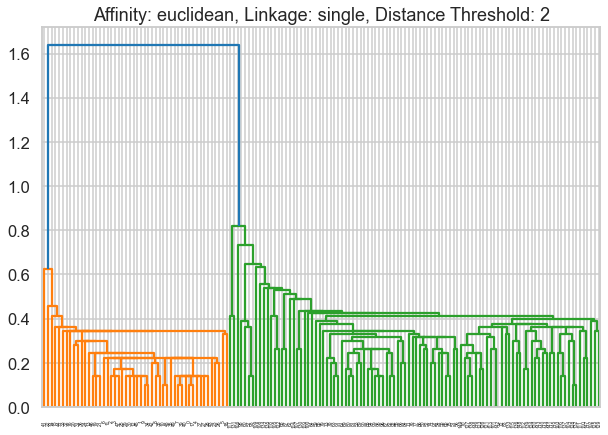

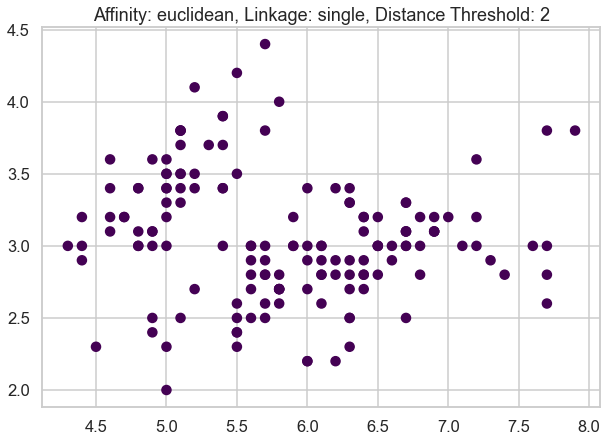

Affinity: euclidean, Linkage: single, Distance Threshold: 3, Silhouette Score cannot be computed with only one label.


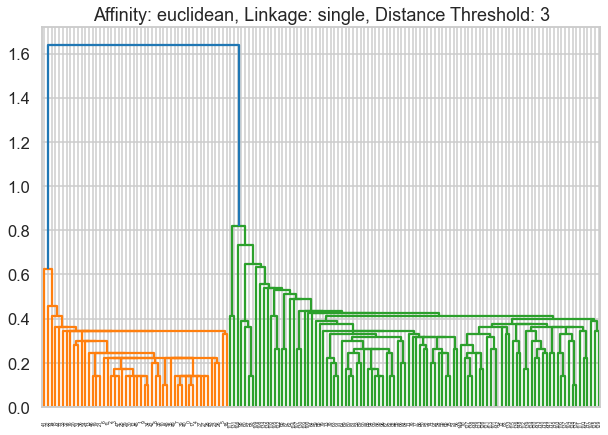

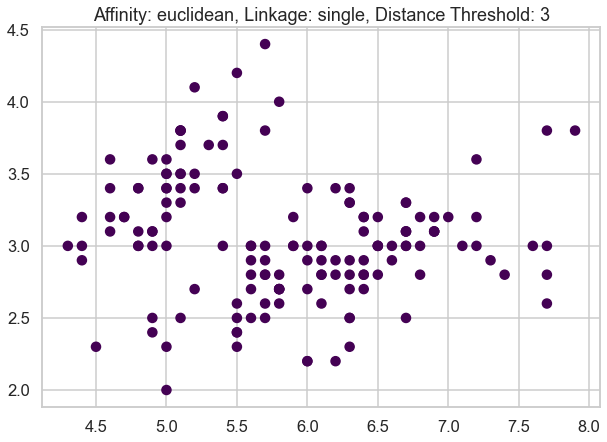

Affinity: cityblock, Linkage: average, Distance Threshold: None, Silhouette Score: 0.34


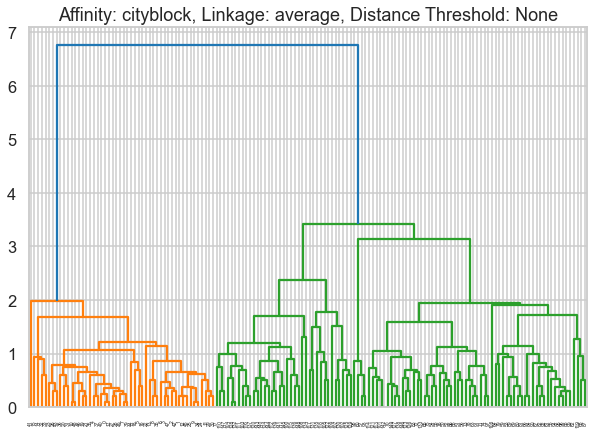

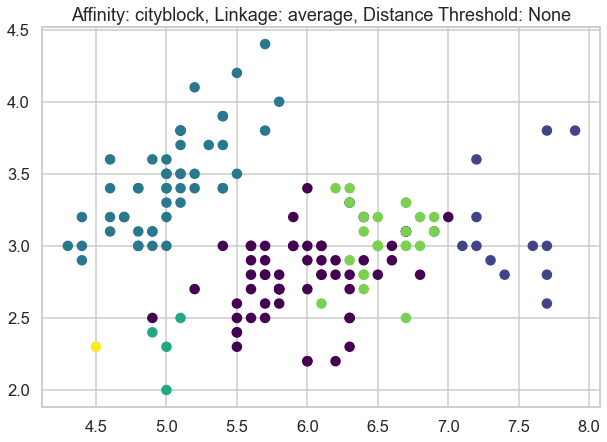

Affinity: cityblock, Linkage: average, Distance Threshold: 1, Silhouette Score: 0.26


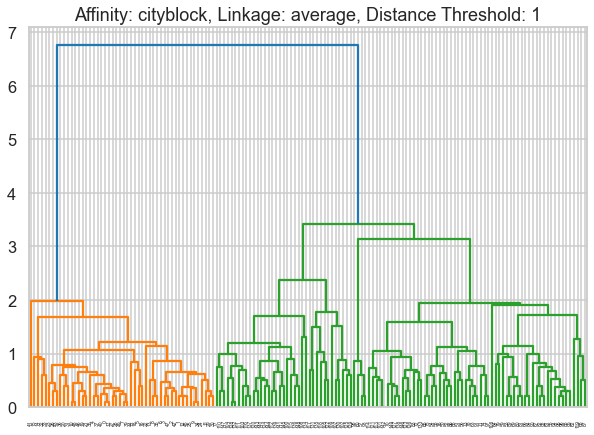

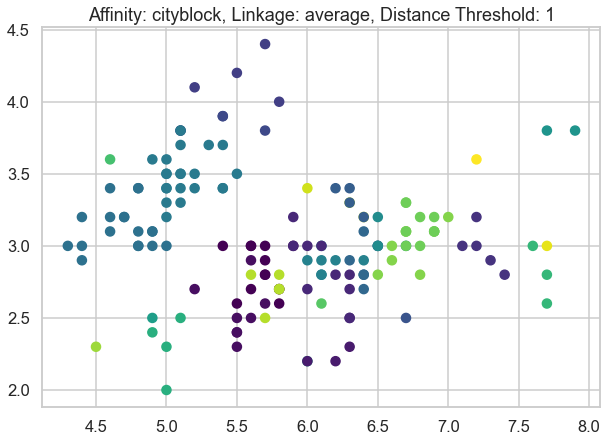

Affinity: cityblock, Linkage: average, Distance Threshold: 2, Silhouette Score: 0.43


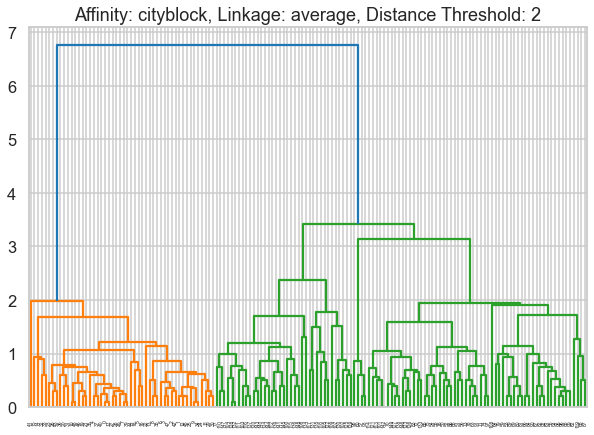

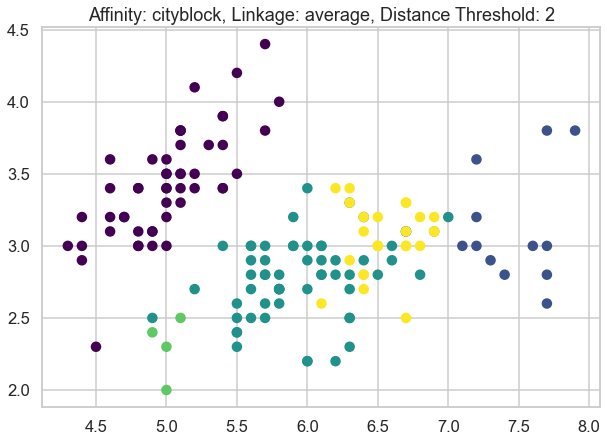

Affinity: cityblock, Linkage: average, Distance Threshold: 3, Silhouette Score: 0.47


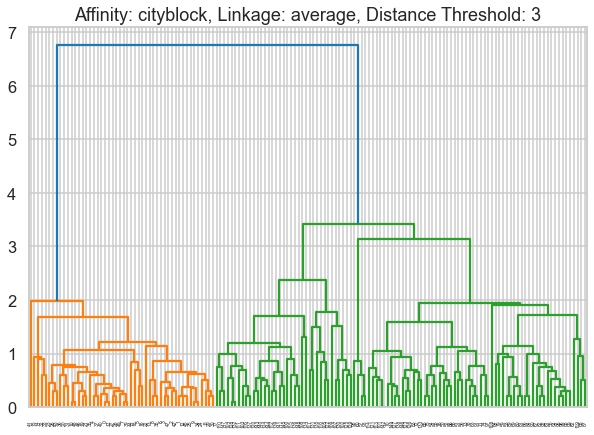

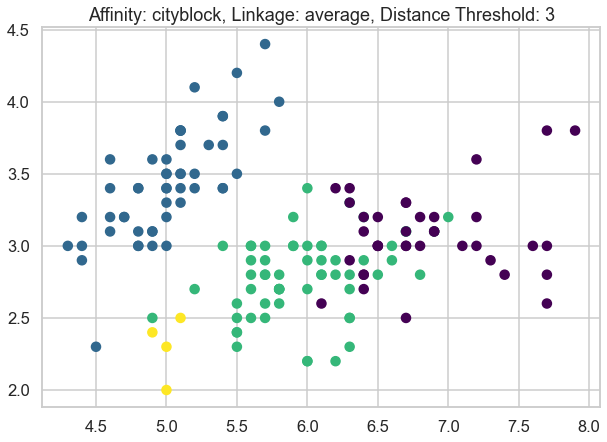

Affinity: cityblock, Linkage: single, Distance Threshold: None, Silhouette Score: 0.15


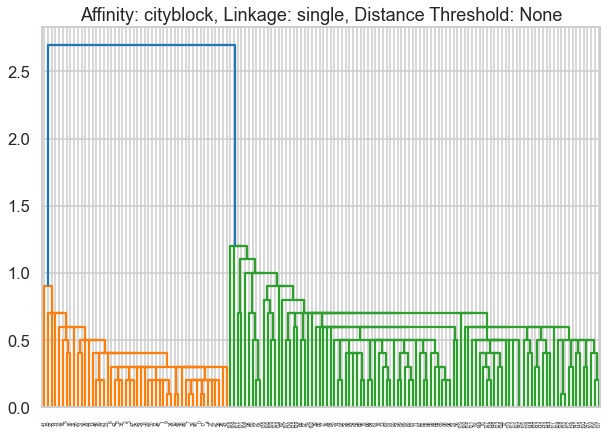

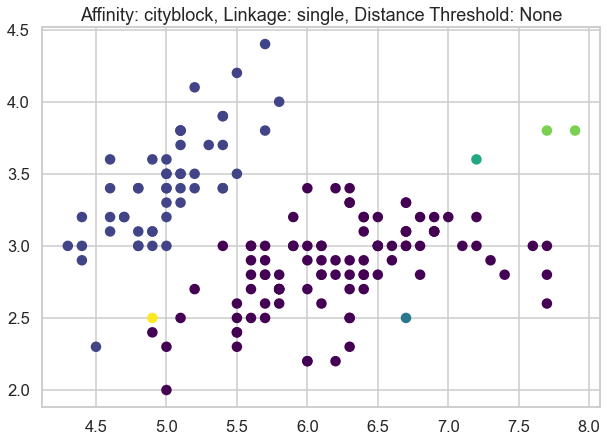

Affinity: cityblock, Linkage: single, Distance Threshold: 1, Silhouette Score: 0.15


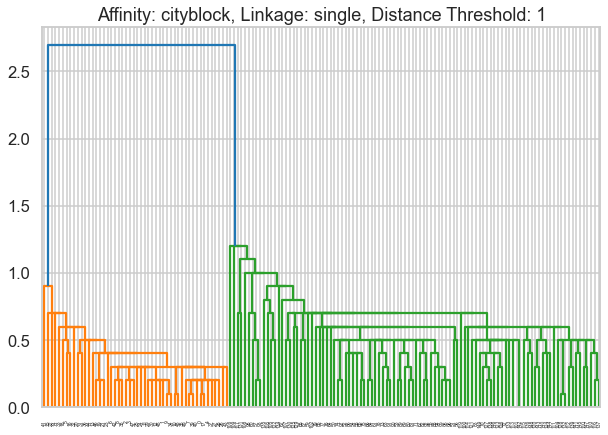

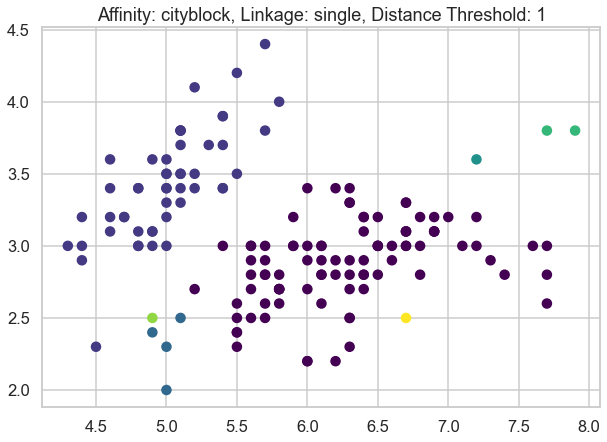

Affinity: cityblock, Linkage: single, Distance Threshold: 2, Silhouette Score: 0.69


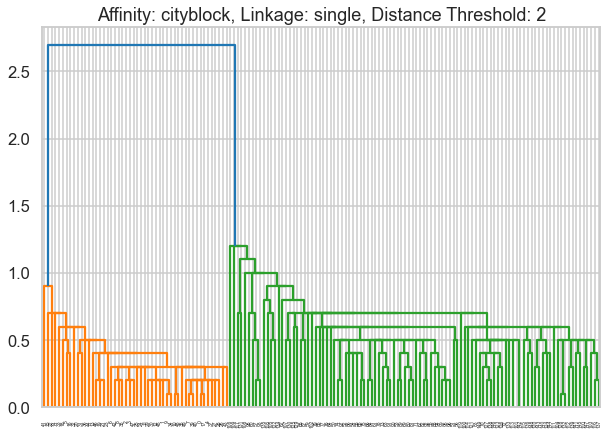

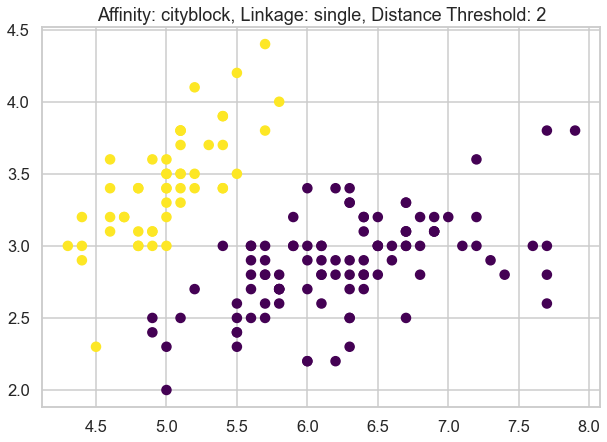

Affinity: cityblock, Linkage: single, Distance Threshold: 3, Silhouette Score cannot be computed with only one label.


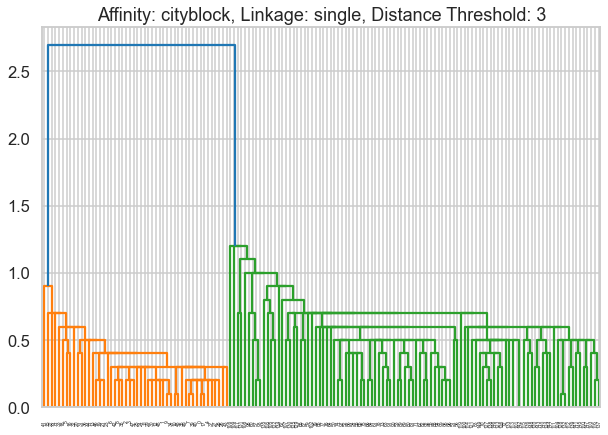

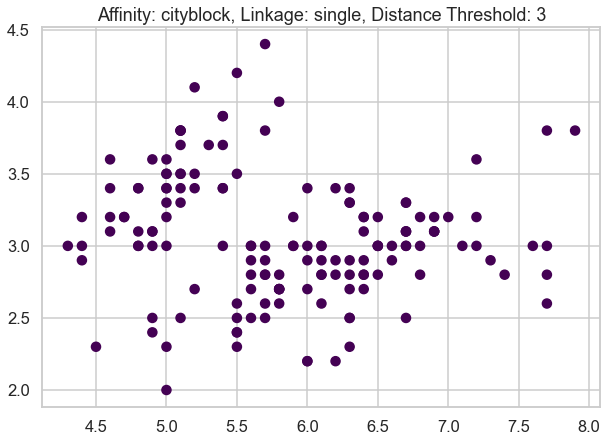

Affinity: cosine, Linkage: average, Distance Threshold: None, Silhouette Score: 0.20


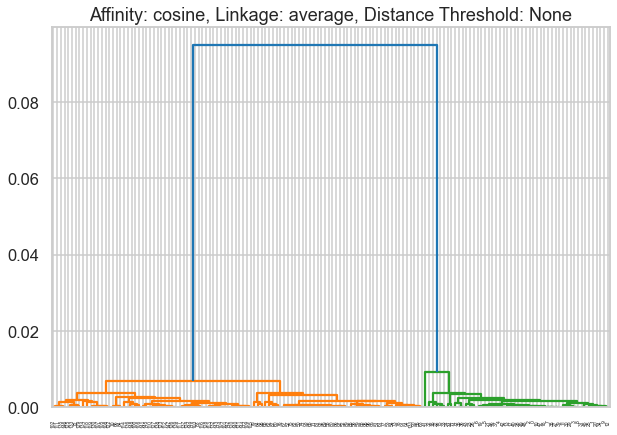

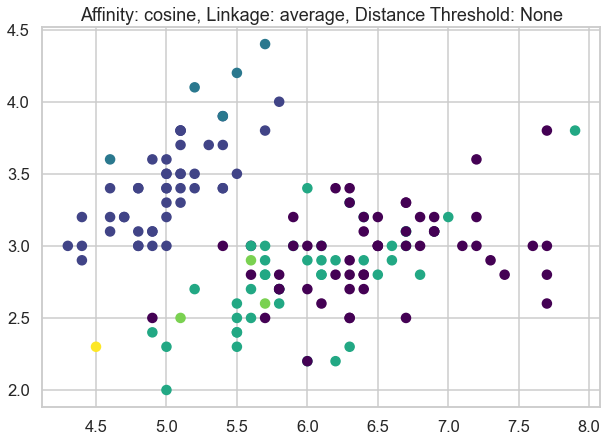

Affinity: cosine, Linkage: average, Distance Threshold: 1, Silhouette Score cannot be computed with only one label.


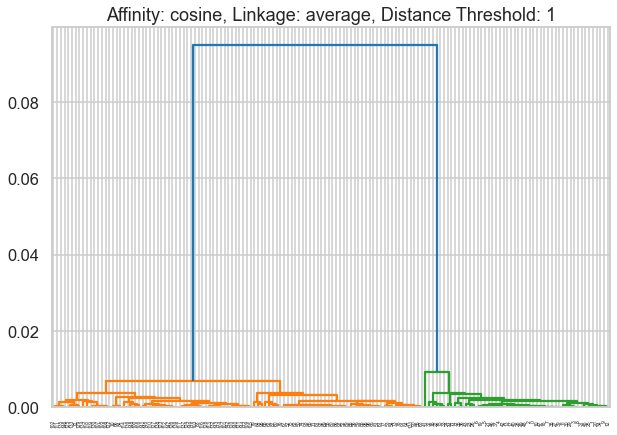

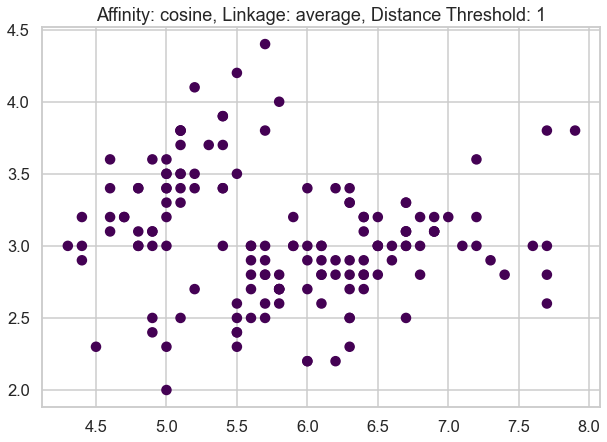

Affinity: cosine, Linkage: average, Distance Threshold: 2, Silhouette Score cannot be computed with only one label.


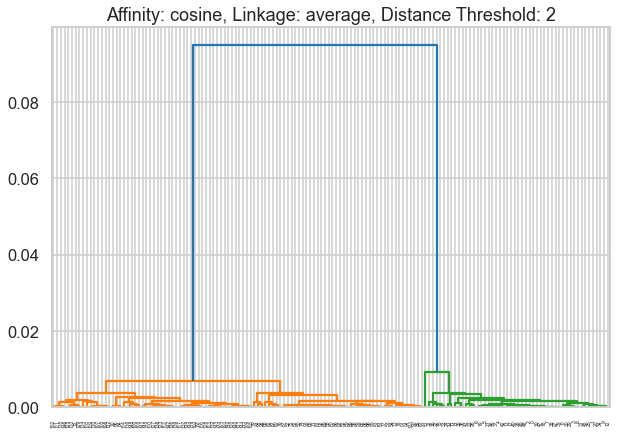

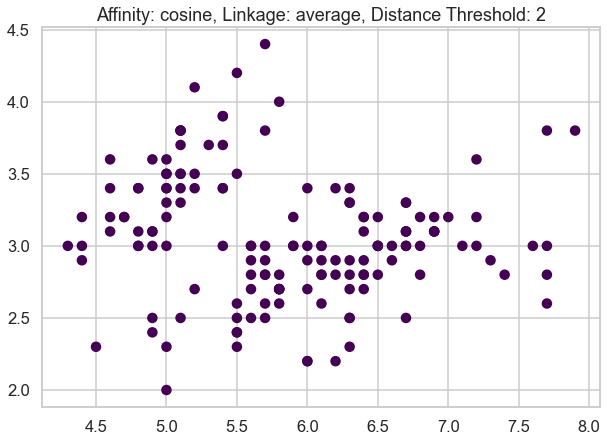

Affinity: cosine, Linkage: average, Distance Threshold: 3, Silhouette Score cannot be computed with only one label.


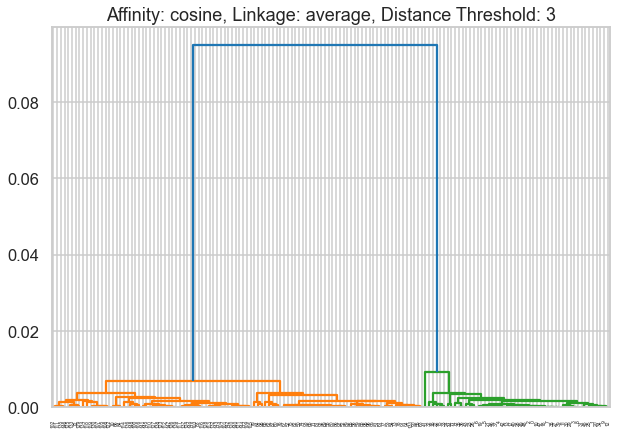

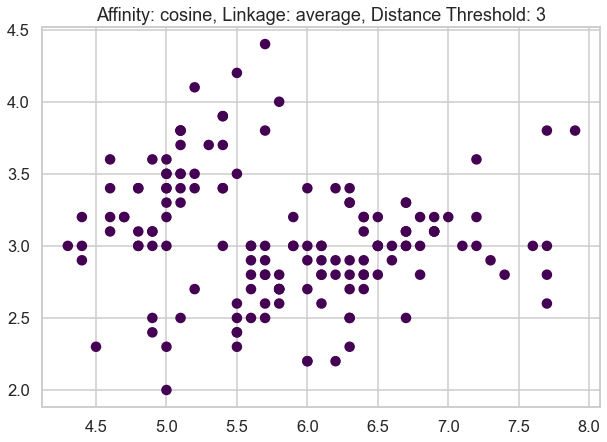

Affinity: cosine, Linkage: single, Distance Threshold: None, Silhouette Score: 0.34


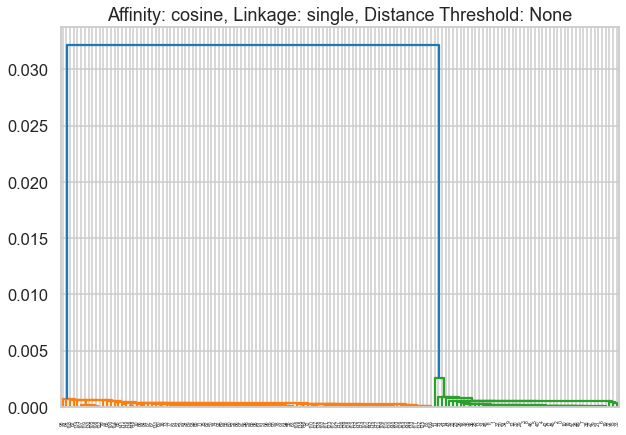

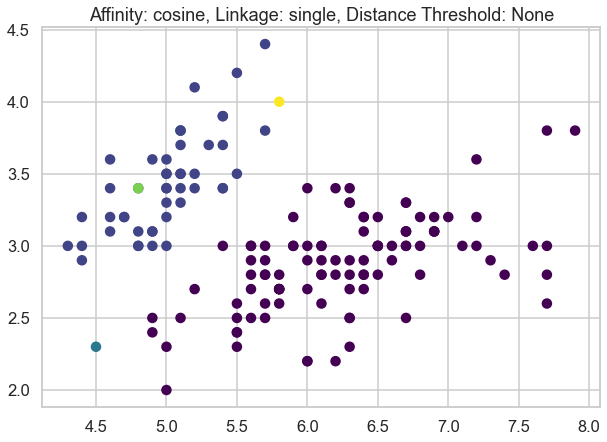

Affinity: cosine, Linkage: single, Distance Threshold: 1, Silhouette Score cannot be computed with only one label.


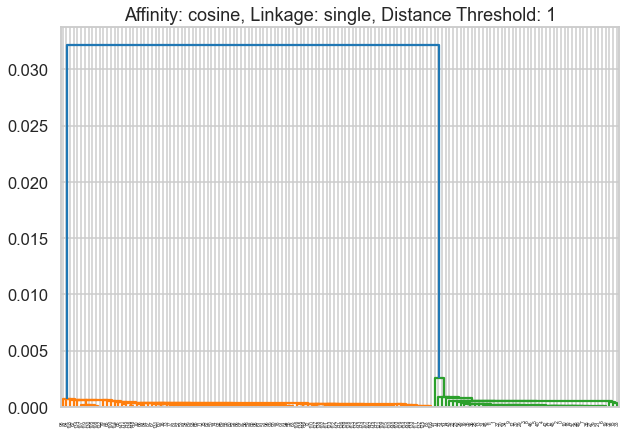

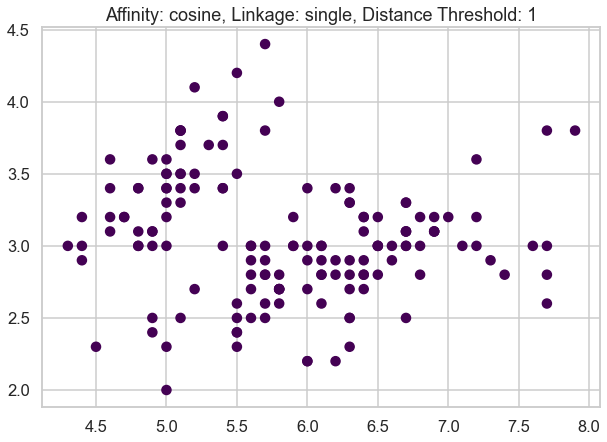

Affinity: cosine, Linkage: single, Distance Threshold: 2, Silhouette Score cannot be computed with only one label.


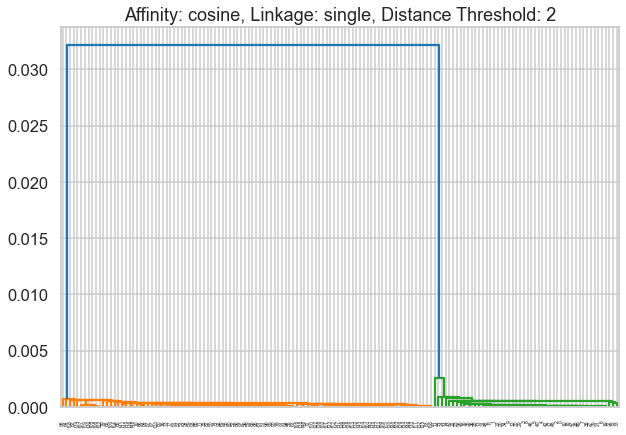

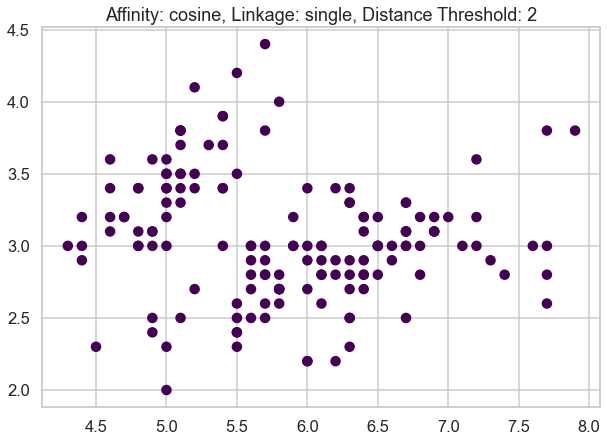

Affinity: cosine, Linkage: single, Distance Threshold: 3, Silhouette Score cannot be computed with only one label.


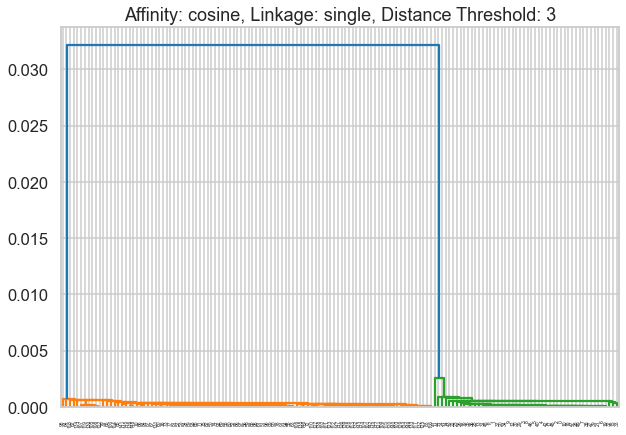

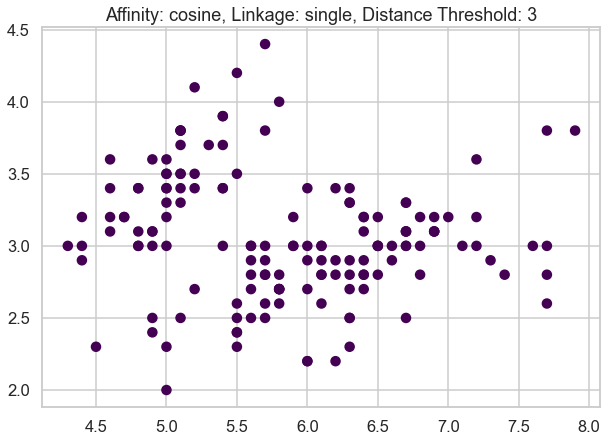

Best Silhouette Score: 0.69
Best Affinity: euclidean
Best Linkage: average
Best Distance Threshold: 2


In [18]:
agglomerative_clustering(iris.data, affinities, linkages, dist_thresholds)

Affinity: euclidean, Linkage: average, Distance Threshold: None, Silhouette Score: 0.35


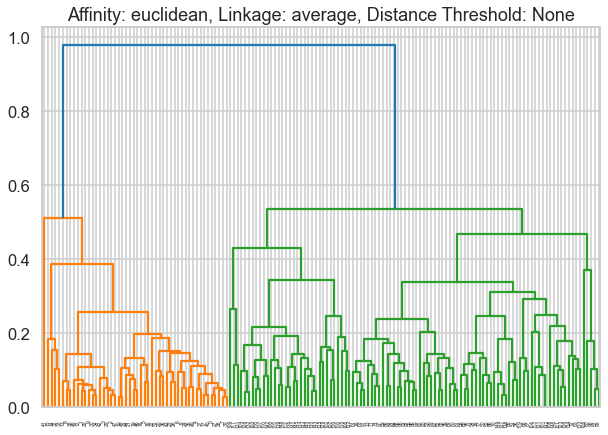

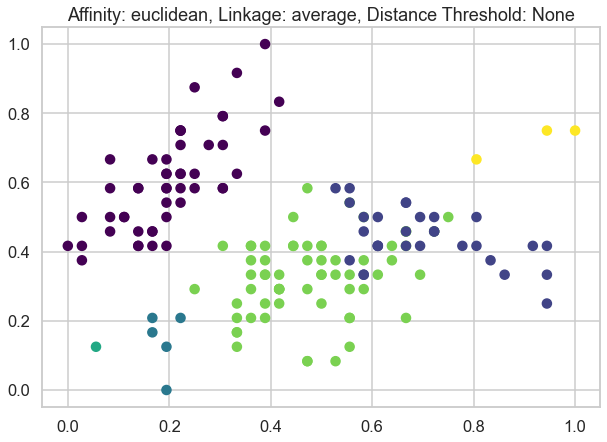

Affinity: euclidean, Linkage: average, Distance Threshold: 1, Silhouette Score cannot be computed with only one label.


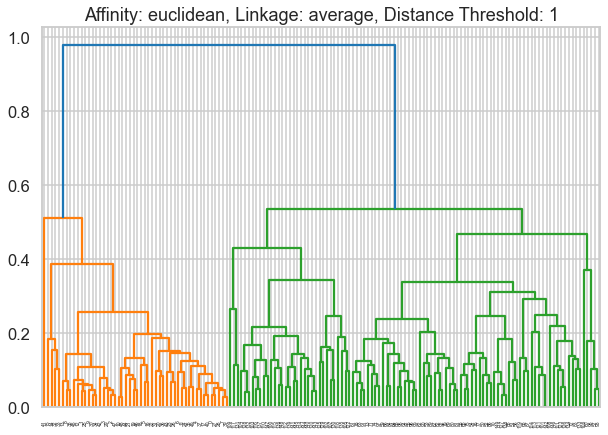

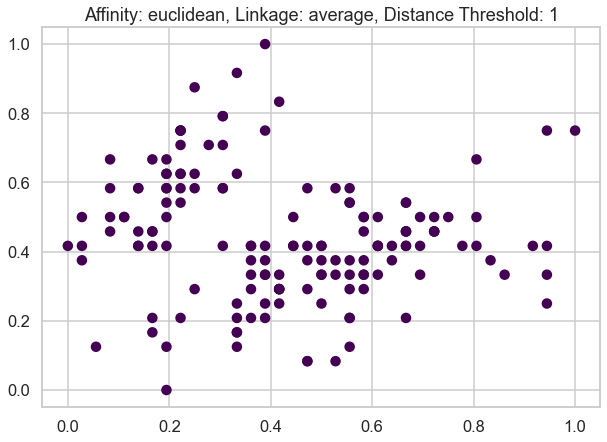

Affinity: euclidean, Linkage: average, Distance Threshold: 2, Silhouette Score cannot be computed with only one label.


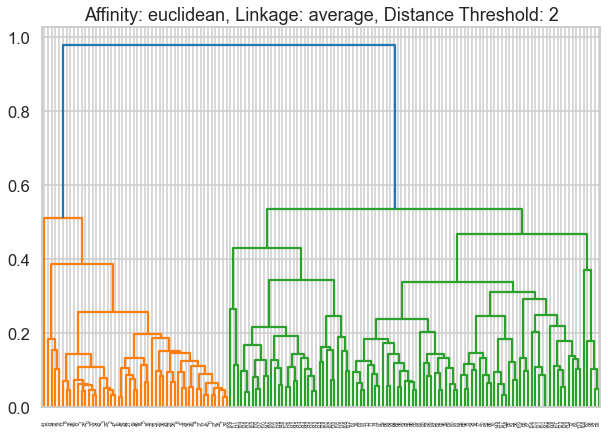

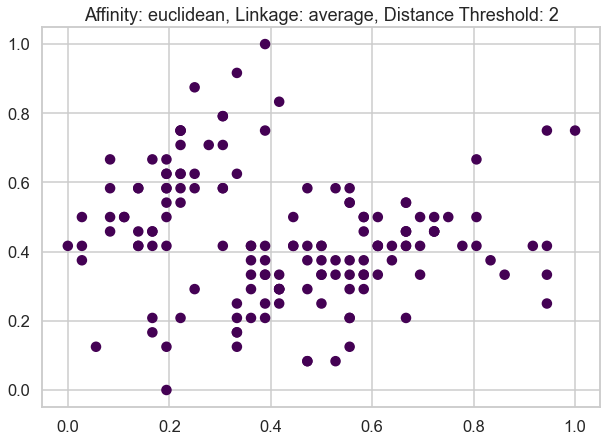

Affinity: euclidean, Linkage: average, Distance Threshold: 3, Silhouette Score cannot be computed with only one label.


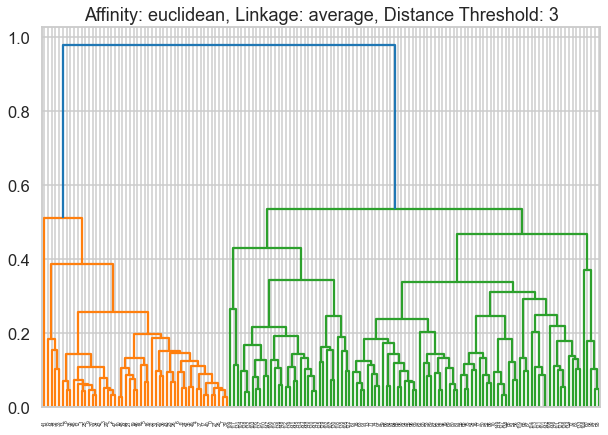

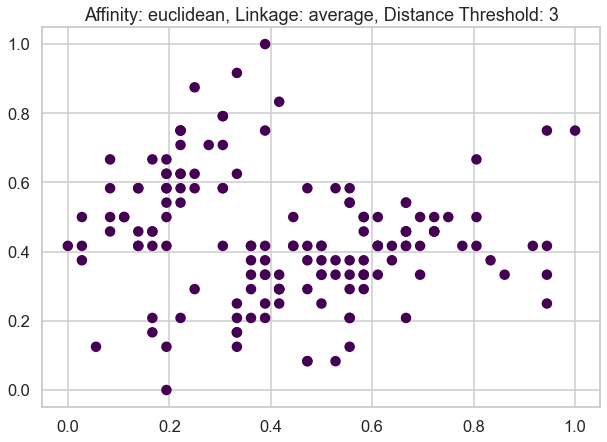

Affinity: euclidean, Linkage: single, Distance Threshold: None, Silhouette Score: 0.16


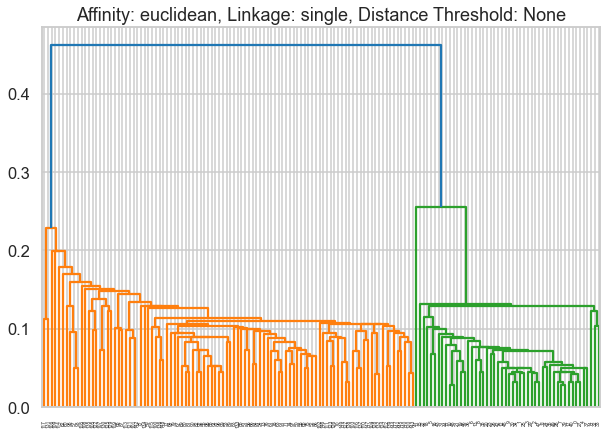

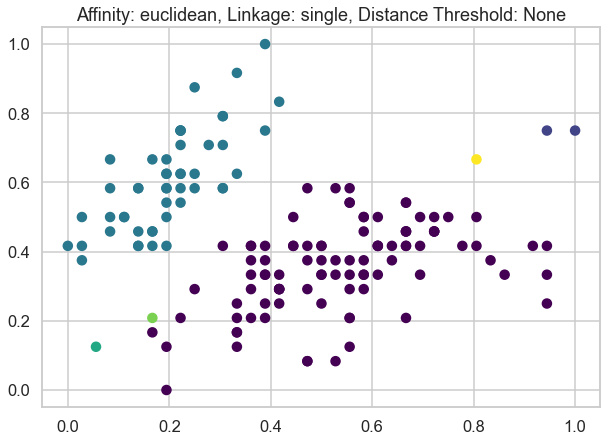

Affinity: euclidean, Linkage: single, Distance Threshold: 1, Silhouette Score cannot be computed with only one label.


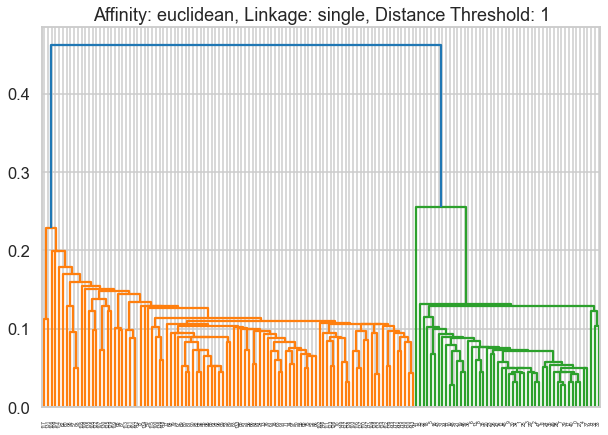

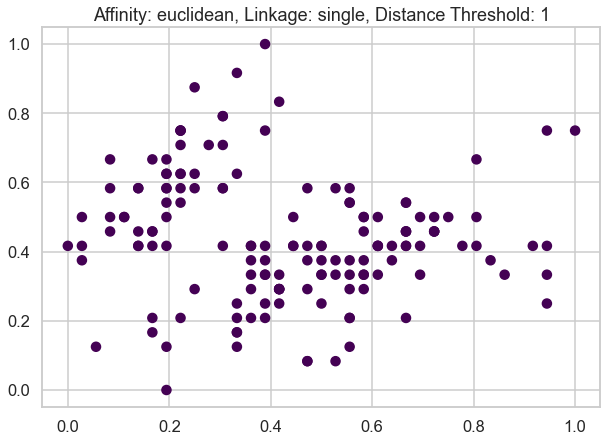

Affinity: euclidean, Linkage: single, Distance Threshold: 2, Silhouette Score cannot be computed with only one label.


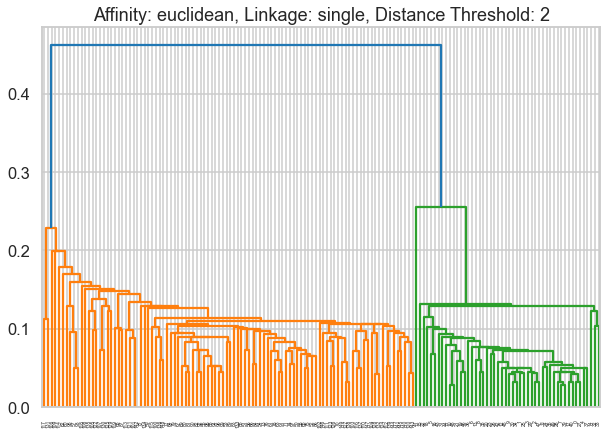

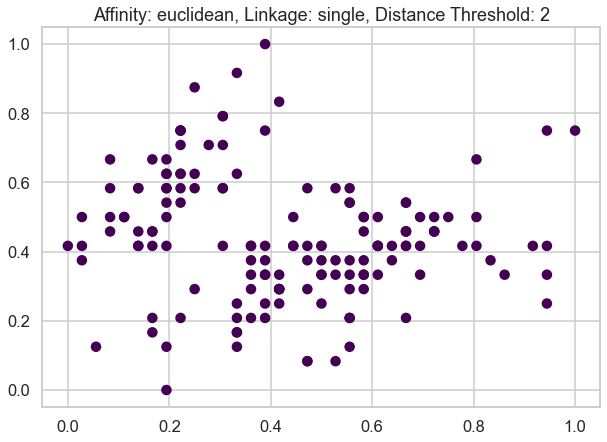

Affinity: euclidean, Linkage: single, Distance Threshold: 3, Silhouette Score cannot be computed with only one label.


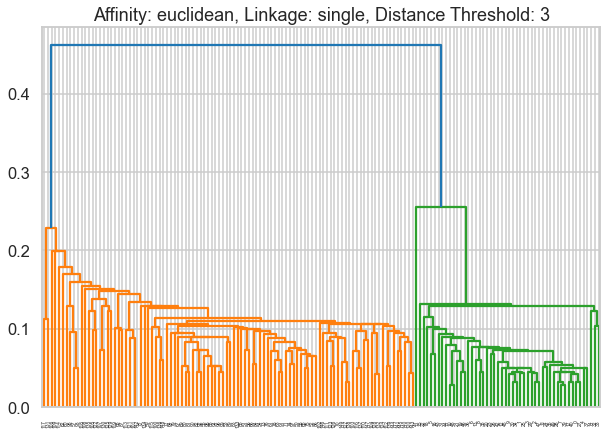

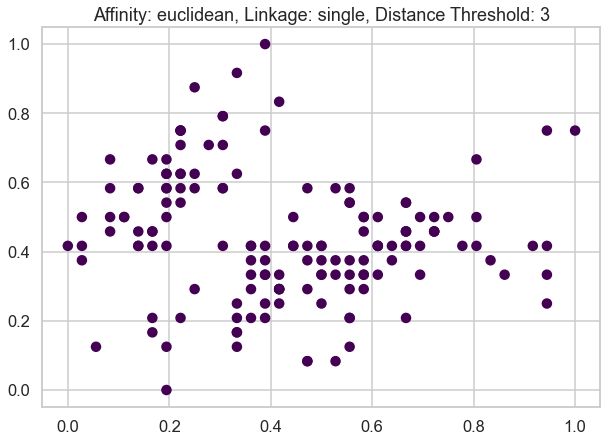

Affinity: cityblock, Linkage: average, Distance Threshold: None, Silhouette Score: 0.37


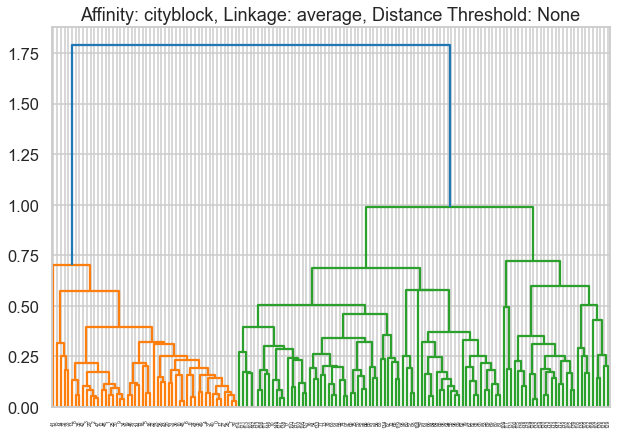

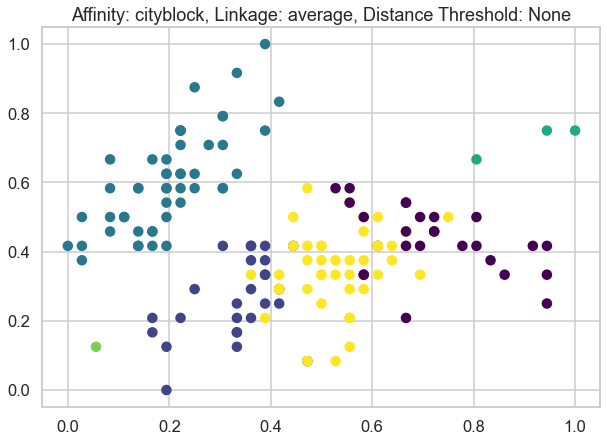

Affinity: cityblock, Linkage: average, Distance Threshold: 1, Silhouette Score: 0.63


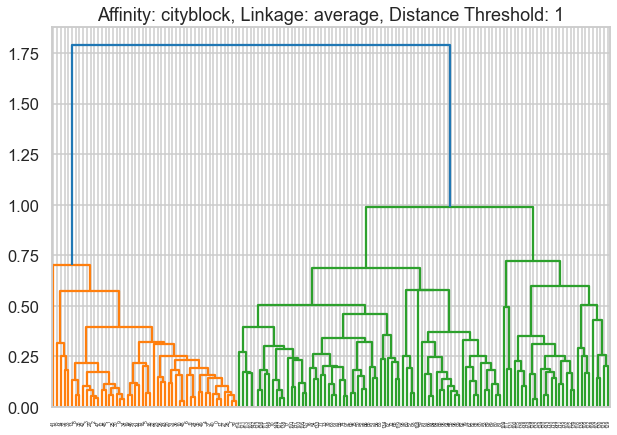

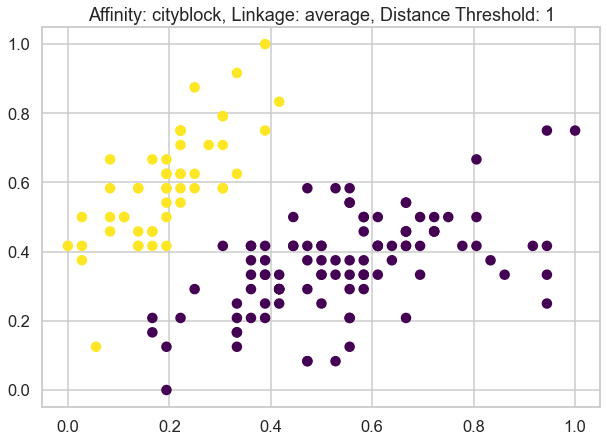

Affinity: cityblock, Linkage: average, Distance Threshold: 2, Silhouette Score cannot be computed with only one label.


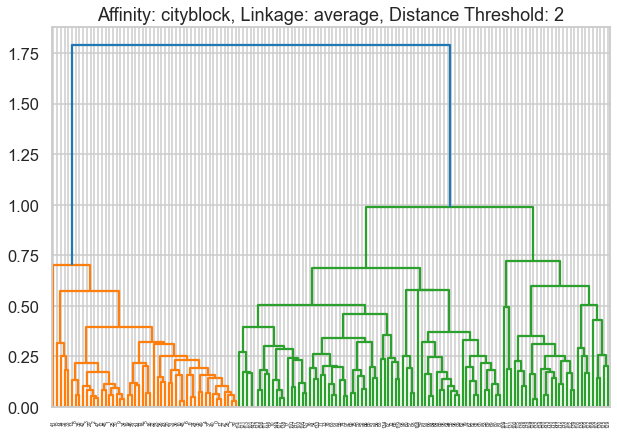

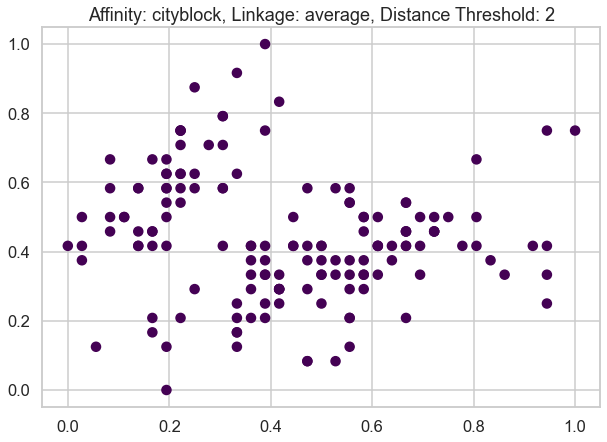

Affinity: cityblock, Linkage: average, Distance Threshold: 3, Silhouette Score cannot be computed with only one label.


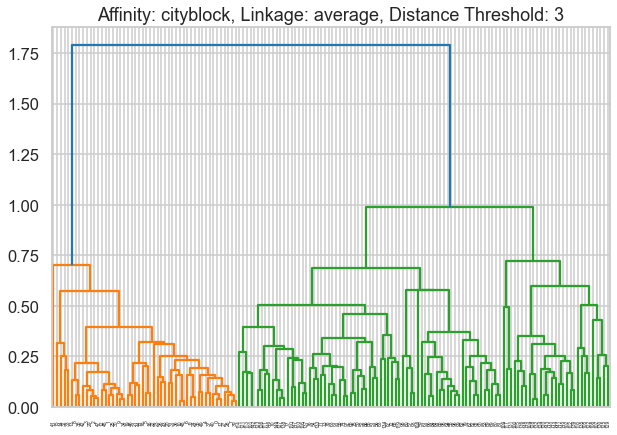

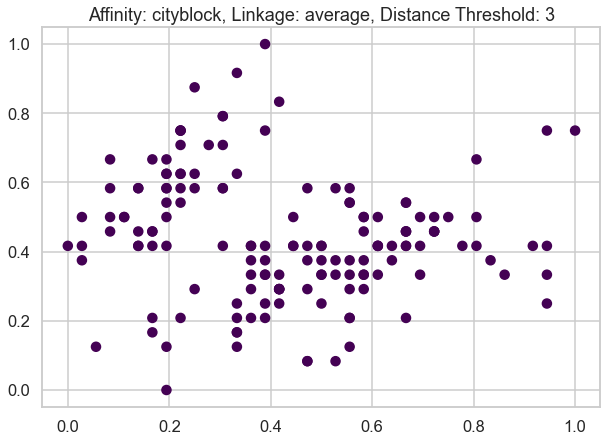

Affinity: cityblock, Linkage: single, Distance Threshold: None, Silhouette Score: 0.16


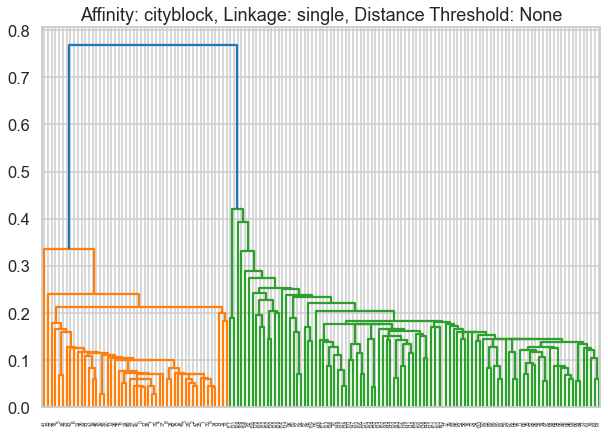

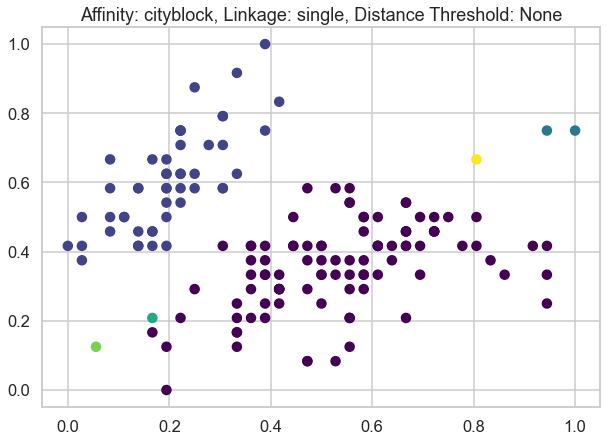

Affinity: cityblock, Linkage: single, Distance Threshold: 1, Silhouette Score cannot be computed with only one label.


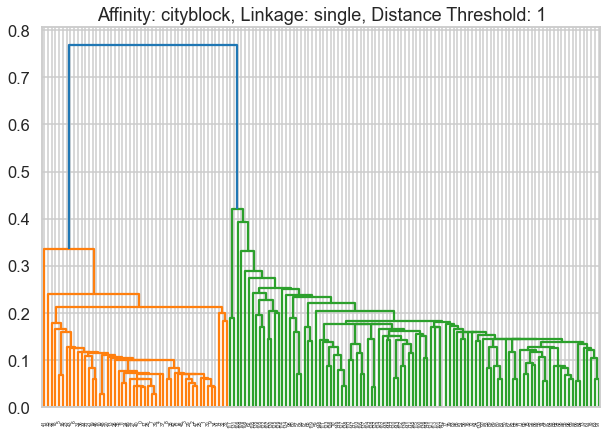

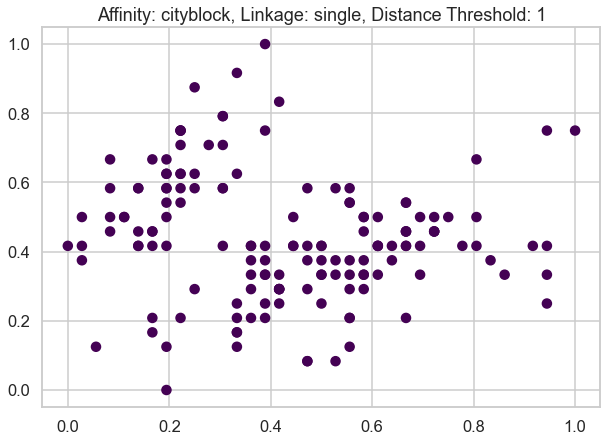

Affinity: cityblock, Linkage: single, Distance Threshold: 2, Silhouette Score cannot be computed with only one label.


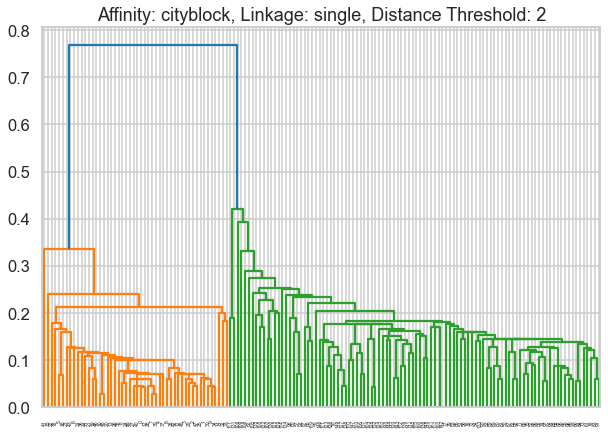

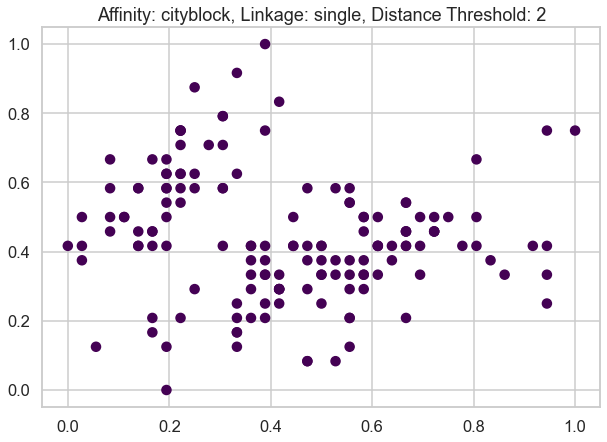

Affinity: cityblock, Linkage: single, Distance Threshold: 3, Silhouette Score cannot be computed with only one label.


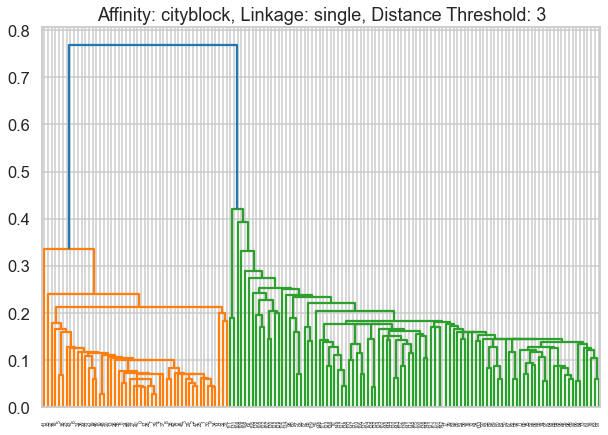

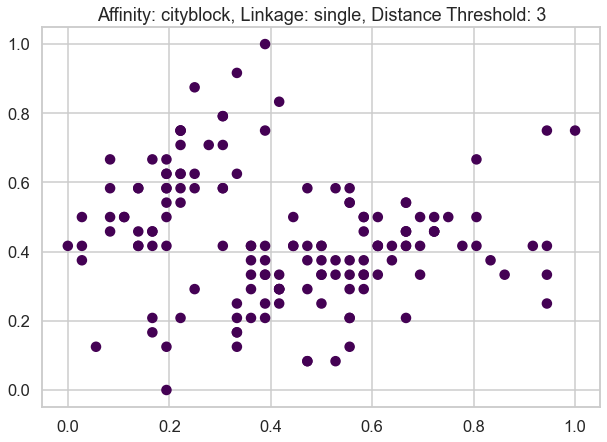

Affinity: cosine, Linkage: average, Distance Threshold: None, Silhouette Score: 0.12


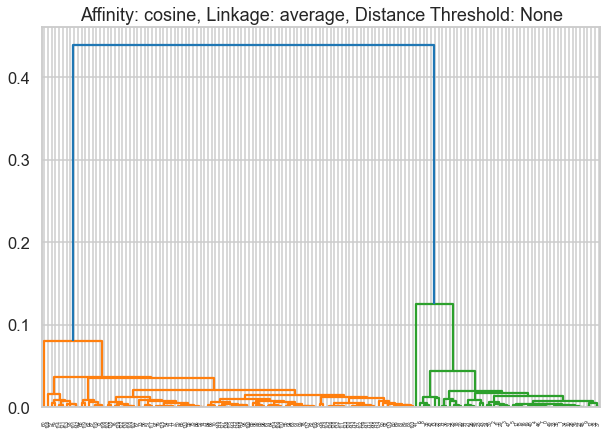

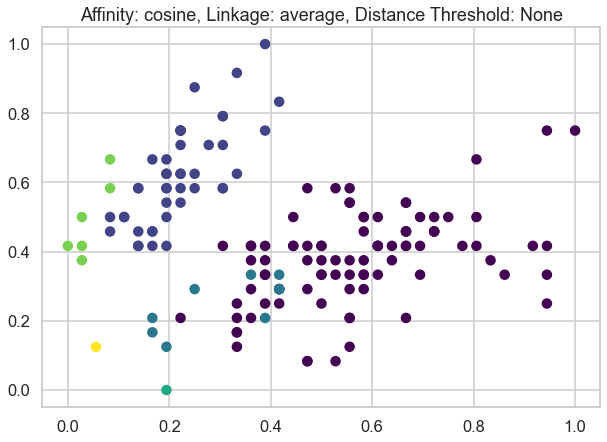

Affinity: cosine, Linkage: average, Distance Threshold: 1, Silhouette Score cannot be computed with only one label.


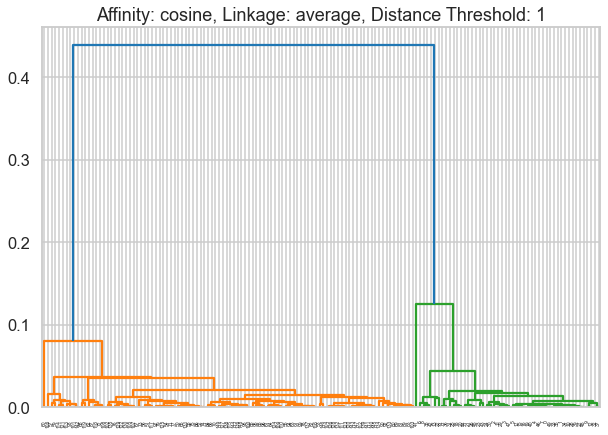

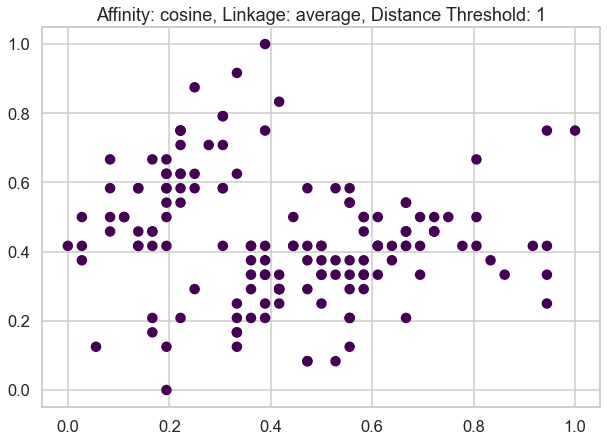

Affinity: cosine, Linkage: average, Distance Threshold: 2, Silhouette Score cannot be computed with only one label.


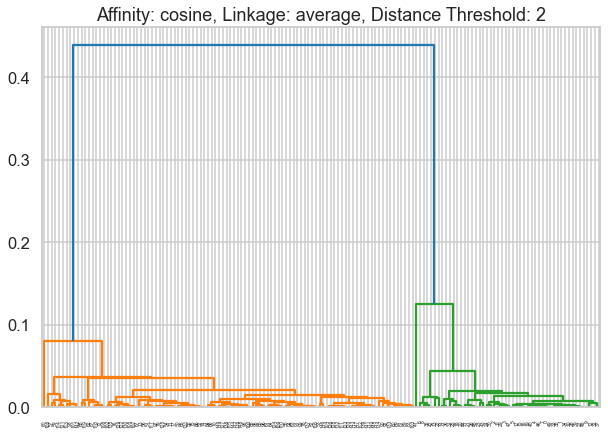

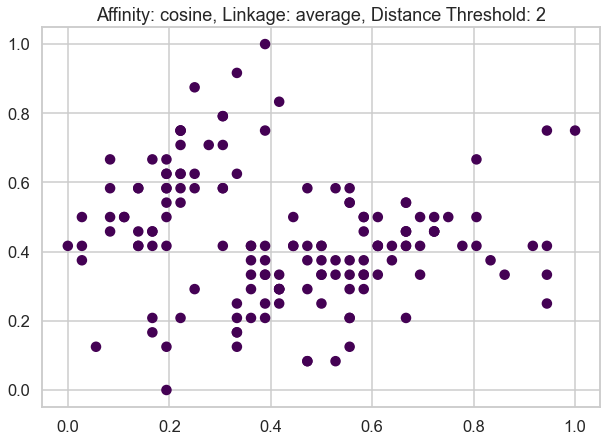

Affinity: cosine, Linkage: average, Distance Threshold: 3, Silhouette Score cannot be computed with only one label.


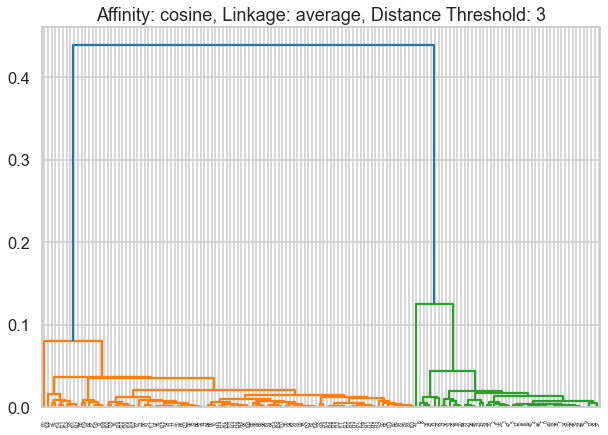

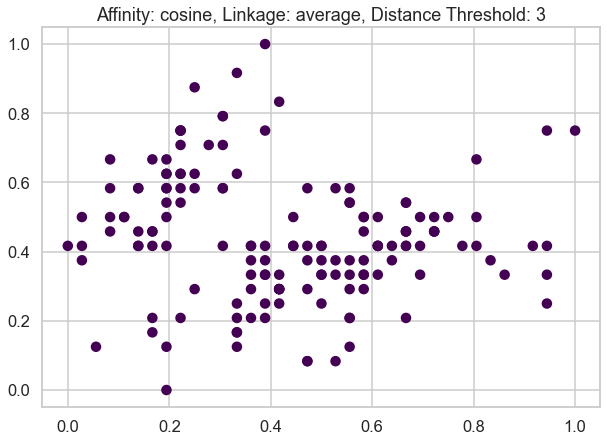

Affinity: cosine, Linkage: single, Distance Threshold: None, Silhouette Score: 0.08


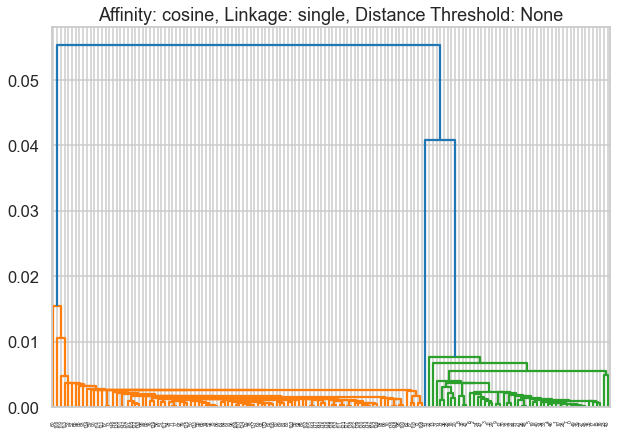

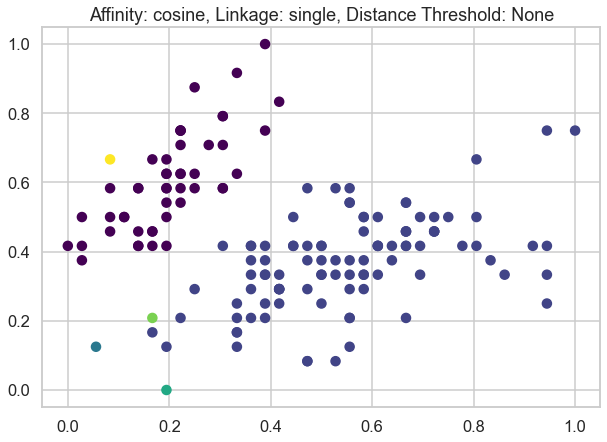

Affinity: cosine, Linkage: single, Distance Threshold: 1, Silhouette Score cannot be computed with only one label.


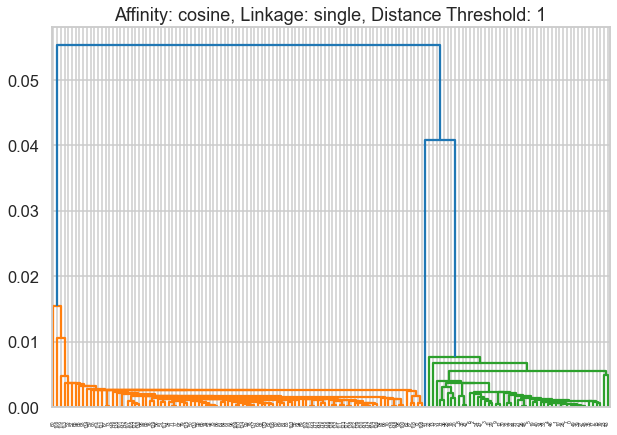

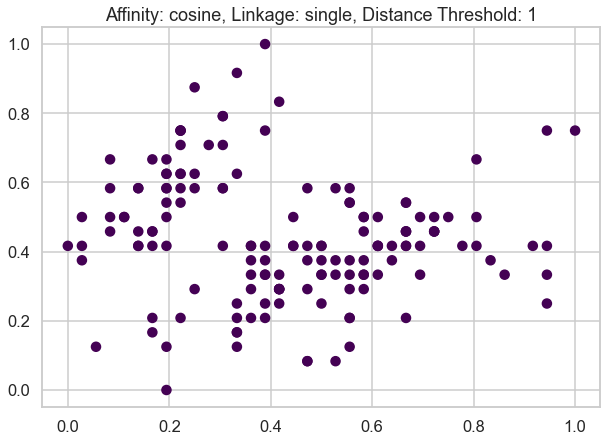

Affinity: cosine, Linkage: single, Distance Threshold: 2, Silhouette Score cannot be computed with only one label.


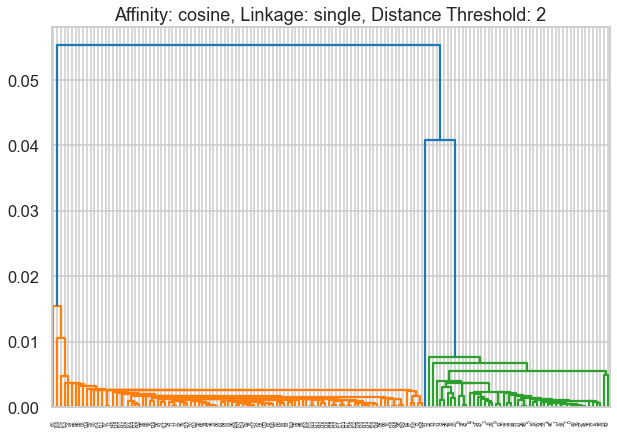

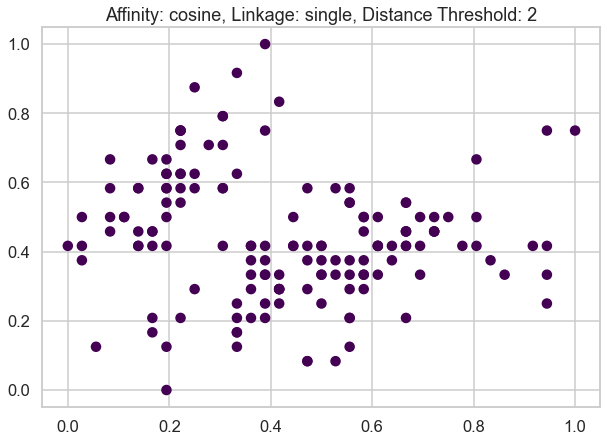

Affinity: cosine, Linkage: single, Distance Threshold: 3, Silhouette Score cannot be computed with only one label.


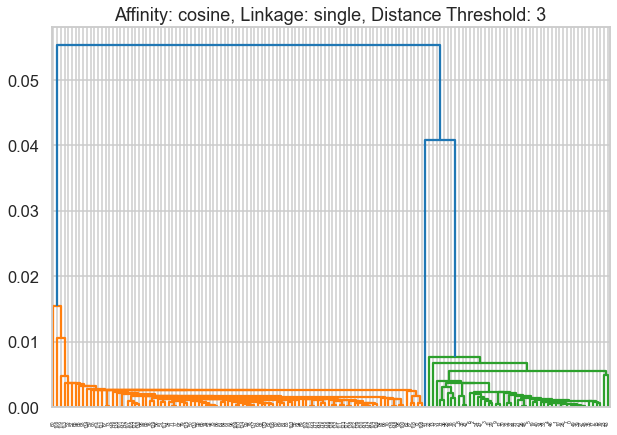

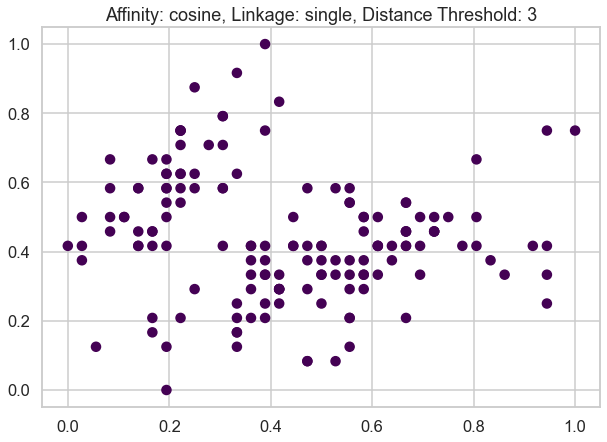

Best Silhouette Score: 0.63
Best Affinity: cityblock
Best Linkage: average
Best Distance Threshold: 1


In [19]:
agglomerative_clustering(normalized_iris, affinities, linkages, dist_thresholds)

Best Silhouette Score: 0.69, eps=0.90, min_samples=5


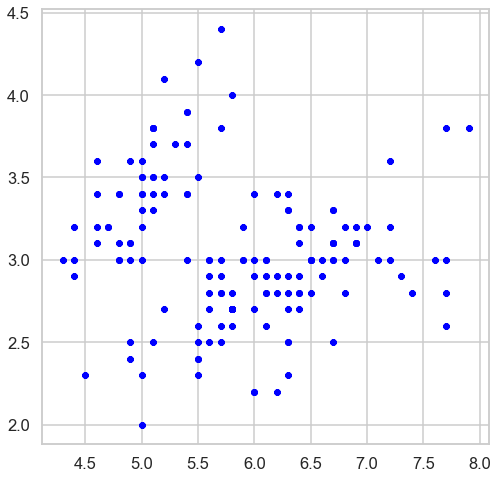

In [20]:
dbscan_clustering(iris.data)

Best Silhouette Score: 0.63, eps=0.40, min_samples=5


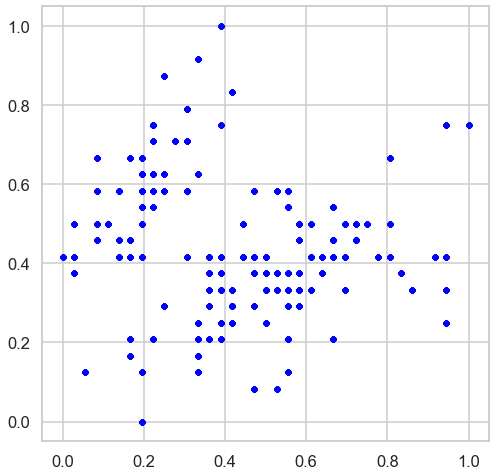

In [21]:
dbscan_clustering(normalized_iris)

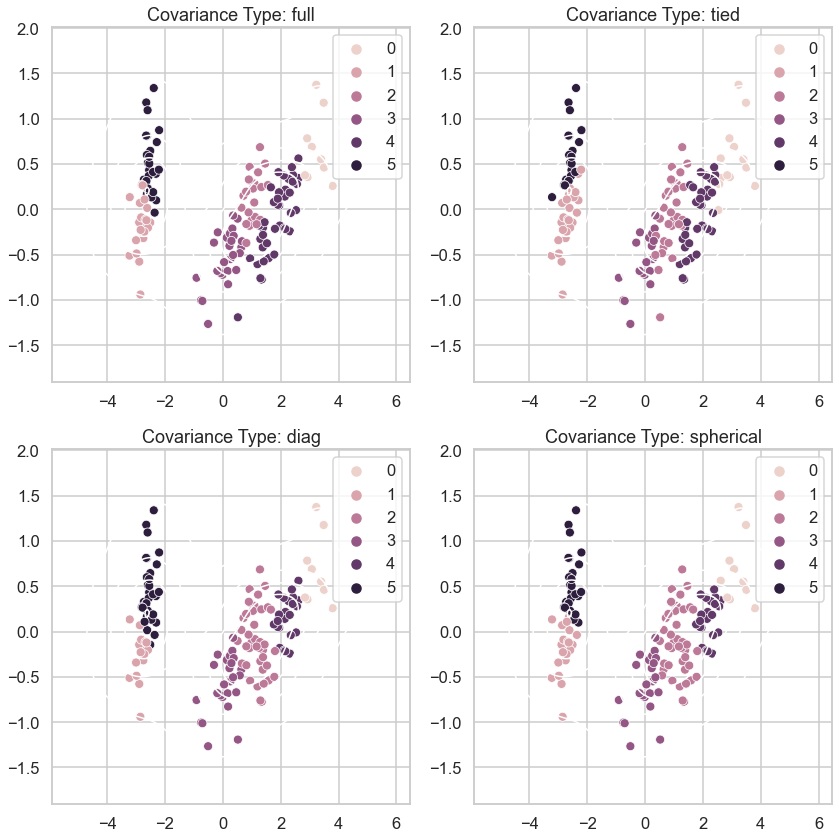

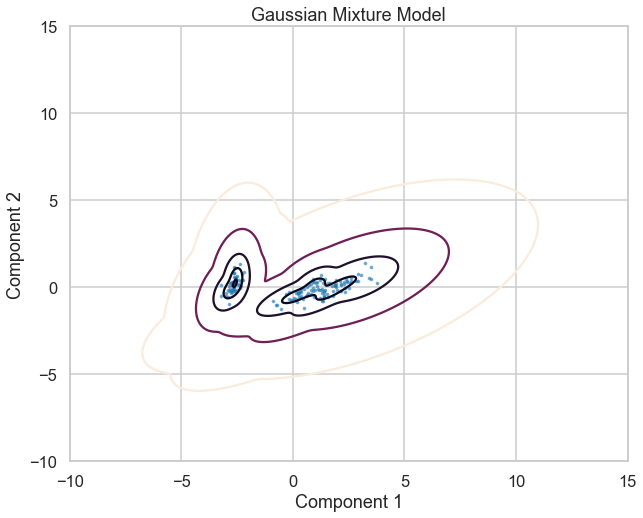

In [22]:
plot_gmm_clusters(iris.data, n_clusters=6, covariance_types=('full', 'tied', 'diag', 'spherical'), random_state=42)

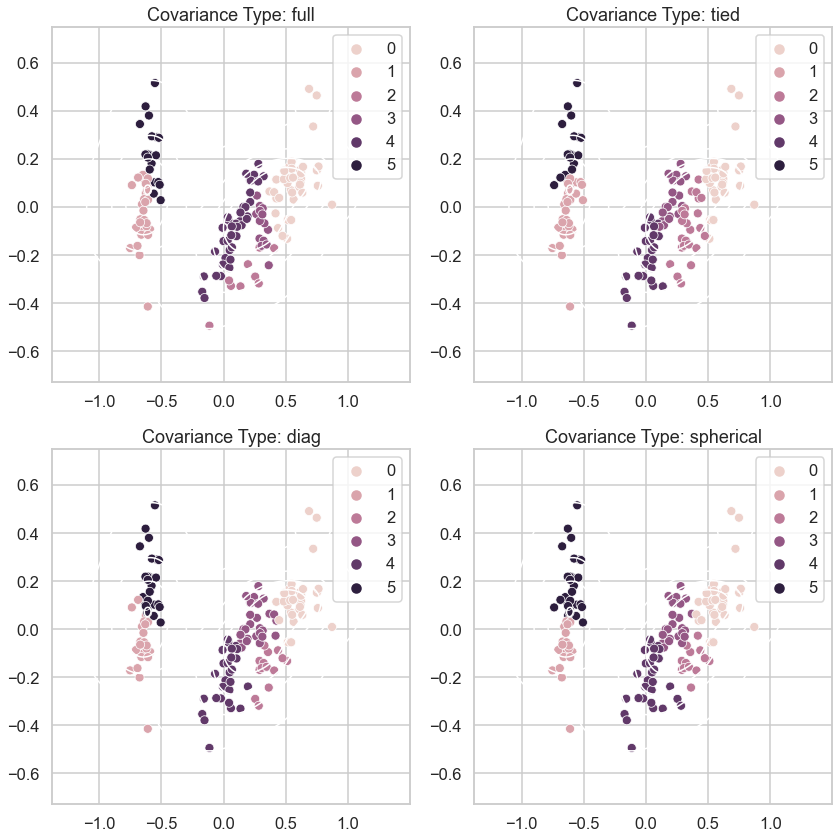

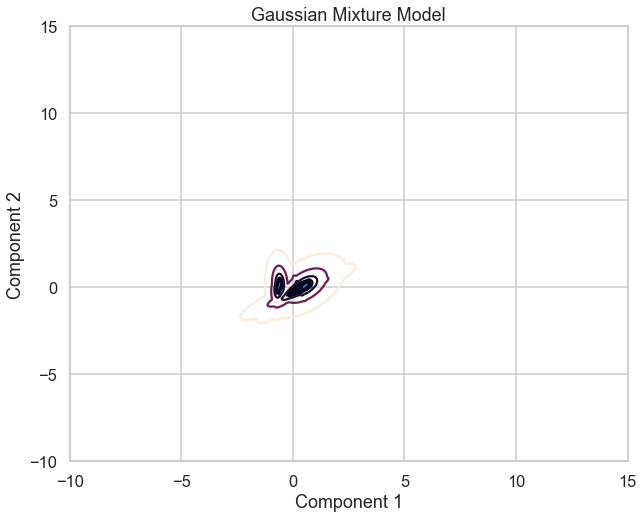

In [23]:
plot_gmm_clusters(normalized_iris, n_clusters=6, covariance_types=('full', 'tied', 'diag', 'spherical'), random_state=42)

## Customer dataset
Repeat all the above on the customer data set 

In [24]:
df = pd.read_csv('/Users/alyashoub/Desktop/Machine Learning/GUC_2350_56_17328_2022-02-22T14_59_49/Customer data.csv')

In [25]:
df.head()

,ID,Sex,Marital status,Age,Education,Income,Occupation,Settlement size
0,100000001,0,0,67,2,124670,1,2
1,100000002,1,1,22,1,150773,1,2
2,100000003,0,0,49,1,89210,0,0
3,100000004,0,0,45,1,171565,1,1
4,100000005,0,0,53,1,149031,1,1


In [26]:
df = pd.read_csv('/Users/alyashoub/Desktop/Machine Learning/GUC_2350_56_17328_2022-02-22T14_59_49/Customer data.csv',usecols=['Age','Income'])
df.head()

,Age,Income
0,67,124670
1,22,150773
2,49,89210
3,45,171565
4,53,149031


In [27]:
customer = df.iloc[:, [0, 1]].values
customer

array([[    67, 124670],
       [    22, 150773],
       [    49,  89210],
       ...,
       [    31,  86400],
       [    24,  97968],
       [    25,  68416]])

In [28]:
scaler = MinMaxScaler()
scaler.fit(df)
customer_data= scaler.transform(df)
customer_data = pd.DataFrame(customer_data, columns=df.columns)
customer_data.head()

,Age,Income
0,0.844828,0.324781
1,0.068966,0.420210
2,0.534483,0.195144
3,0.465517,0.496223
4,0.603448,0.413842


In [29]:
normalized_customer = customer_data.iloc[:, [0, 1]].values
normalized_customer

array([[0.84482759, 0.32478101],
       [0.06896552, 0.42021043],
       [0.53448276, 0.19514353],
       ...,
       [0.22413793, 0.18487051],
       [0.10344828, 0.22716172],
       [0.12068966, 0.11912317]])

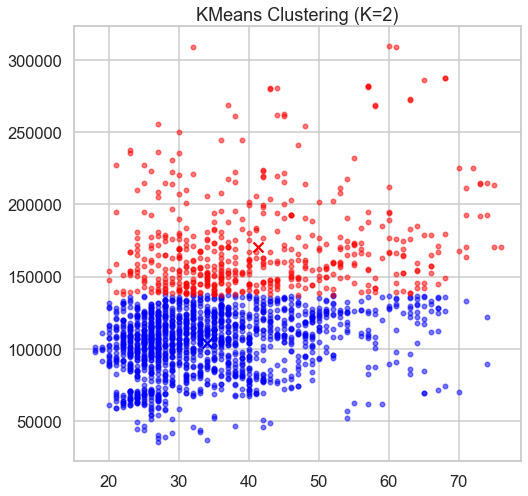

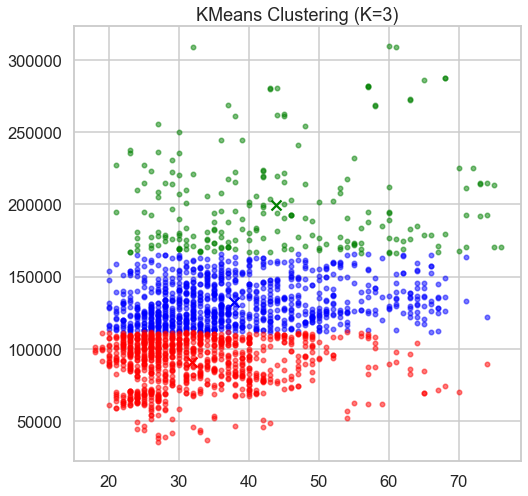

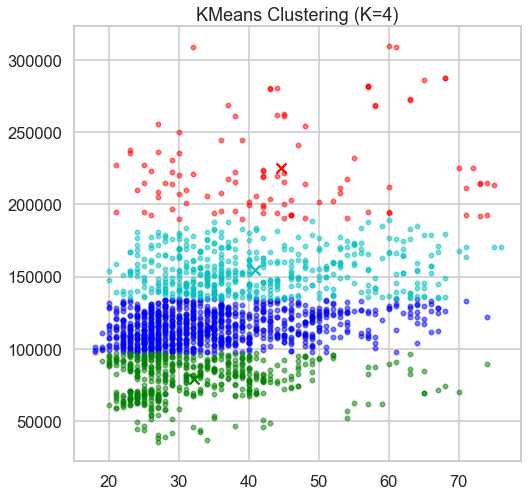

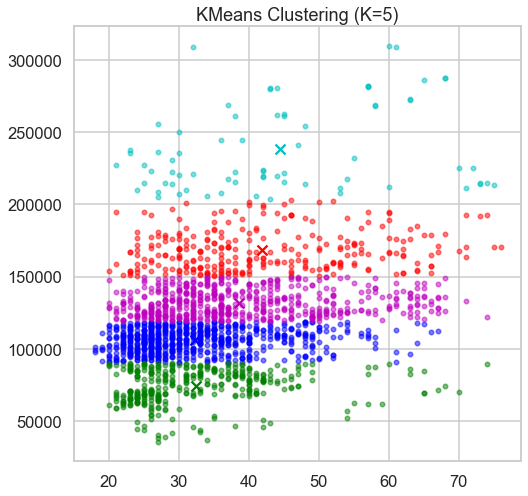

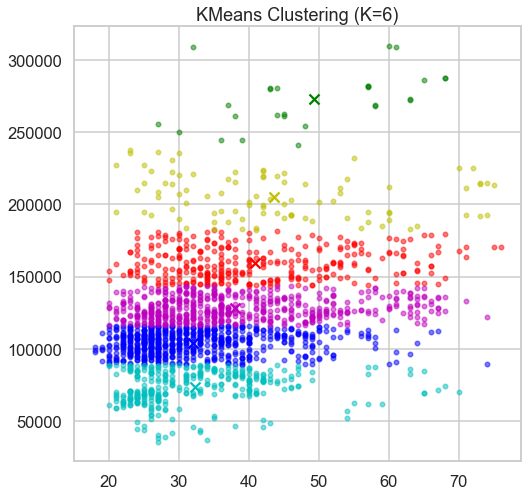

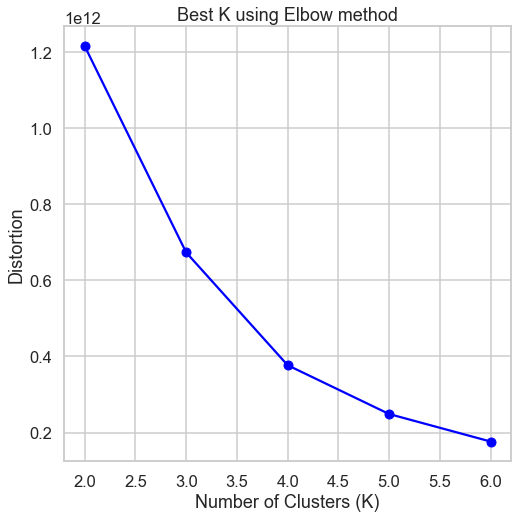

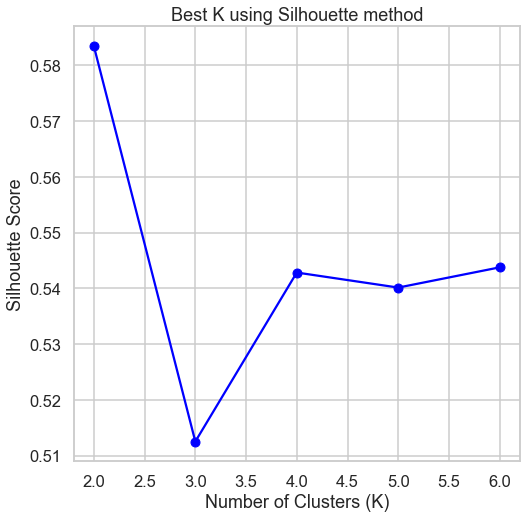

Best value of K: 2


2

In [30]:
k_means(customer)

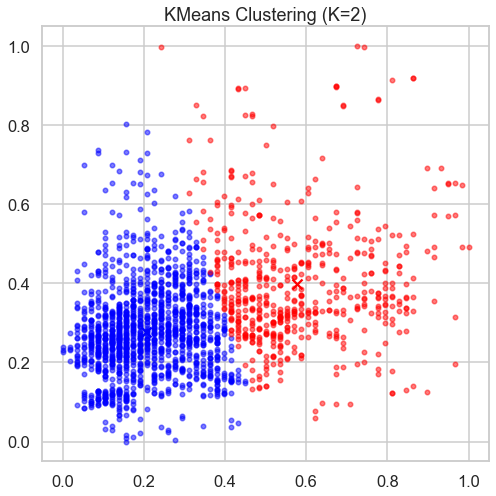

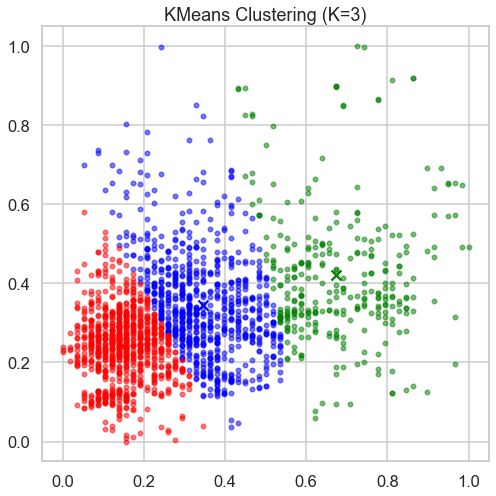

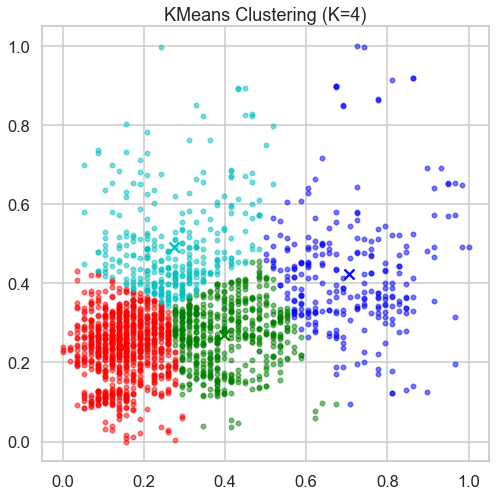

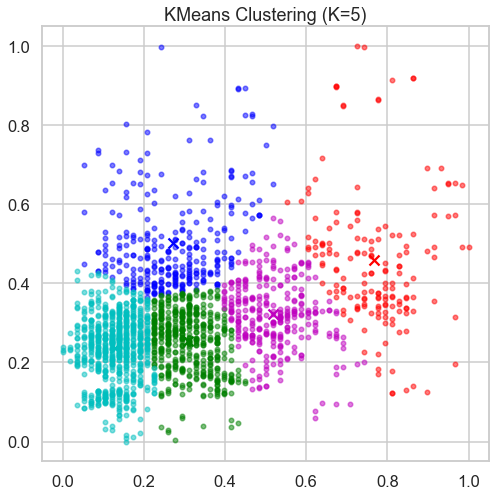

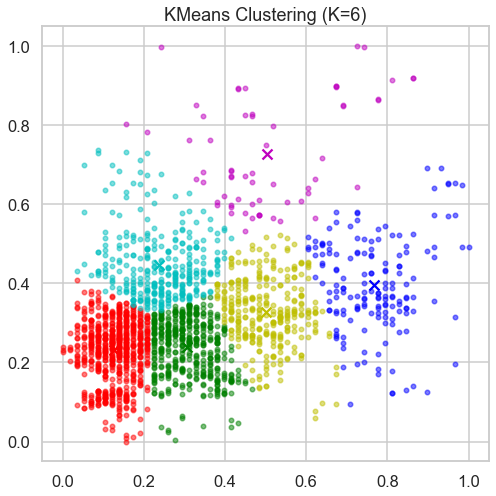

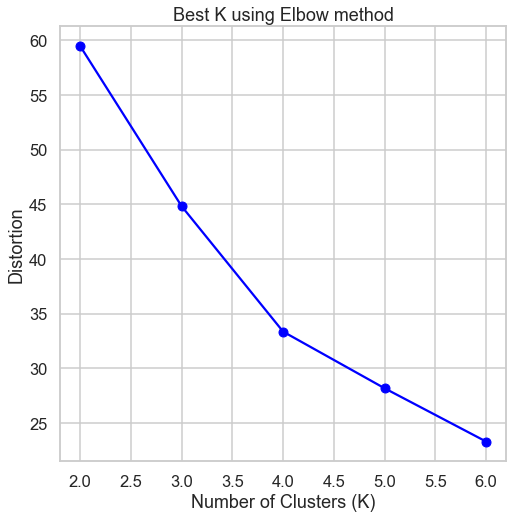

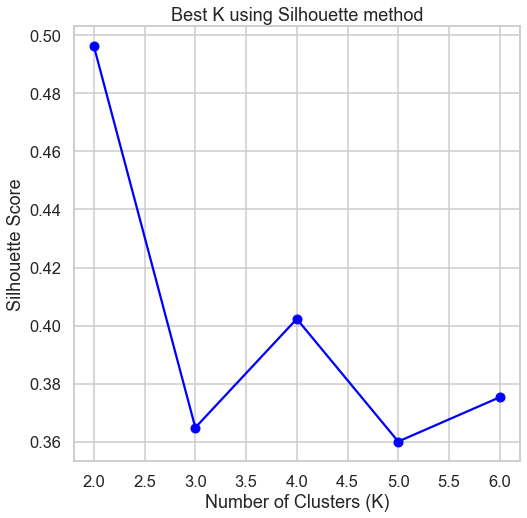

Best value of K: 2


2

In [31]:
k_means(normalized_customer)

Affinity: euclidean, Linkage: average, Distance Threshold: None, Silhouette Score: 0.52


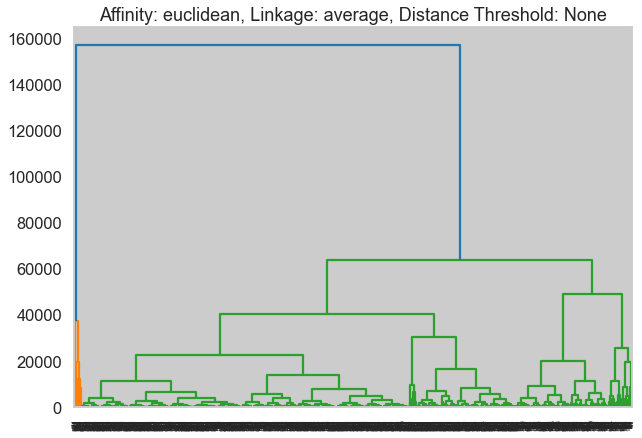

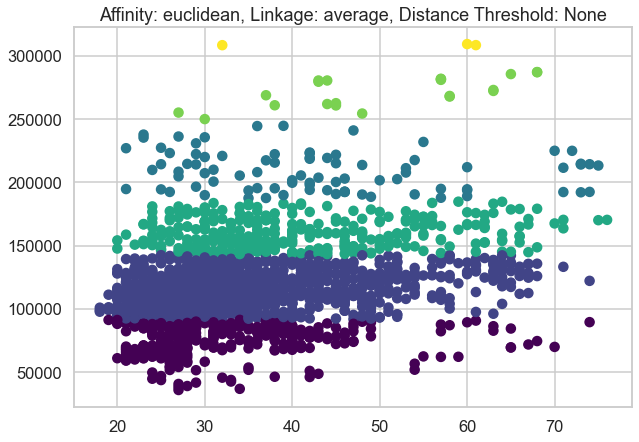

Affinity: euclidean, Linkage: average, Distance Threshold: 1, Silhouette Score: 0.00


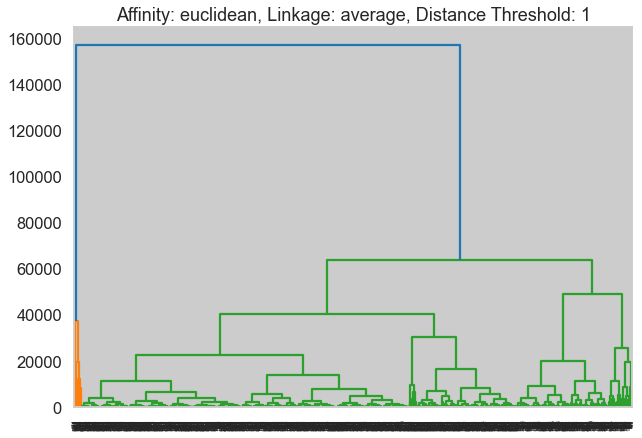

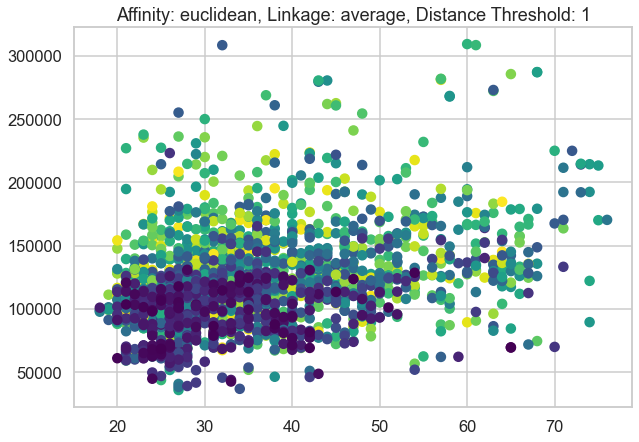

Affinity: euclidean, Linkage: average, Distance Threshold: 2, Silhouette Score: 0.01


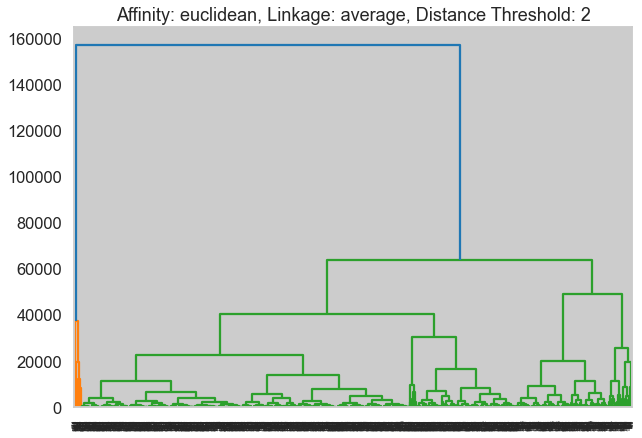

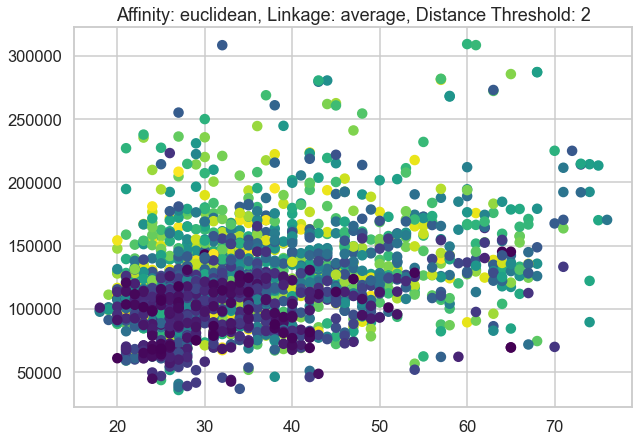

Affinity: euclidean, Linkage: average, Distance Threshold: 3, Silhouette Score: 0.01


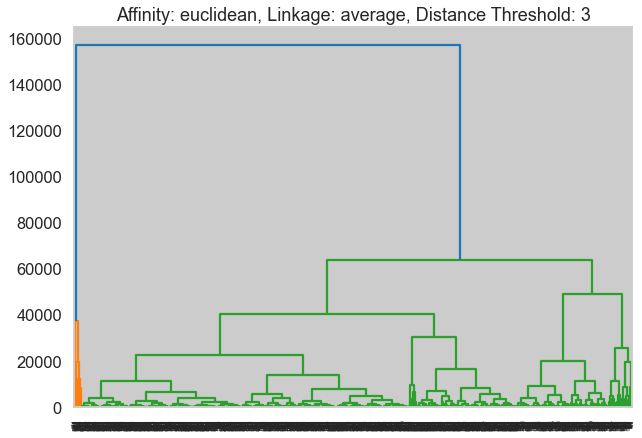

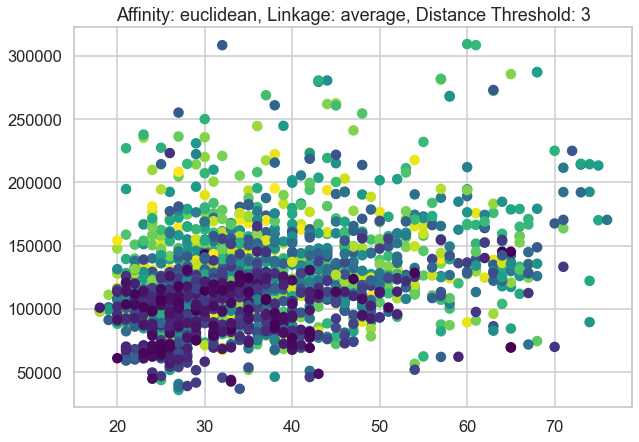

Affinity: euclidean, Linkage: single, Distance Threshold: None, Silhouette Score: 0.68


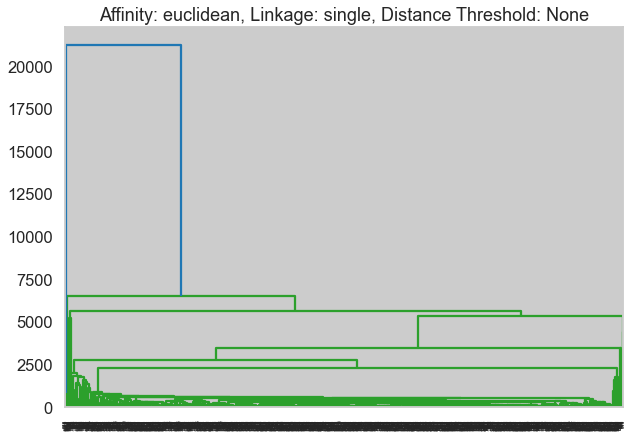

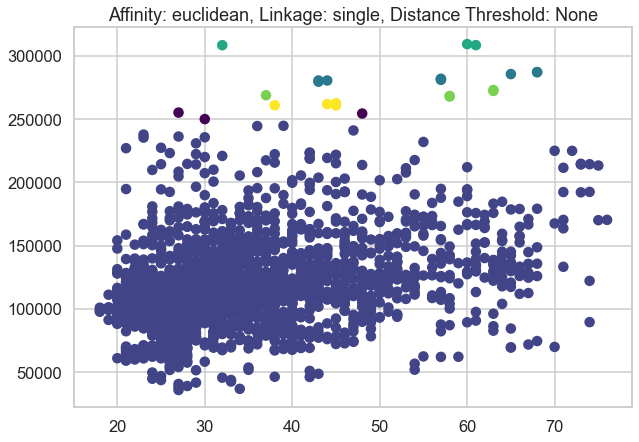

Affinity: euclidean, Linkage: single, Distance Threshold: 1, Silhouette Score: 0.00


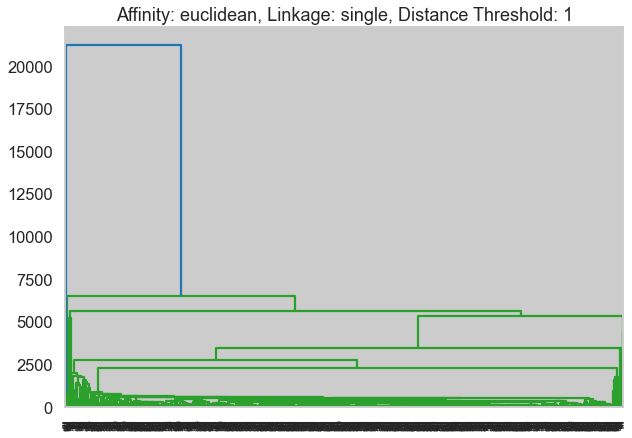

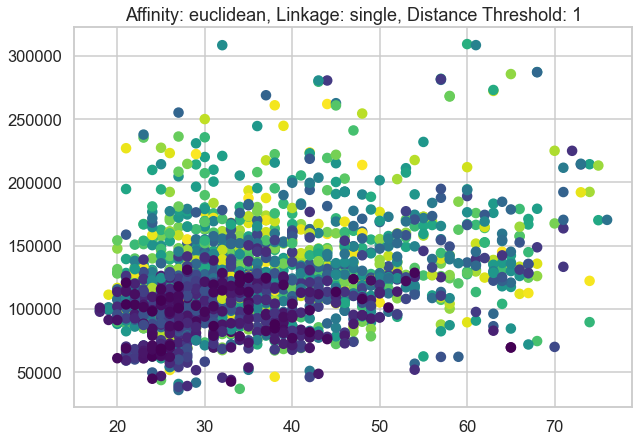

Affinity: euclidean, Linkage: single, Distance Threshold: 2, Silhouette Score: 0.01


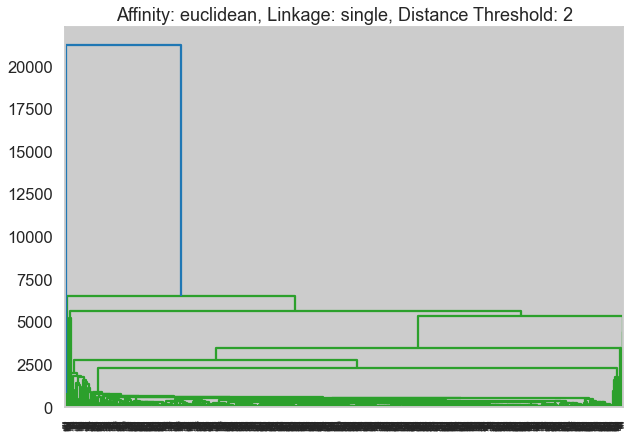

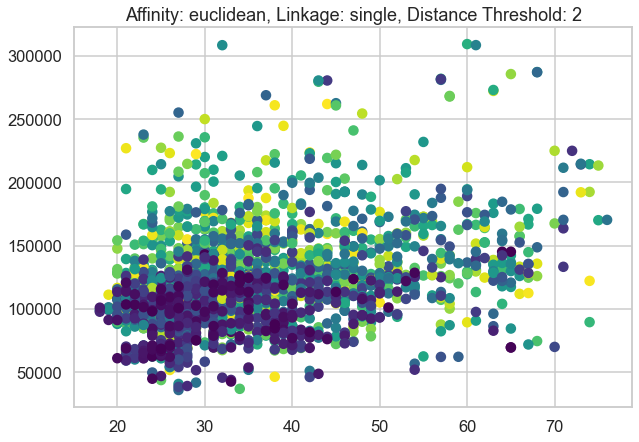

Affinity: euclidean, Linkage: single, Distance Threshold: 3, Silhouette Score: 0.01


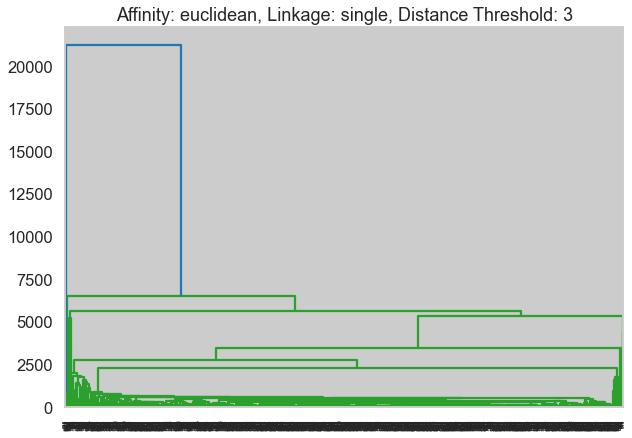

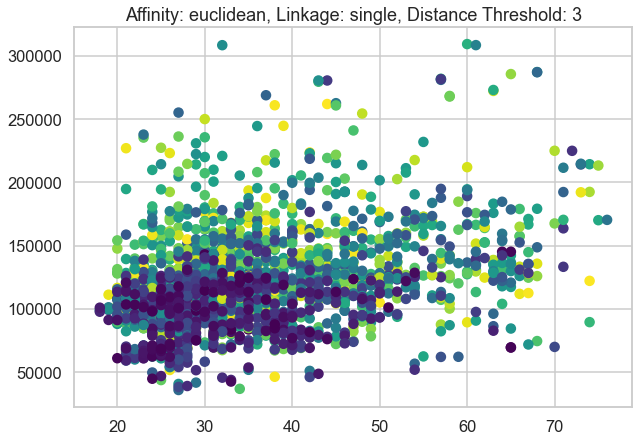

Affinity: cityblock, Linkage: average, Distance Threshold: None, Silhouette Score: 0.52


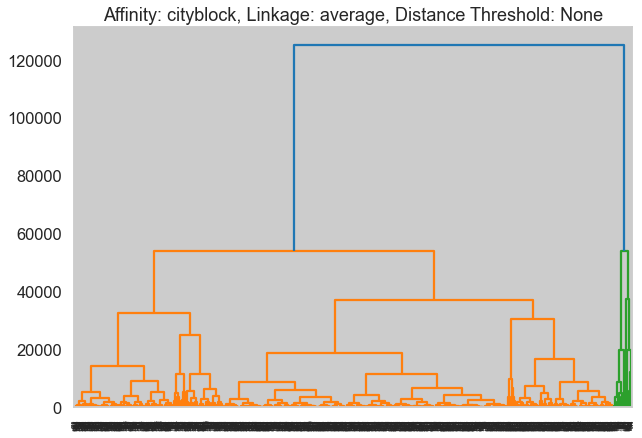

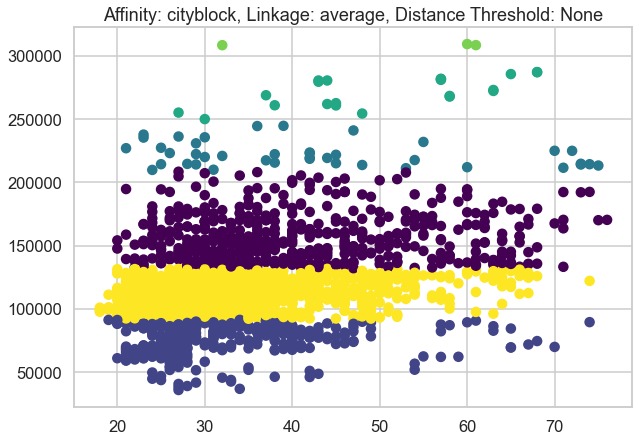

Affinity: cityblock, Linkage: average, Distance Threshold: 1, Silhouette Score: 0.00


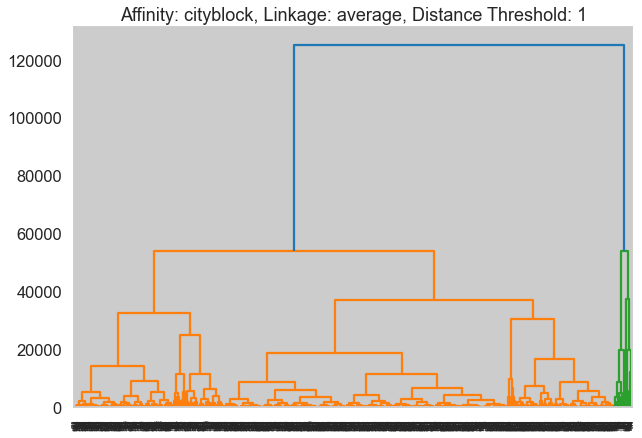

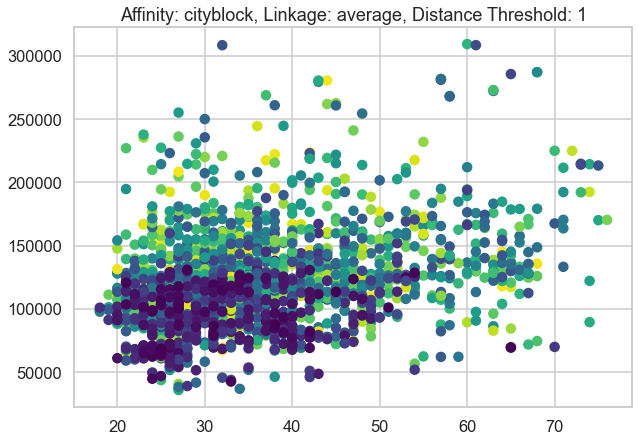

Affinity: cityblock, Linkage: average, Distance Threshold: 2, Silhouette Score: 0.01


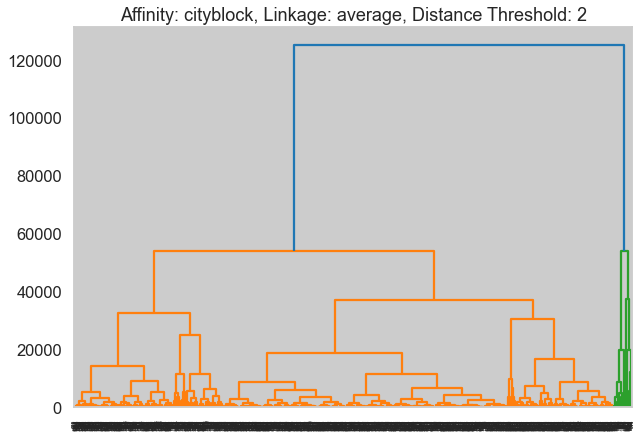

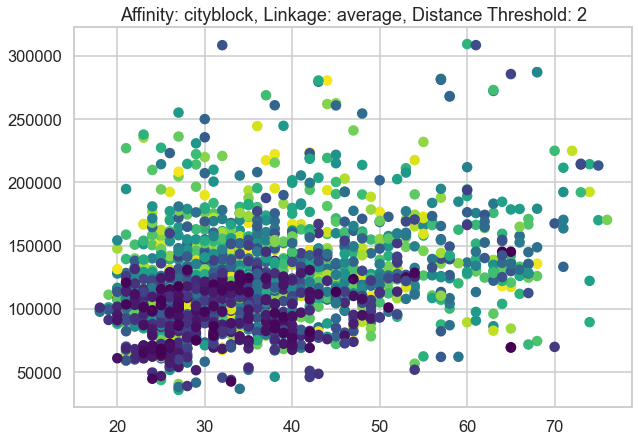

Affinity: cityblock, Linkage: average, Distance Threshold: 3, Silhouette Score: 0.01


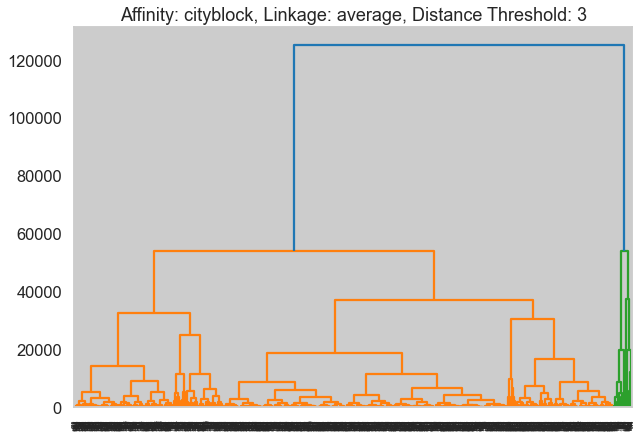

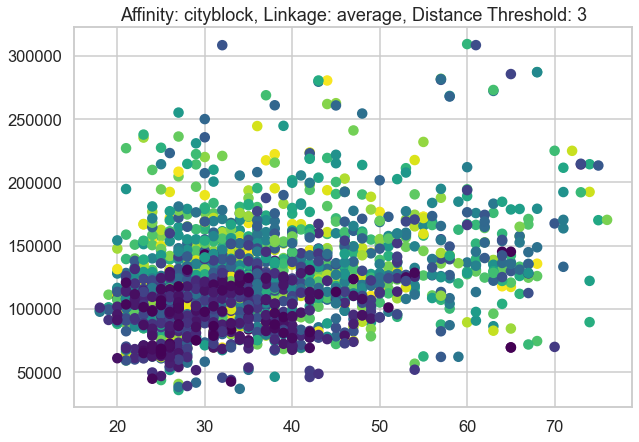

Affinity: cityblock, Linkage: single, Distance Threshold: None, Silhouette Score: 0.68


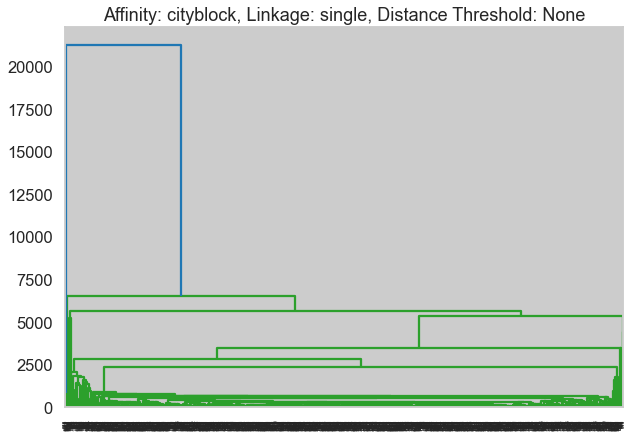

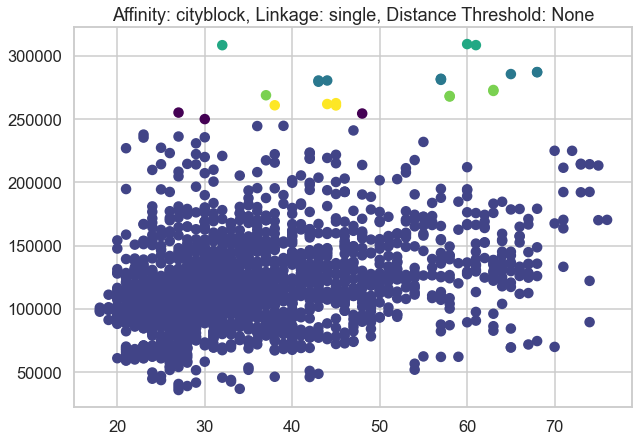

Affinity: cityblock, Linkage: single, Distance Threshold: 1, Silhouette Score: 0.00


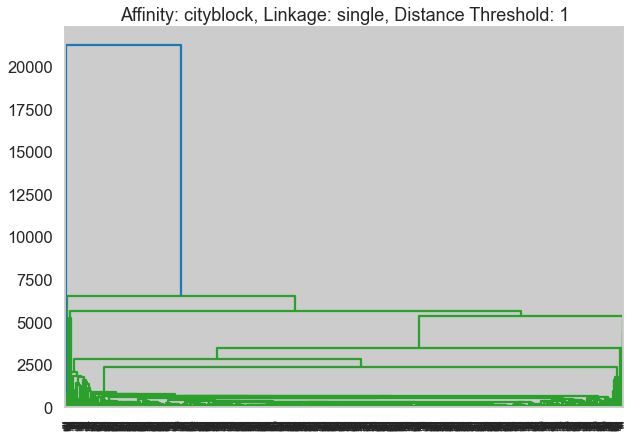

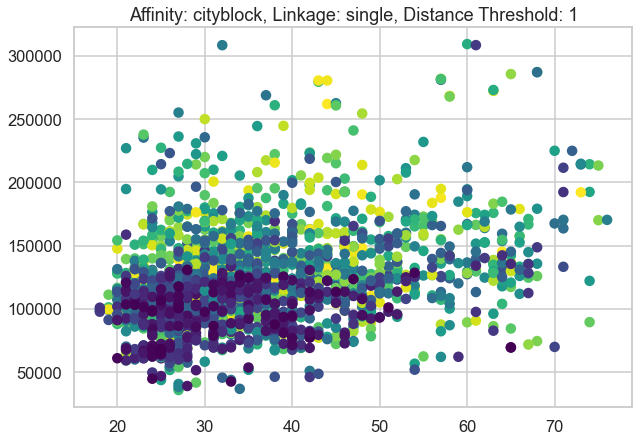

Affinity: cityblock, Linkage: single, Distance Threshold: 2, Silhouette Score: 0.01


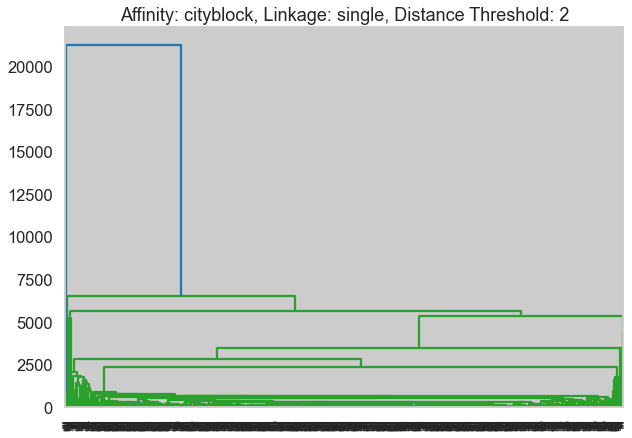

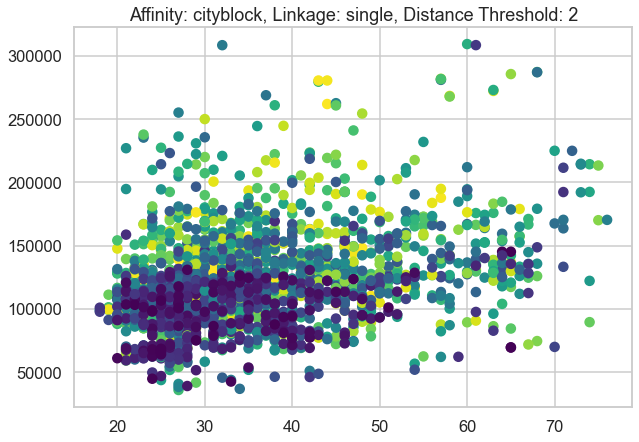

Affinity: cityblock, Linkage: single, Distance Threshold: 3, Silhouette Score: 0.01


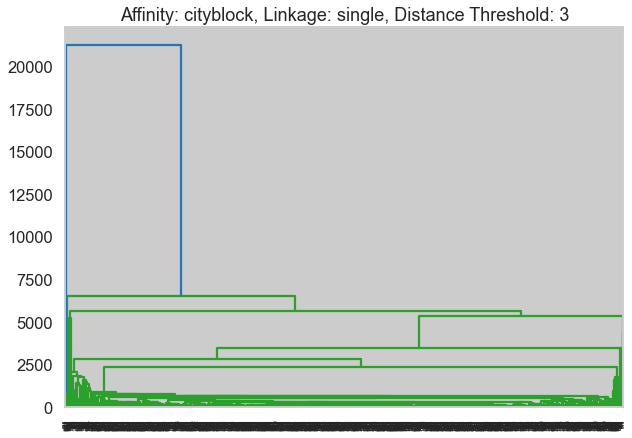

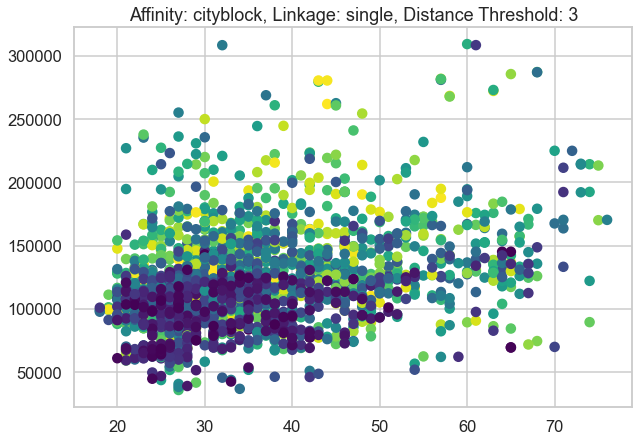

Affinity: cosine, Linkage: average, Distance Threshold: None, Silhouette Score: -0.11


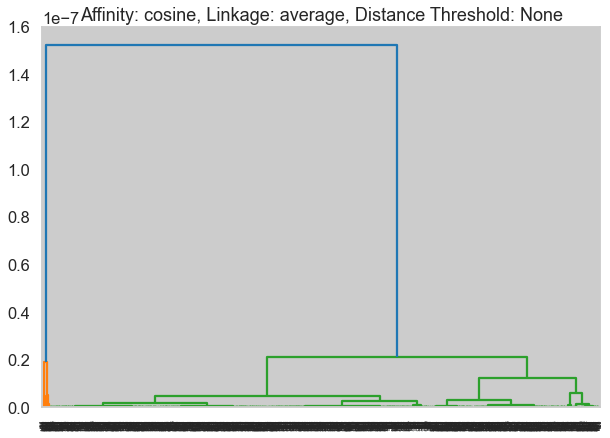

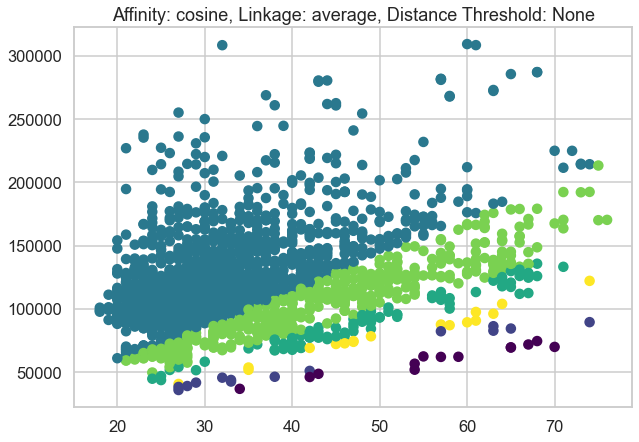

Affinity: cosine, Linkage: average, Distance Threshold: 1, Silhouette Score cannot be computed with only one label.


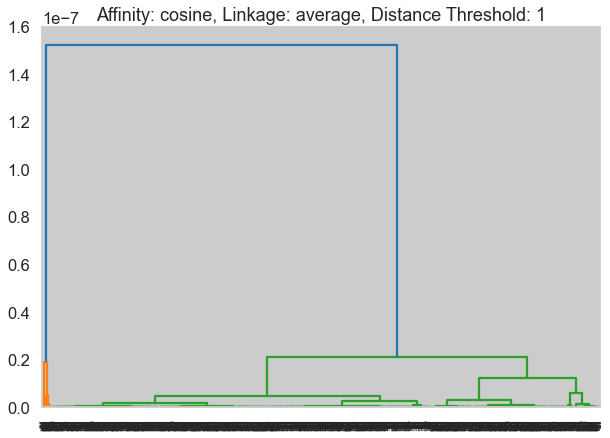

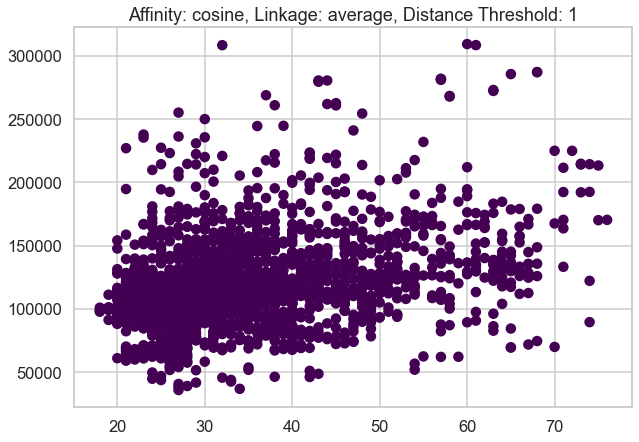

Affinity: cosine, Linkage: average, Distance Threshold: 2, Silhouette Score cannot be computed with only one label.


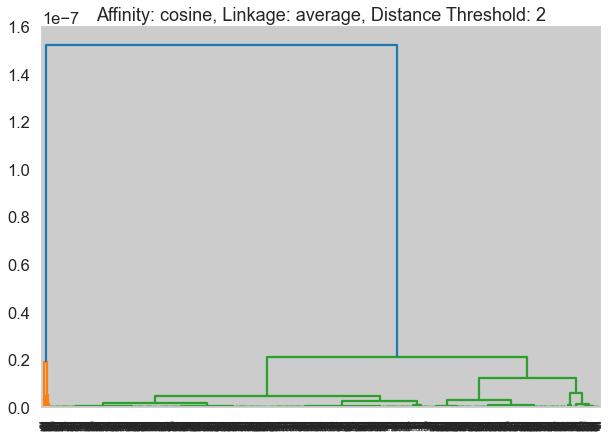

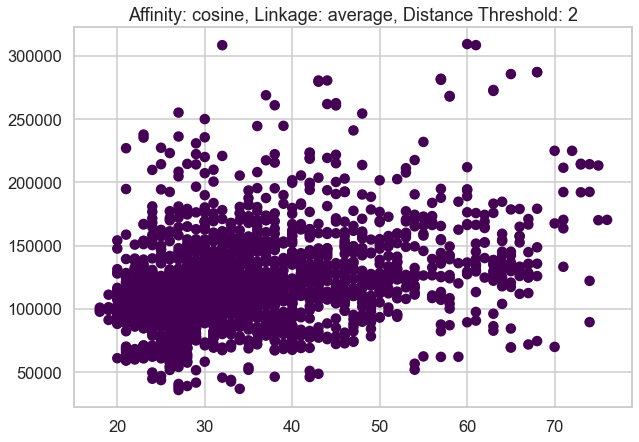

Affinity: cosine, Linkage: average, Distance Threshold: 3, Silhouette Score cannot be computed with only one label.


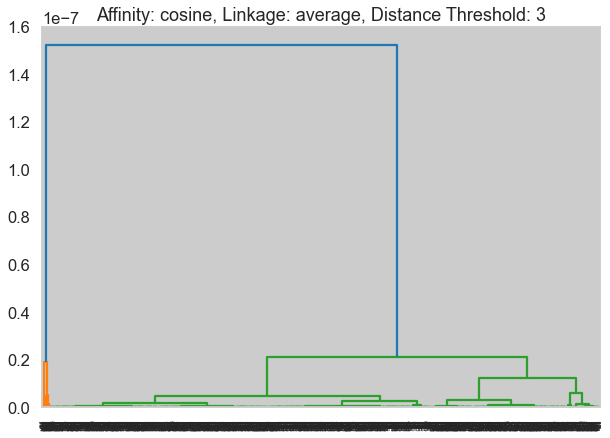

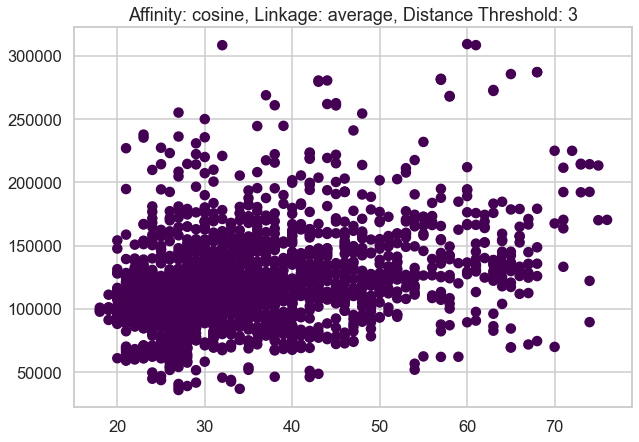

Affinity: cosine, Linkage: single, Distance Threshold: None, Silhouette Score: 0.12


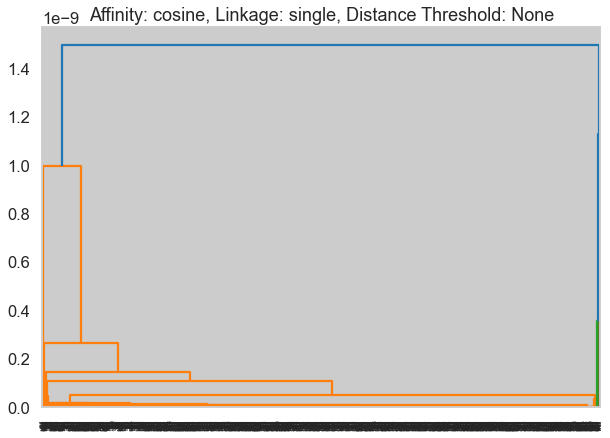

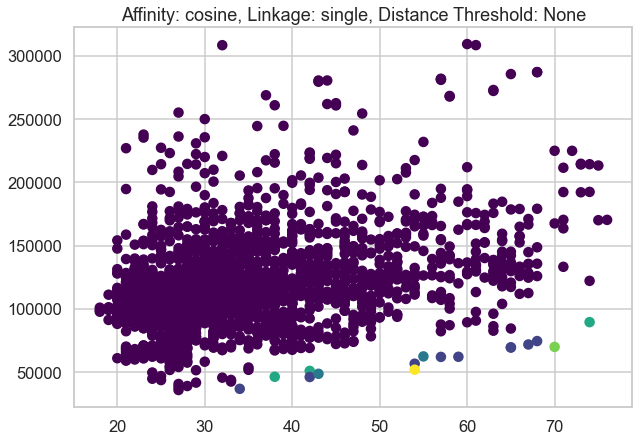

Affinity: cosine, Linkage: single, Distance Threshold: 1, Silhouette Score cannot be computed with only one label.


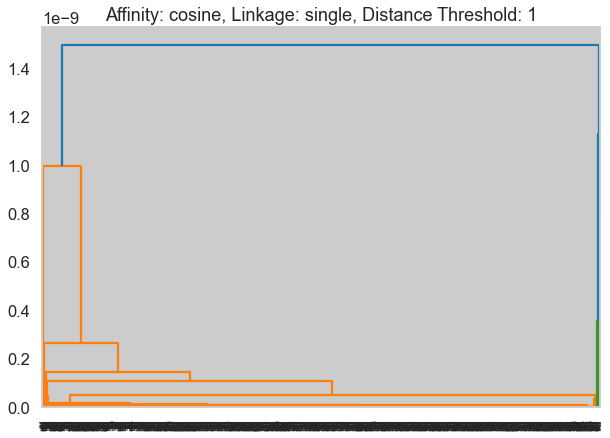

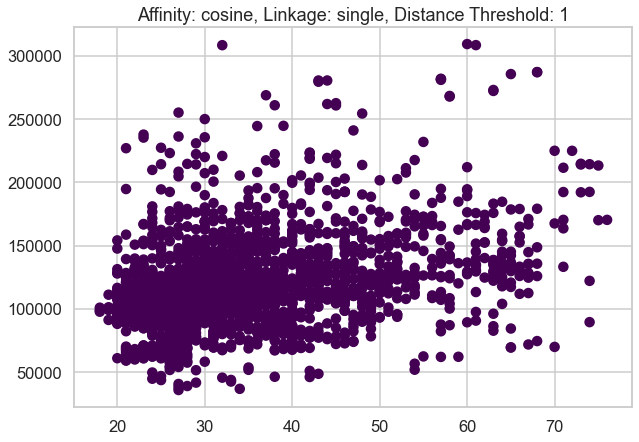

Affinity: cosine, Linkage: single, Distance Threshold: 2, Silhouette Score cannot be computed with only one label.


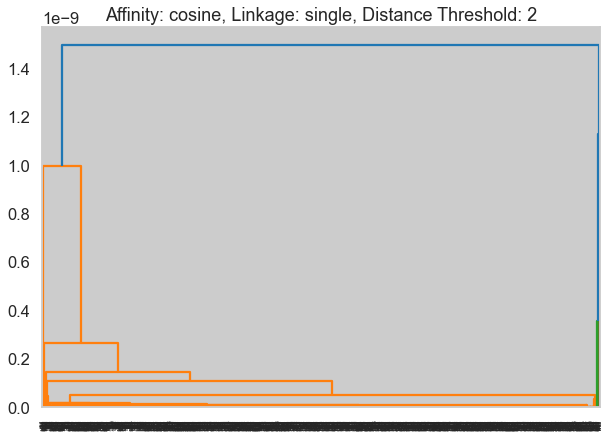

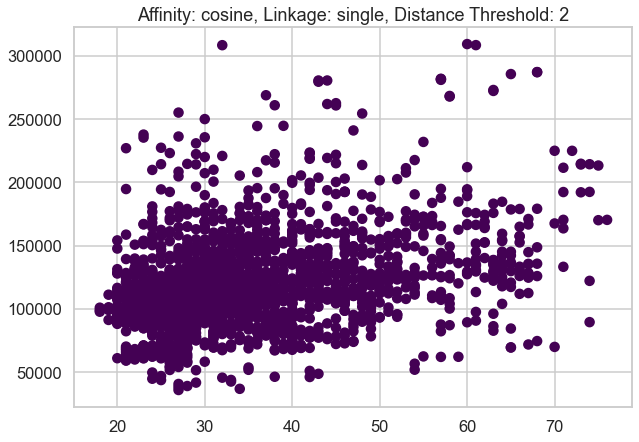

Affinity: cosine, Linkage: single, Distance Threshold: 3, Silhouette Score cannot be computed with only one label.


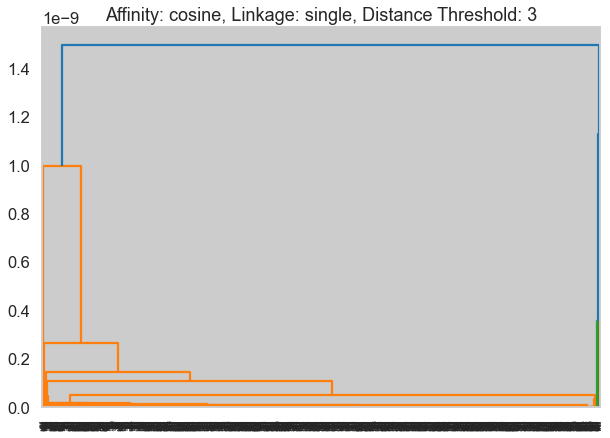

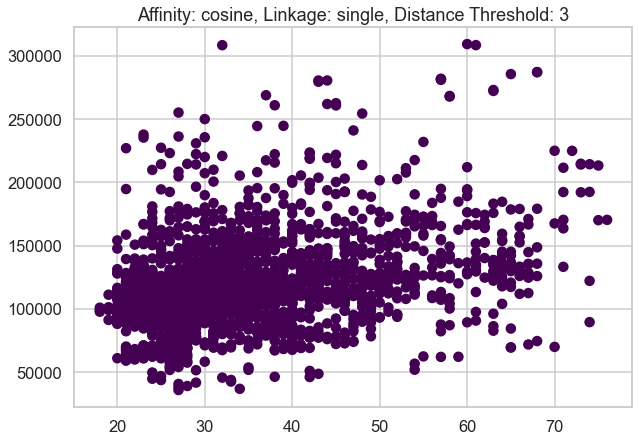

Best Silhouette Score: 0.68
Best Affinity: euclidean
Best Linkage: single
Best Distance Threshold: None


In [32]:
agglomerative_clustering(customer, affinities, linkages, dist_thresholds)

Affinity: euclidean, Linkage: average, Distance Threshold: None, Silhouette Score: 0.44


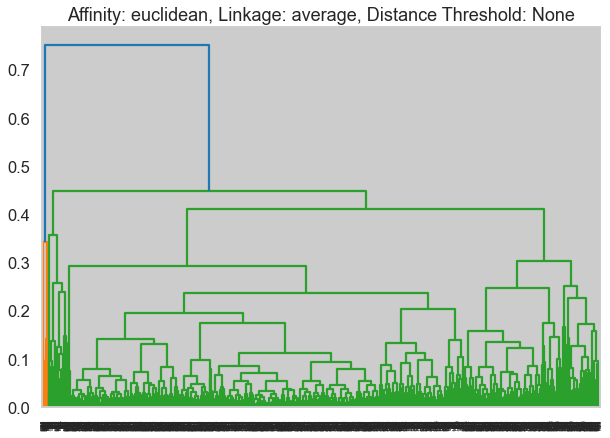

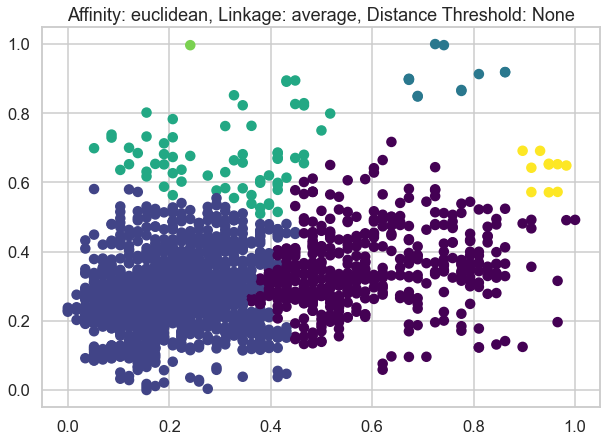

Affinity: euclidean, Linkage: average, Distance Threshold: 1, Silhouette Score cannot be computed with only one label.


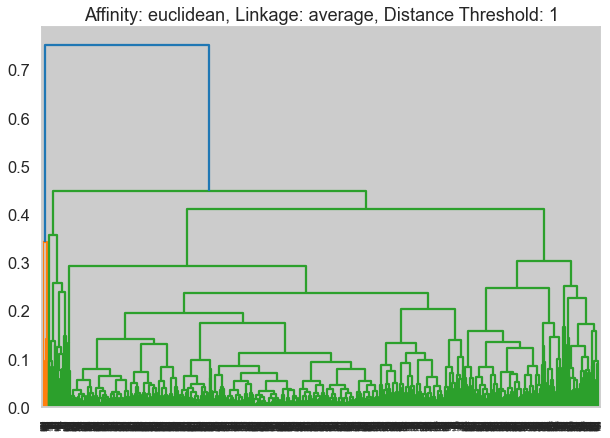

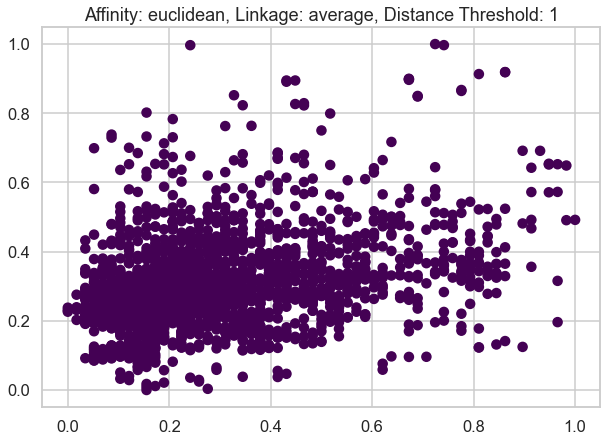

Affinity: euclidean, Linkage: average, Distance Threshold: 2, Silhouette Score cannot be computed with only one label.


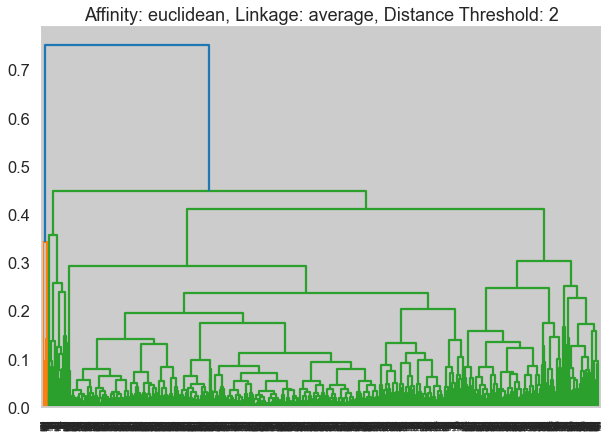

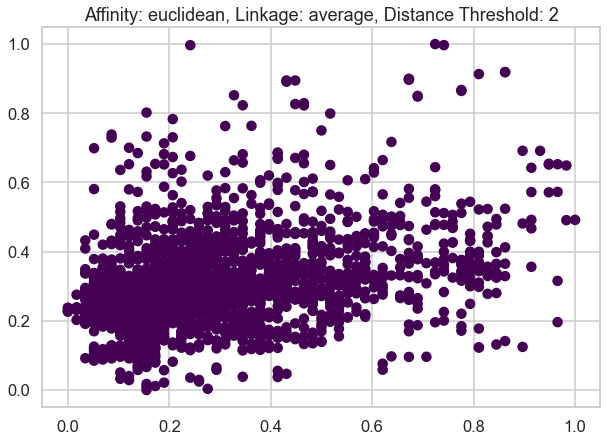

Affinity: euclidean, Linkage: average, Distance Threshold: 3, Silhouette Score cannot be computed with only one label.


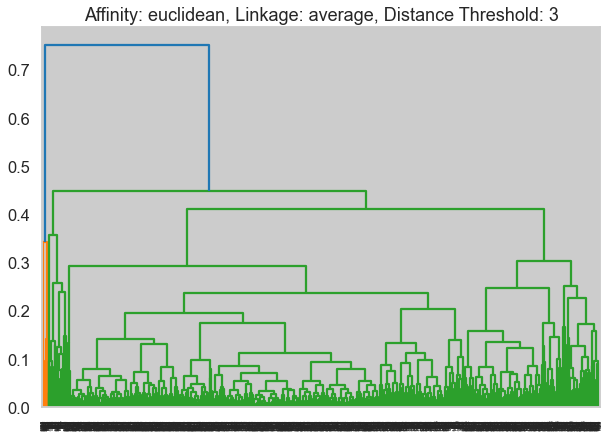

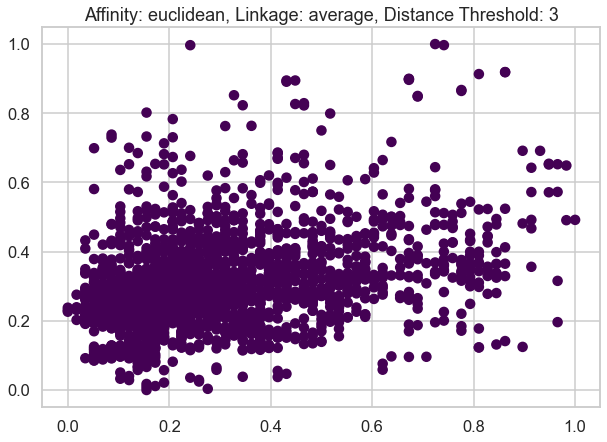

Affinity: euclidean, Linkage: single, Distance Threshold: None, Silhouette Score: 0.47


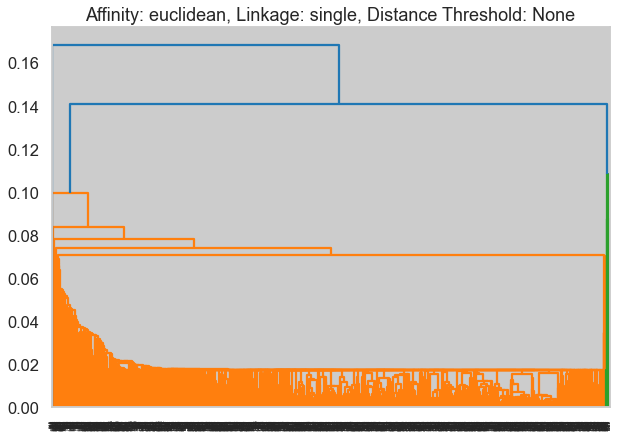

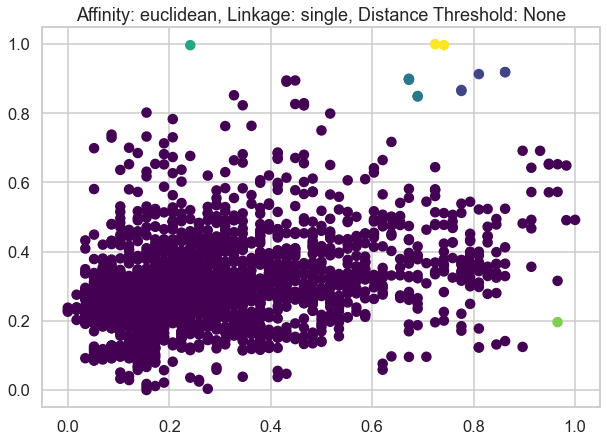

Affinity: euclidean, Linkage: single, Distance Threshold: 1, Silhouette Score cannot be computed with only one label.


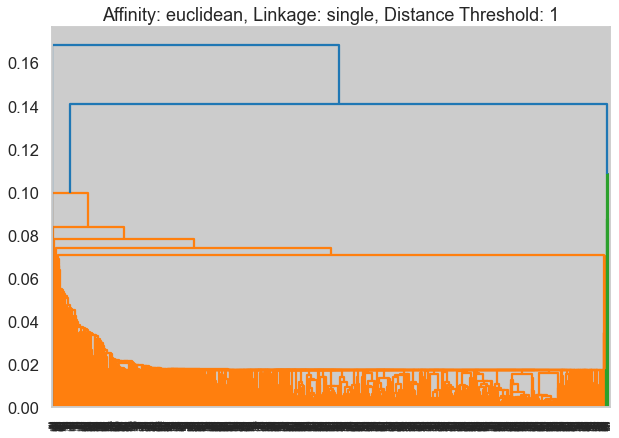

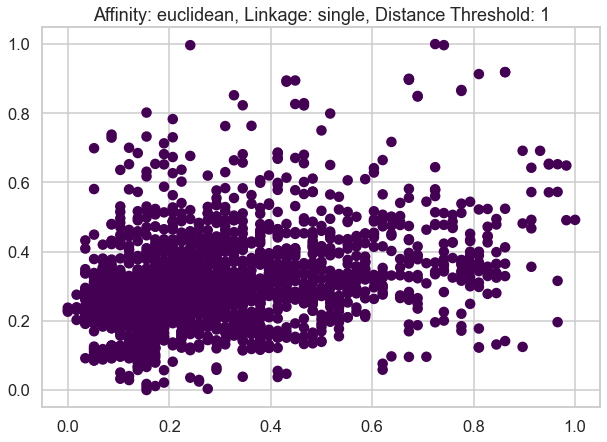

Affinity: euclidean, Linkage: single, Distance Threshold: 2, Silhouette Score cannot be computed with only one label.


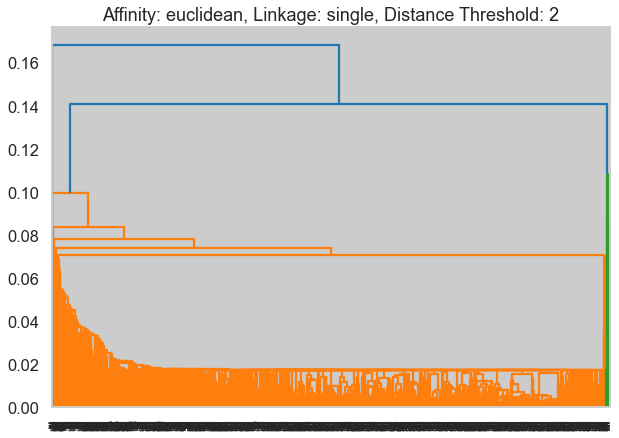

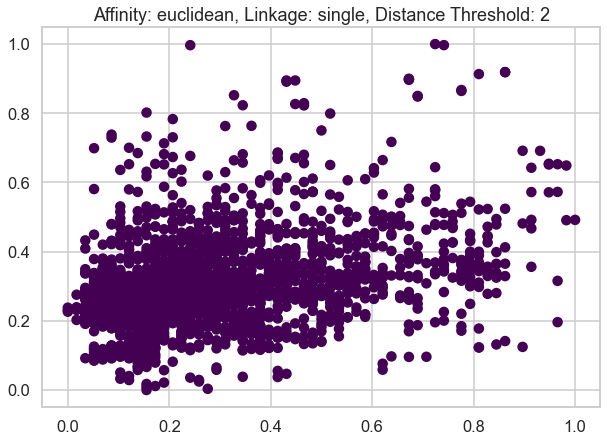

Affinity: euclidean, Linkage: single, Distance Threshold: 3, Silhouette Score cannot be computed with only one label.


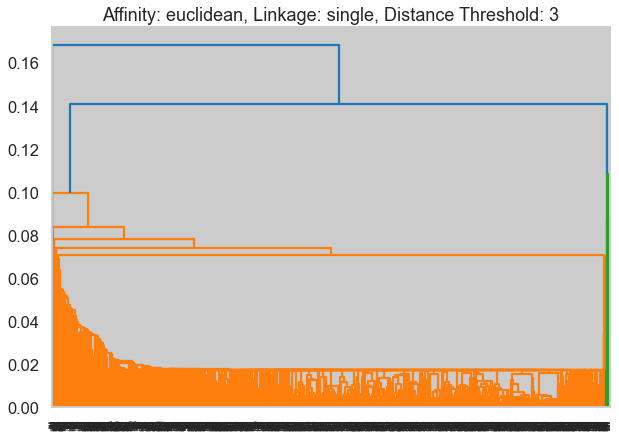

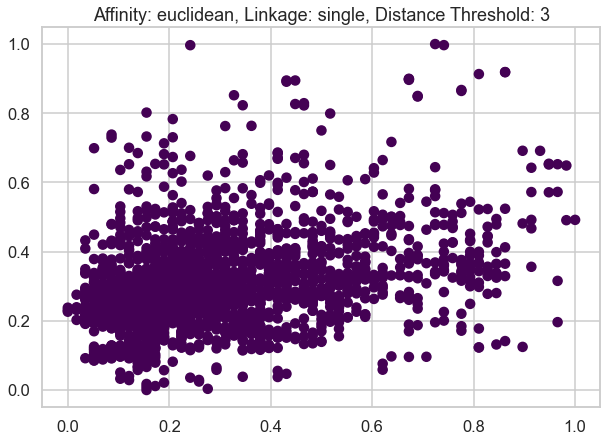

Affinity: cityblock, Linkage: average, Distance Threshold: None, Silhouette Score: 0.44


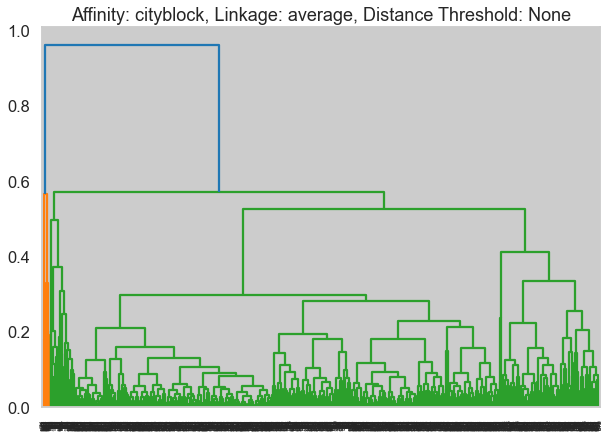

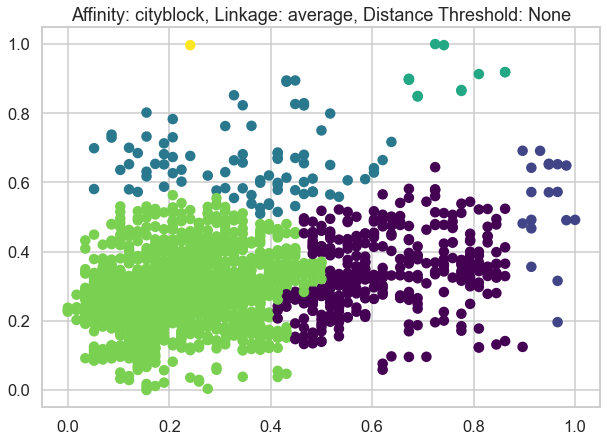

Affinity: cityblock, Linkage: average, Distance Threshold: 1, Silhouette Score cannot be computed with only one label.


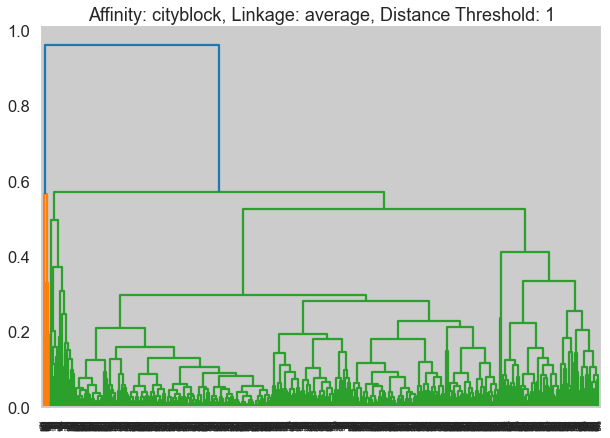

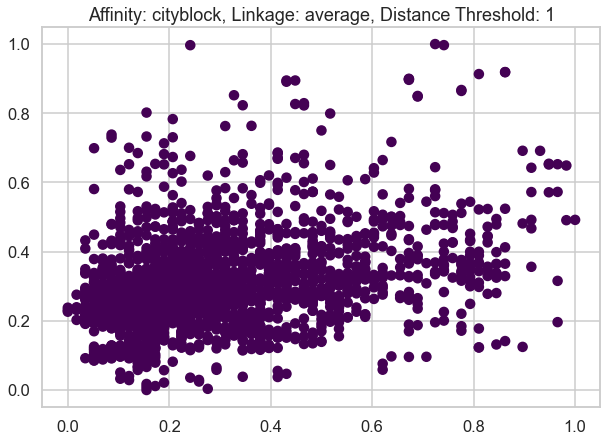

Affinity: cityblock, Linkage: average, Distance Threshold: 2, Silhouette Score cannot be computed with only one label.


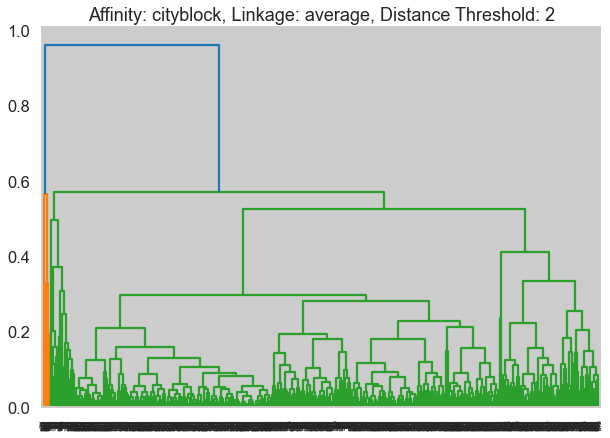

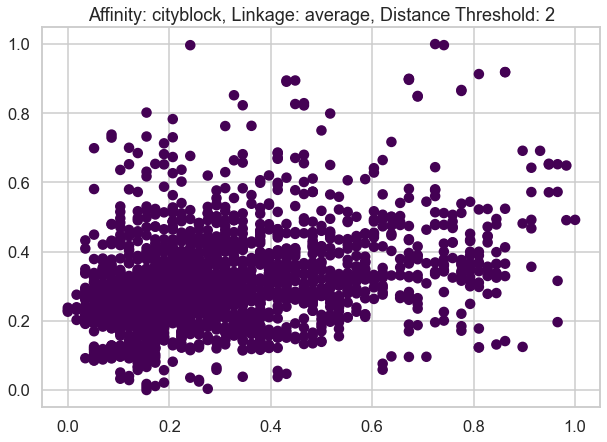

Affinity: cityblock, Linkage: average, Distance Threshold: 3, Silhouette Score cannot be computed with only one label.


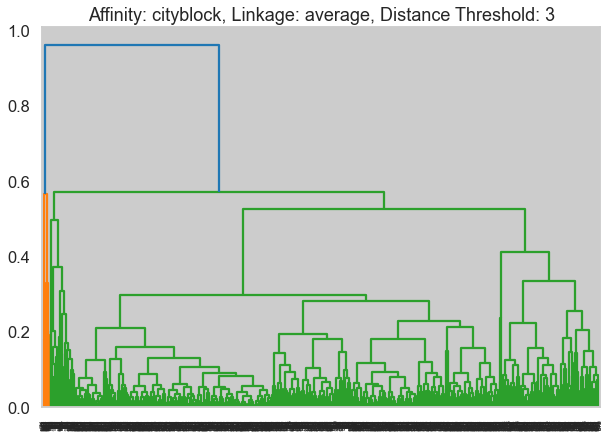

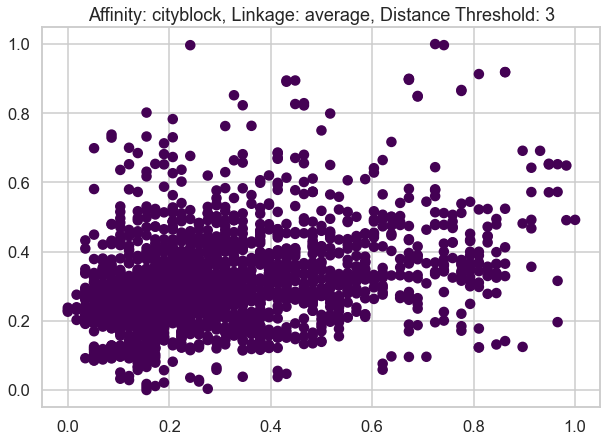

Affinity: cityblock, Linkage: single, Distance Threshold: None, Silhouette Score: 0.43


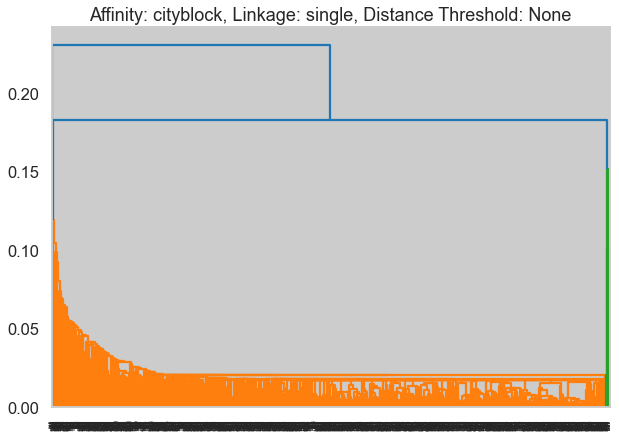

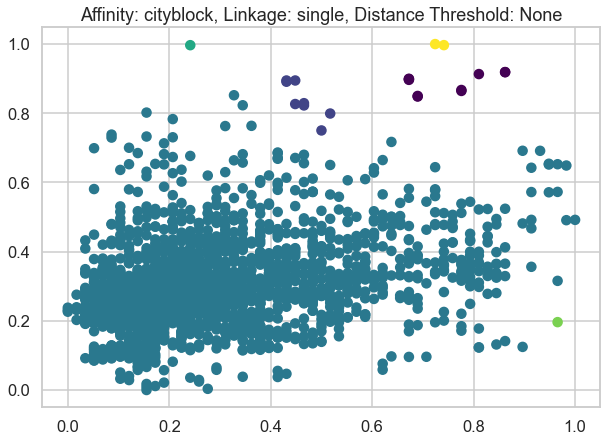

Affinity: cityblock, Linkage: single, Distance Threshold: 1, Silhouette Score cannot be computed with only one label.


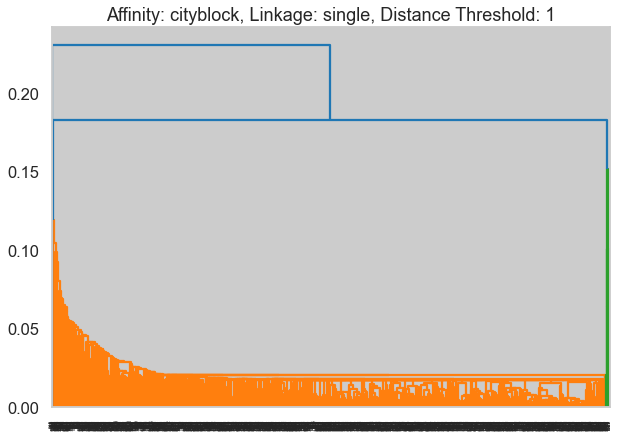

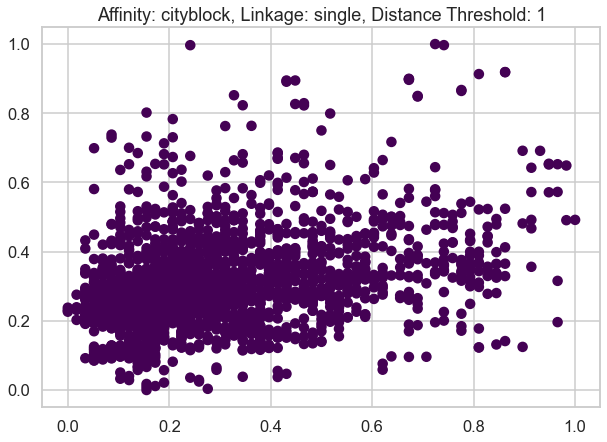

Affinity: cityblock, Linkage: single, Distance Threshold: 2, Silhouette Score cannot be computed with only one label.


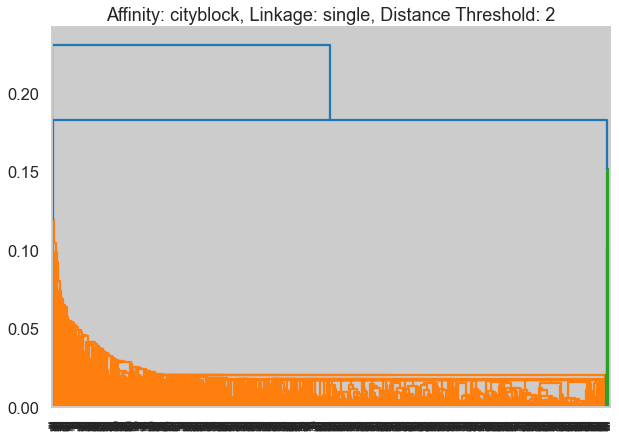

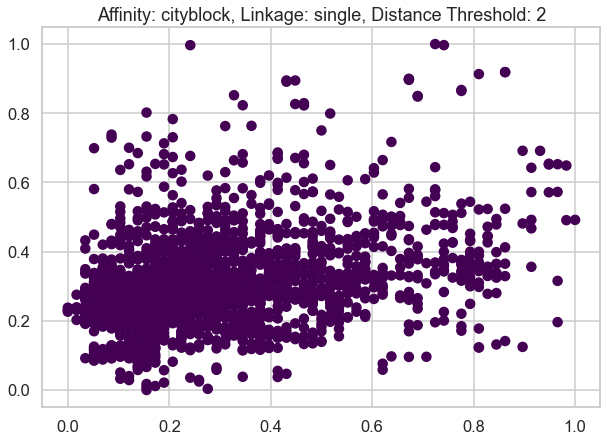

Affinity: cityblock, Linkage: single, Distance Threshold: 3, Silhouette Score cannot be computed with only one label.


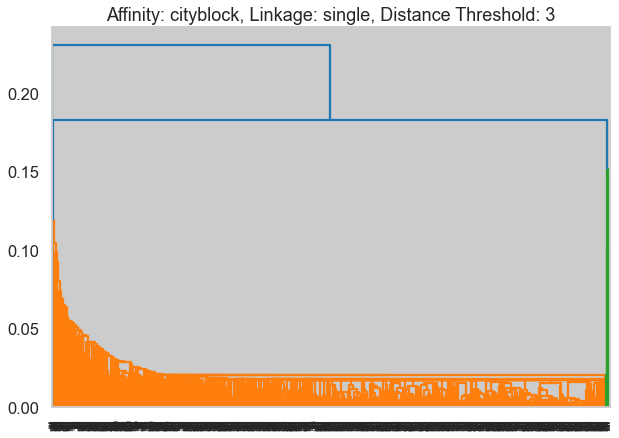

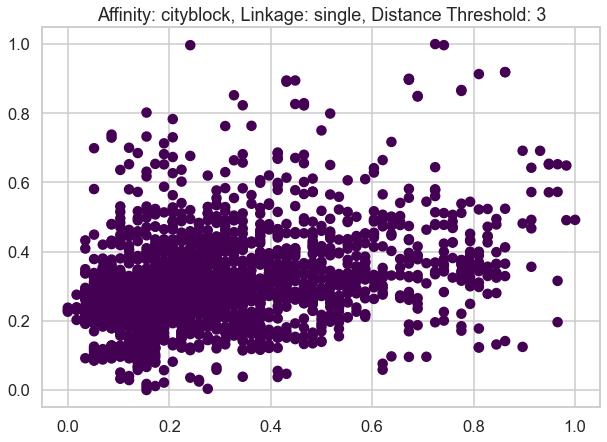

Affinity: cosine, Linkage: average, Distance Threshold: None, Silhouette Score: 0.03


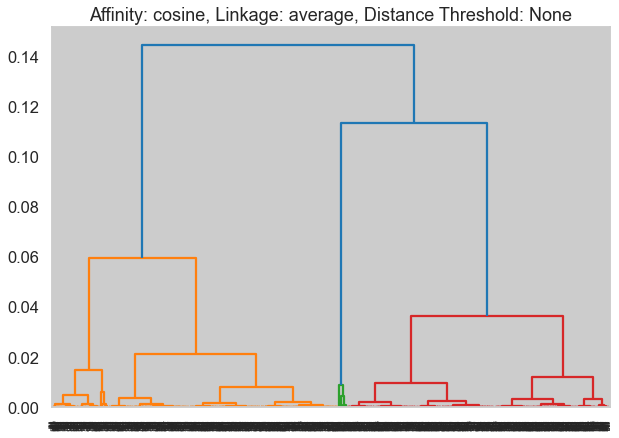

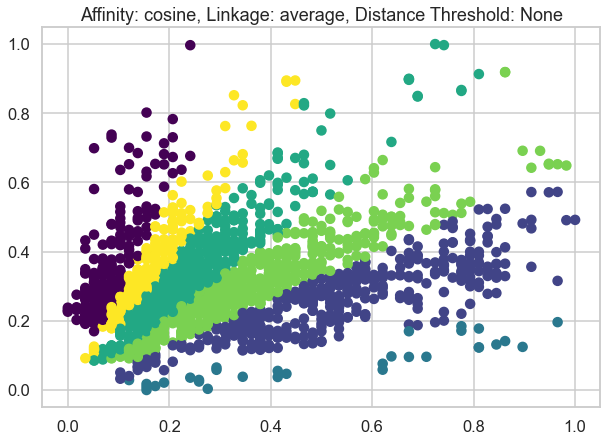

Affinity: cosine, Linkage: average, Distance Threshold: 1, Silhouette Score cannot be computed with only one label.


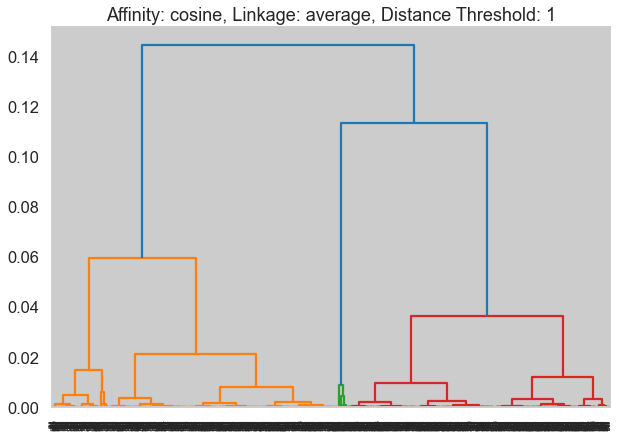

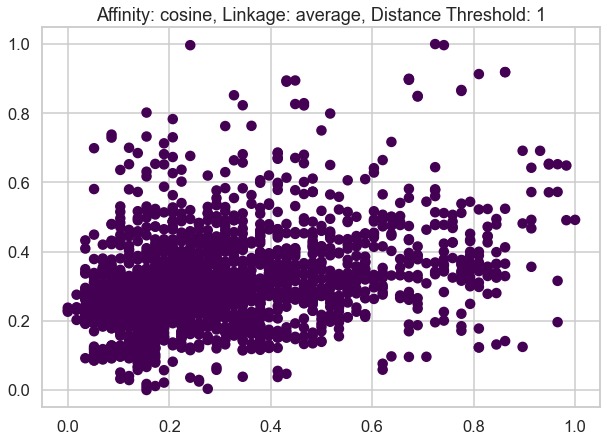

Affinity: cosine, Linkage: average, Distance Threshold: 2, Silhouette Score cannot be computed with only one label.


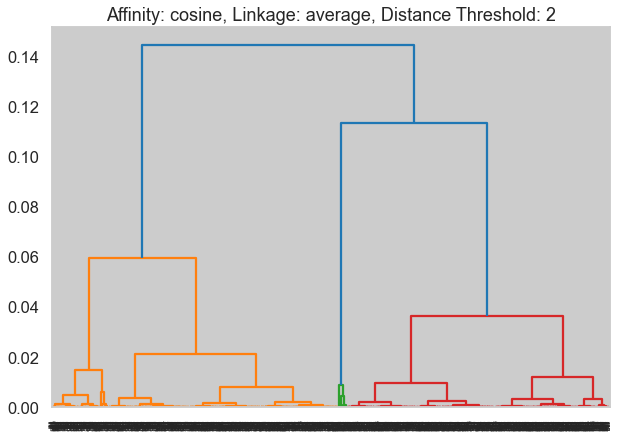

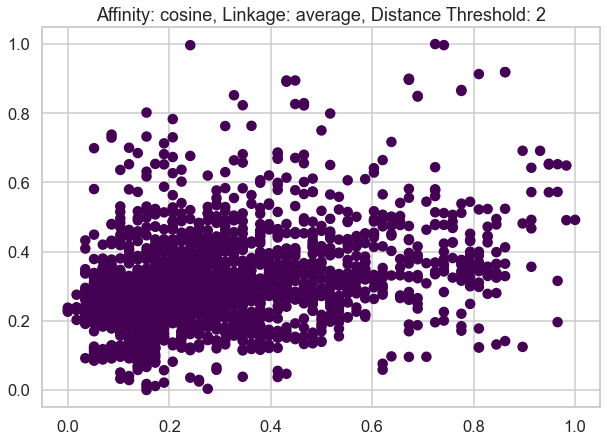

Affinity: cosine, Linkage: average, Distance Threshold: 3, Silhouette Score cannot be computed with only one label.


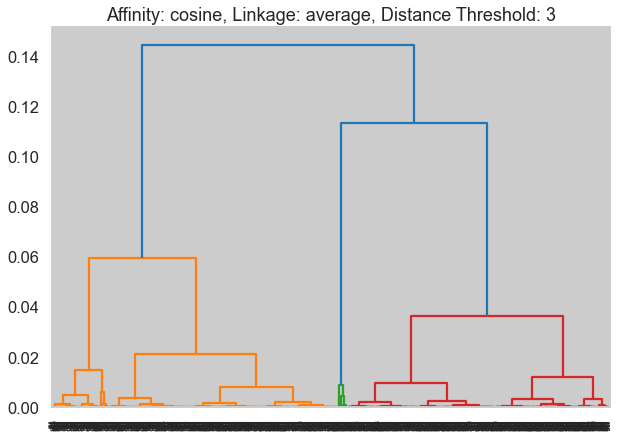

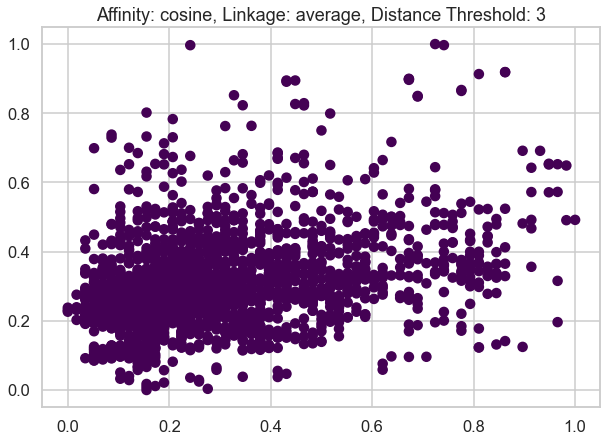

Affinity: cosine, Linkage: single, Distance Threshold: None, Silhouette Score: -0.09


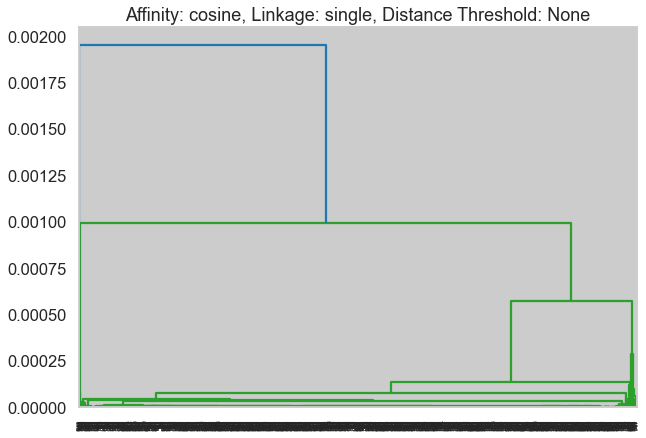

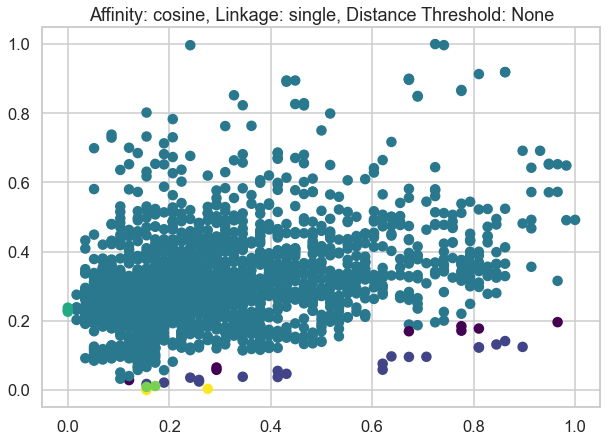

Affinity: cosine, Linkage: single, Distance Threshold: 1, Silhouette Score cannot be computed with only one label.


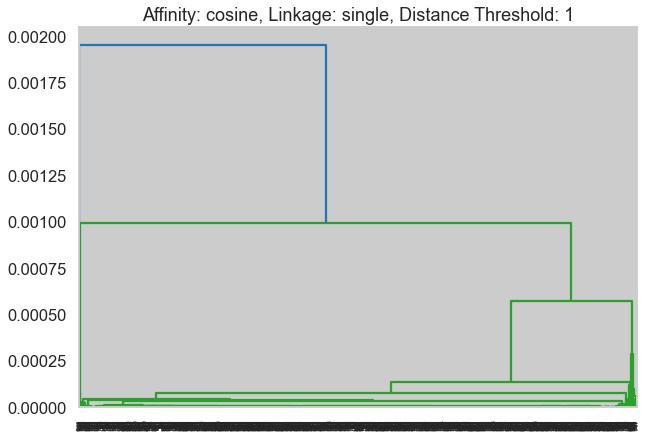

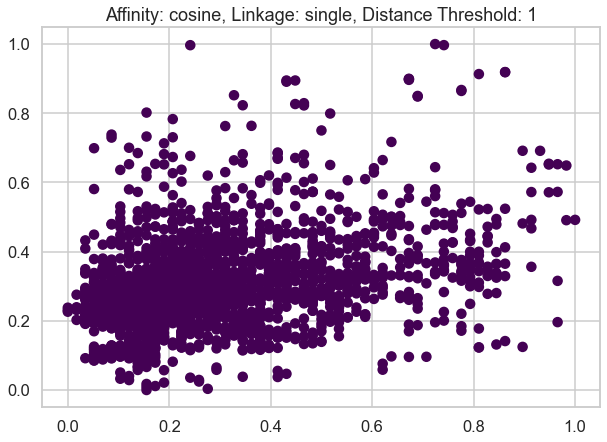

Affinity: cosine, Linkage: single, Distance Threshold: 2, Silhouette Score cannot be computed with only one label.


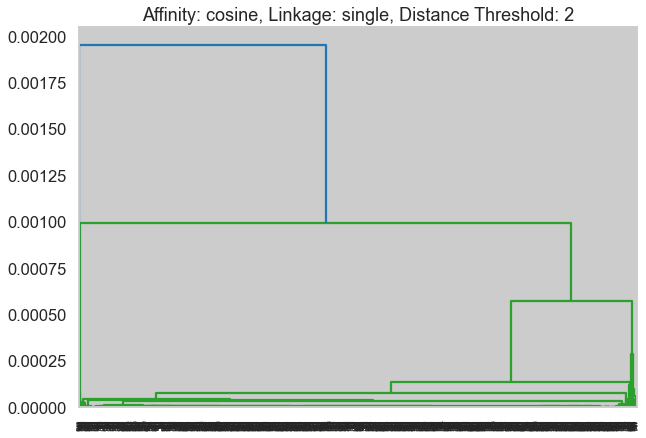

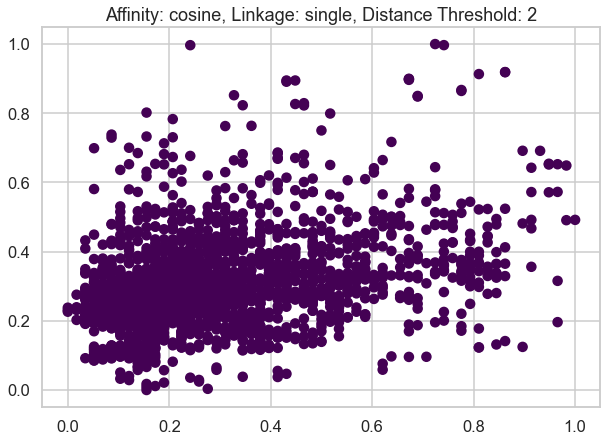

Affinity: cosine, Linkage: single, Distance Threshold: 3, Silhouette Score cannot be computed with only one label.


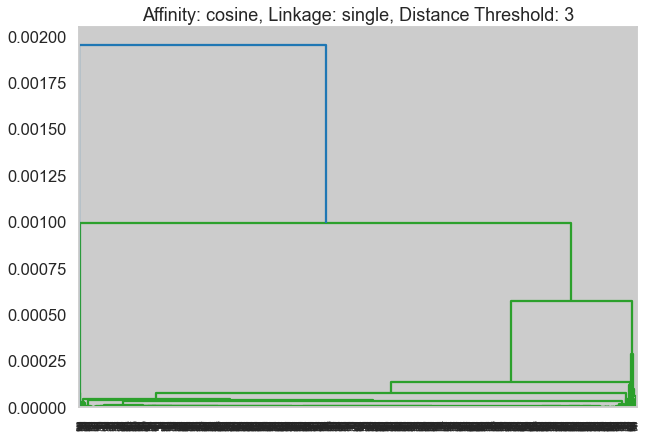

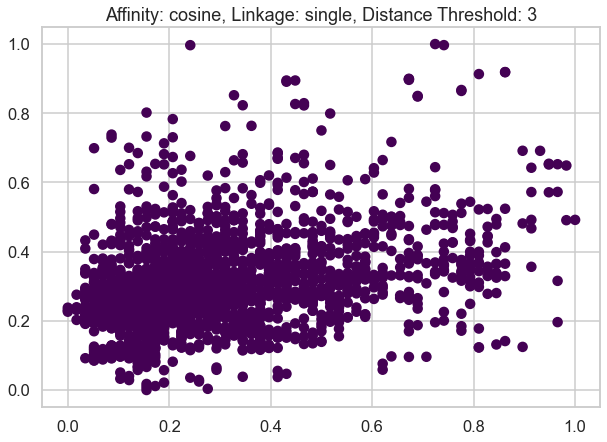

Best Silhouette Score: 0.47
Best Affinity: euclidean
Best Linkage: single
Best Distance Threshold: None


In [33]:
agglomerative_clustering(normalized_customer, affinities, linkages, dist_thresholds)

Best Silhouette Score: 0.61, eps=0.20, min_samples=20


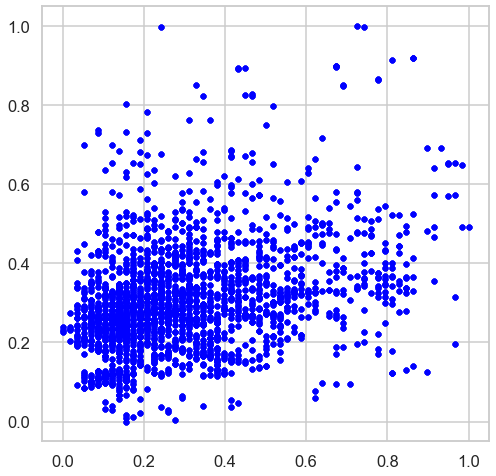

In [35]:
dbscan_clustering(normalized_customer)

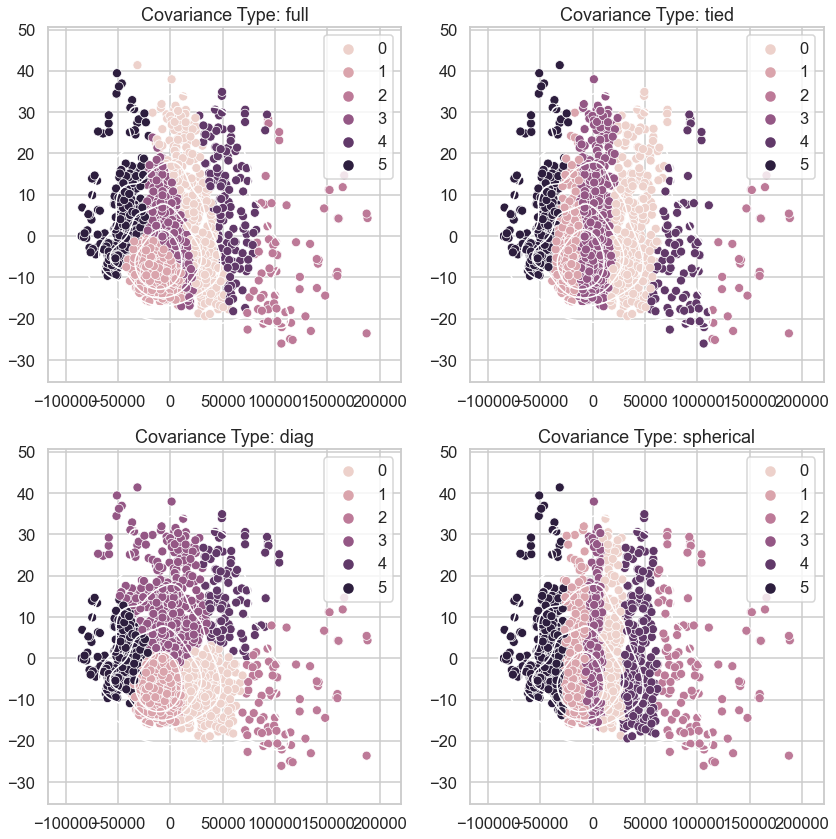

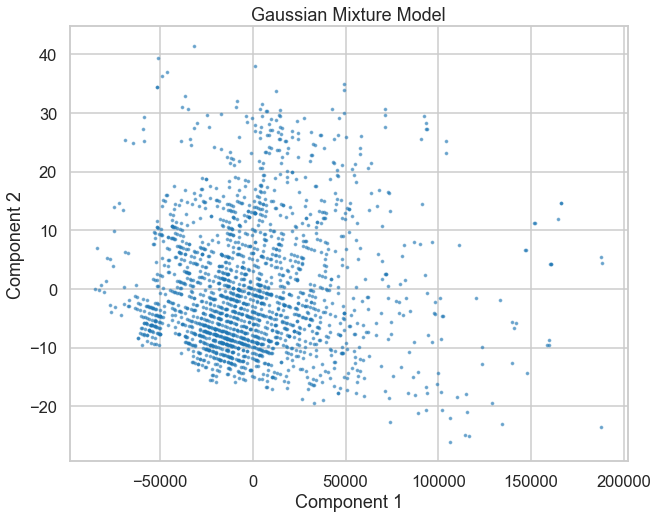

In [36]:
plot_gmm_clusters(customer, n_clusters=6, covariance_types=('full', 'tied', 'diag', 'spherical'), random_state=42)

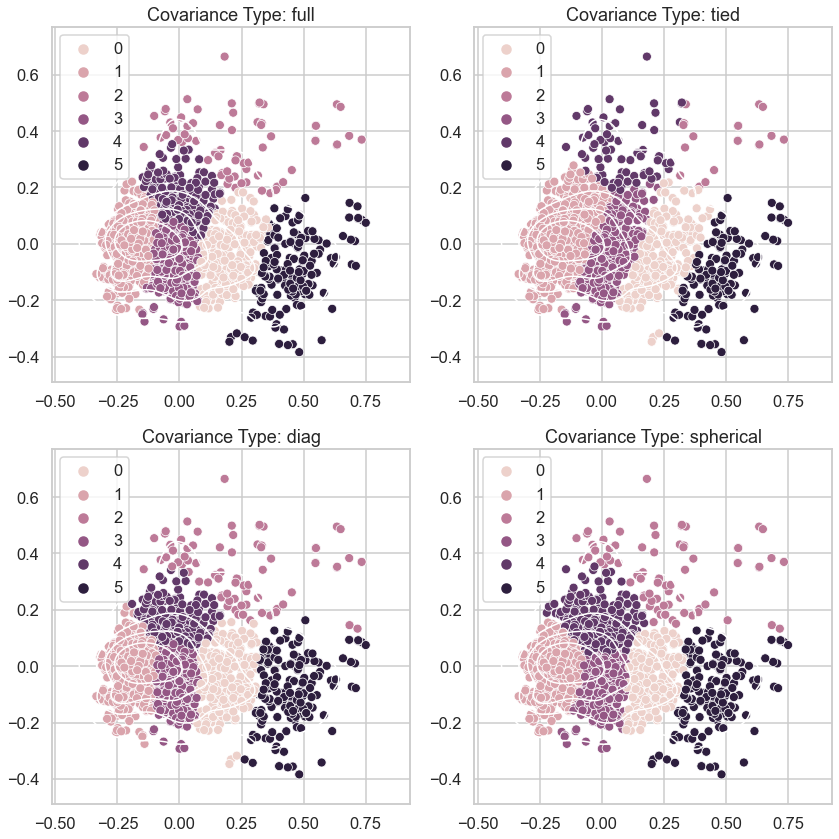

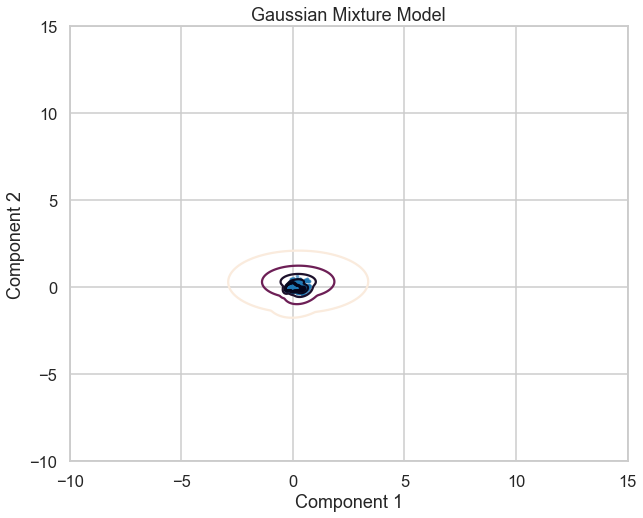

In [37]:
plot_gmm_clusters(normalized_customer, n_clusters=6, covariance_types=('full', 'tied', 'diag', 'spherical'), random_state=42)